<a href="https://colab.research.google.com/github/Nishant-codex/single_cell_analysis/blob/main/notebooks/Single_cell_analysis_Dop.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#@title
import os
import pickle

import matplotlib 
import numpy as np 
import matplotlib.pyplot as plt
from numpy.lib.function_base import append 
import scipy.io as spio
from scipy.io import loadmat, savemat
import importlib.util
from sklearn import datasets, linear_model
import matplotlib.pyplot as plt
from scipy.sparse import data 
from plotnine import ggplot, geom_point, aes, stat_smooth, facet_wrap
from plotnine.data import mtcars
import pandas as pd 
import matplotlib as mpl 
import seaborn as sns 
import matplotlib.pyplot as plt
import sys
import pandas as pd


In [ ]:
#@title load files
def loadmat_(filename):
    '''
    this function should be called instead of direct spio.loadmat
    as it cures the problem of not properly recovering python dictionaries
    from mat files. It calls the function check keys to cure all entries
    which are still mat-objects
    '''
#     try:
    if ('analyzed' in filename )and ('_CC_' not in filename):
        Data = []
        data = spio.loadmat(filename, struct_as_record=False, squeeze_me=True)['Data']
        try:
            for i in range(len(data)):
                data_ = data[i]
                data_ = _todict(data_) 
                Data.append(_check_keys(data_))
            return Data
        except:
            data_ = data
            data_ = _todict(data_) 
            Data.append(_check_keys(data_))
            return Data
    elif ('analyzed' in filename) and ('_CC_' in filename):
        data = spio.loadmat(filename, struct_as_record=False, squeeze_me=True)
        data = _todict(data)          
    else:
        data = spio.loadmat(filename, struct_as_record=False, squeeze_me=True)['Data']
        data = _todict(data) 
    return _check_keys(data)

#     except:
#         print('here')
#         pass
def _check_keys(dict):
    '''
    checks if entries in dictionary are mat-objects. If yes
    todict is called to change them to nested dictionaries
    '''
    for key in dict:
        if isinstance(dict[key], spio.matlab.mio5_params.mat_struct):
            dict[key] = _todict(dict[key])
    return dict        

def _todict(matobj):
    '''
    A recursive function which constructs nested dictionaries from matobjects
    '''
    dict = {}
    try:
      for strg in matobj._fieldnames:
          elem = matobj.__dict__[strg]
          if isinstance(elem, spio.matlab.mio5_params.mat_struct):
              dict[strg] = _todict(elem)
          elif strg =='Analysis':
              temp = []
              for i in elem:

                  temp.append(_todict(i))
              dict['Analysis'] = temp
          else:
              
              dict[strg] = elem
    except:
        for strg in matobj.keys():
          elem = matobj[strg]
          if isinstance(elem, spio.matlab.mio5_params.mat_struct):
              dict[strg] = _todict(elem)
          elif strg =='Analysis':
              temp = []
              for i in elem:

                  temp.append(_todict(i))
              dict['Analysis'] = temp
          else:
              
              dict[strg] = elem
    return dict

In [ ]:
#@title threshold variablility 

def plot_threshold_variablity_analysed(foldername):
    acsf_list_analyzed = []
    folder_list =  ['Copy of NC_171010_aCSF_D1ago_E1_analyzed.mat',
                     'Copy of NC_171010_aCSF_D1ago_E3_analyzed.mat',
                     'Copy of NC_171010_aCSF_D1ago_E4_analyzed.mat',
                     'Copy of NC_171110_aCSF_D1ago_E1_analyzed.mat',
                     'Copy of NC_171110_aCSF_D1ago_E2_analyzed.mat',
                     'Copy of NC_171110_aCSF_D1ago_E3_analyzed.mat',
                     'Copy of NC_171207_aCSF_E1_analyzed.mat',
                     'Copy of NC_171207_aCSF_E3_analyzed.mat',
                     'Copy of NC_171207_aCSF_E4_analyzed.mat', 
                     'Copy of NC_171207_aCSF_E5_analyzed.mat',
                     'Copy of NC_171207_aCSF_E6_analyzed.mat', 
                     'Copy of NC_171211_aCSF_E2_analyzed.mat',
                     'Copy of NC_171222_aCSF_D1ago_E2_analyzed.mat', 
                     'Copy of NC_171222_aCSF_D1ago_E3_analyzed.mat']
    #pickle.load(open('C:/Users/Nishant Joshi/Downloads/Old_code/code/acsf.pkl','rb'))    

    for i in range(len(folder_list)):
#         if folder_list[i] == 'Copy of NC_171207_aCSF_E6_analyzed.mat':
            data = loadmat_(foldername+folder_list[i])
            print(folder_list[i])
            acsf_count =0 
            for l in data:
                if l['input_generation_settings']['condition'].lower() == 'acsf':
                    acsf_count+=1
            count = 0
            print('acsf_count ',acsf_count)
            # try:
            let_it_rain = False
            thresholds = []
            isis  = []
            threshold_diffs = []
            updated_list = []
            threshold_diff_w_isis = []
            for m in data:
                    if m['input_generation_settings']['condition'].lower() =='acsf'  :
                            regr = linear_model.LinearRegression()

                            print('trial ',(m['input_generation_settings']['trialnr']))
                            count+=1
                            let_it_rain = True
                            print('EXP ',i)
                            print(folder_list[i])
                            print((count,acsf_count))
                            
                            if 'cell_type' in m['input_generation_settings'].keys():
                                cell_type = m['input_generation_settings']['cell_type']
                                print(cell_type)
                            experimentname =  m['input_generation_settings']['experimentname']
                            updated_list.append(folder_list[i])
                            membrane_potential = m['membrane_potential']
                            spikes = m['spikeindices'] 
                            threshold_i = m['thresholds']
                            idx = [~np.isnan(threshold_i)]
                            threshold_i = threshold_i[idx]
                            threshold_i_diff = np.diff(threshold_i)
                            threshold_indices_i = np.array(m['thresholdindices'][idx],dtype=np.int32)
                            spikes = spikes[idx]
                            isi = np.diff(spikes)
                            threshold_diff_w_isi = threshold_i_diff/isi
                            threshold_diff_w_isis.append(threshold_diff_w_isi)
                            thresholds.append(threshold_i)
                            threshold_diffs.append(threshold_i_diff)
                            isis.append(np.log(isi))
            
                            ###################### membrane potential ##########################

                            plt.figure(1, figsize = [15,10])
                            ax0_1 = plt.subplot(acsf_count, 1, 1)
                            ax0_2 = plt.subplot(acsf_count,1,2)
                            if acsf_count == 3:
                                ax0_3 = plt.subplot(acsf_count,1,3)
                            if acsf_count == 4:
                                ax0_3 = plt.subplot(acsf_count,1,3)

                                ax0_4 = plt.subplot(acsf_count,1,4)

                            if count ==1:
                                ax0_1.plot(membrane_potential)
                            if count ==2:
                                ax0_2.plot(membrane_potential)
                            if count == 3:
                                ax0_3.plot(membrane_potential)
                            if count ==4:
                                ax0_4.plot(membrane_potential)
                            plt.xlabel('time (ms)',fontsize=16)
                            plt.ylabel('V (mV)',fontsize=16)
                            if count == acsf_count:
                                plt.title(experimentname+' '+cell_type,fontsize=18)
#                             if count == acsf_count:
#                                 if cell_type in ['fast_spiking','Fast Spiking']:
#                                     plt.savefig('C:/Users/Nishant Joshi/Downloads/Old_code/figures/inh/'+experimentname+'_membrane_potential')
#                                 else:
#                                     plt.savefig('C:/Users/Nishant Joshi/Downloads/Old_code/figures/exc/'+experimentname+'_membrane_potential')
#                                 plt.show()
                                
                           ###################### membrane potential ##########################

                            plt.figure(2, figsize = [20,15])
                            ax0_1 = plt.subplot(acsf_count, 1, 1)
                            ax0_2 = plt.subplot(acsf_count,1,2)
                            if acsf_count == 3:
                                ax0_3 = plt.subplot(acsf_count,1,3)
                            if acsf_count == 4:
                                ax0_3 = plt.subplot(acsf_count,1,3)

                                ax0_4 = plt.subplot(acsf_count,1,4)

                            if count ==1:
                                ax0_1.plot(m['input_current'])
                            if count ==2:
                                ax0_2.plot(m['input_current'])
                            if count ==3:
                                ax0_3.plot(m['input_current'])
                            if count ==4:
                                ax0_4.plot(m['input_current'])
                            plt.xlabel('time (ms)',fontsize=16)
#                             plt.ylabel('V (mV)')
                            if count == acsf_count:
                                plt.title(experimentname+' '+cell_type,fontsize=18)
#                                 plt.show()
                                
#                           ###################### Threshold v ISI ##########################

                            plt.figure(3, figsize = [20,15])


                            plt.xlabel('thresholds (mV)',fontsize=16)
                            plt.ylabel('ISI log(ms)',fontsize=16)

#                             if count == 1:
#                                 legend = ['fit1','trial1','CI1'] #,'fit1', 'fit2',]
                            if acsf_count == 2:
                                legend = ['fit1','fit2','trial1','CI1','trial2','CI2'] #,'fit1', 'fit2',]
                            elif acsf_count == 3:
                                legend = ['fit1','fit2','fit3','trial1','CI1','trial2','CI2','trial3','CI3'] #,'fit1', 'fit2','fit3',]
                            elif acsf_count == 4:
                                legend = ['fit1','fit2','fit3','fit4','trial1','CI1','trial2','CI2','trial3','CI3','trial4','CI4'] #,'fit1', 'fit2','fit3',]
                                
#                             if acsf_count  == count:
                            sns.regplot(threshold_i[1:],np.log(isi), scatter_kws={'alpha':0.2},line_kws = {'linewidth':0.5})
#                             plt.plot(Xtest, regr.predict(Xtest),linewidth=3)

                            if count == acsf_count:
                                print('here')
                                plt.legend(legend,fontsize=12)

                                plt.title(experimentname+' '+cell_type,fontsize=18)
#                                 if cell_type in ['fast_spiking','Fast Spiking']:
#                                     plt.savefig('C:/Users/Nishant Joshi/Downloads/Old_code/figures/inh/'+experimentname+'_Vth_v_ISI')
#                                 else:
#                                     plt.savefig('C:/Users/Nishant Joshi/Downloads/Old_code/figures/exc/'+experimentname+'_Vth_v_ISI')

#                             if count ==acsf_count:
#                                 plt.show()
        #                             plt.savefig(os.getcwd()+'threshold')
                            
                            ###################### Threshold v Change in Threshold##########################
                
                            plt.figure(4,figsize =[20,15])
                            sns.regplot(threshold_i[1:],threshold_i_diff,marker='x',scatter_kws={'alpha':0.2},line_kws = {'linewidth':0.5})
                            plt.scatter(np.nansum(threshold_i[1:])/np.size(threshold_i[1:]),np.nansum(threshold_i_diff)/np.size(threshold_i_diff),marker='D',s=30,alpha=1.,c=np.random.choice(['purple','cyan','red']))
                            if acsf_count == 2:
                                legend = ['fit1','fit2','trial1','CI1','centroid1','trial2','CI2','centroid2'] #,'fit1', 'fit2',]
                            elif acsf_count == 3:
                                legend = ['fit1','fit2','fit3','trial1','CI1','centroid1','trial2','CI2','centroid2','trial3','CI3','centroid3'] #,'fit1', 'fit2','fit3',]
                            elif acsf_count == 4:
                                legend = ['fit1','fit2','fit3','fit4','trial1','CI1','centroid1','trial2','CI2','centroid2','trial3','CI3','centroid3','trial4','CI4','centroid4'] #,'fit1', 'fit2','fit3',]
                                
                            if acsf_count == count:
                                plt.legend(legend,fontsize=12)
                                plt.title(experimentname+' '+cell_type,fontsize=18)

                                #, 'trial3'])
                            
                                plt.xlabel('thresholds (mV)',fontsize=16)
                                plt.ylabel('dth/dt(mV)(ms)',fontsize=16)
#                             if cell_type in ['fast_spiking','Fast Spiking']:
#                                 plt.savefig('C:/Users/Nishant Joshi/Downloads/Old_code/figures/inh/'+experimentname+'_Vth_v_dVth')
#                             else:
#                                 plt.savefig('C:/Users/Nishant Joshi/Downloads/Old_code/figures/exc/'+experimentname+'_Vth_v_dVth')                            
#                                 plt.show()
                            # exit()
                            
                            ########################### Dynamics ##########################################
            
                            plt.figure(5, figsize = [15,10])
                            ax1 = plt.subplot(411)
                            ax2 = plt.subplot(412)
                            if count == 3:
                                ax3 = plt.subplot(413)
                            if count == 4:
                                ax4 = plt.subplot(414)

                            # for m in range(len(membrane_potential)):
                            idx = spikes #spikes_struct['spikeindices']
                            idx_count = 0
                            for  n in range(len(idx)):
                                mpotential_w_spikes = membrane_potential[idx[n]-100:idx[n]+100]
                                mpotential_w_spikes_diff = np.diff(mpotential_w_spikes)
                                if count ==1:
                                    ax1.plot(mpotential_w_spikes[1:],mpotential_w_spikes_diff,linewidth= 0.5)
                                    
                                    ax1.set_xlabel('V(mV)',fontsize=14)
                                    ax1.set_xlim(-110,90)
#                                     ax1.set_ylim(-110,90)
                                    ax1.set_ylabel('dv/dt(mV/ms)',fontsize=14)
                                    # ax1.legend(np.arange(10))
                                elif count ==2:
                                    ax2.plot(mpotential_w_spikes[1:],mpotential_w_spikes_diff,linewidth= 0.5)
                                    ax2.set_xlabel('V(mV)',fontsize=14)
                                    ax2.set_ylabel('dv/dt(mV/ms)',fontsize=14)
                                    ax2.set_xlim(-110,90)
#                                     ax2.set_ylim(-110,90)

                                    # ax2.legend(np.arange(10))

                                elif count == 3 :
                                    ax3.plot(mpotential_w_spikes[1:],mpotential_w_spikes_diff,linewidth= 0.5)
                                    ax3.set_xlabel('V(mV)',fontsize=14)
                                    ax3.set_ylabel('dv/dt(mV/ms)',fontsize=14)
                                    ax3.set_xlim(-110,90)
#                                     ax3.set_ylim(-110,90)

                                    #     ax3.legend(np.arange(10))

                                elif count == 4 :
                                    ax4.plot(mpotential_w_spikes[1:],mpotential_w_spikes_diff,linewidth= 0.5)
                                    ax4.set_xlabel('V(mV)',fontsize=14)
                                    ax4.set_ylabel('dv/dt(mV/ms)',fontsize=14)
                                    ax4.set_xlim(-110,90)
#                                     ax4.y_range(-110,90)
                                    
                            if count ==acsf_count:
                                plt.title(experimentname+' '+cell_type,fontsize=18)
#                                 if cell_type in ['fast_spiking','Fast Spiking']:
#                                     plt.savefig('C:/Users/Nishant Joshi/Downloads/Old_code/figures/inh/'+experimentname+'_Dynamics')
#                                 else:
#                                     plt.savefig('C:/Users/Nishant Joshi/Downloads/Old_code/figures/exc/'+experimentname+'_Dynamics')

                            if count ==acsf_count:
                                print('count ',count)

#                                 plt.show()
        #                             plt.savefig(os.getcwd()+'dynamics')
                            # temp = thresholds[~np.isnan(np.array(thresholds))]
                            
                            ############################### ISI Box####################################
                            if count == acsf_count:
                                plt.figure(6, figsize = [10,8])
                                plt.boxplot((np.array(isis).T))
                                plt.xlabel('trials',fontsize=16)
                                plt.ylabel('ISI (log)',fontsize=16)
                                plt.title(experimentname+' '+cell_type)
#                                 if cell_type in ['fast_spiking','Fast Spiking']:
#                                     plt.savefig('C:/Users/Nishant Joshi/Downloads/Old_code/figures/inh/'+experimentname+'ISI_box')
#                                 else:
#                                     plt.savefig('C:/Users/Nishant Joshi/Downloads/Old_code/figures/exc/'+experimentname+'ISI_box')
#                                 plt.show()
    
                            ############################### dVth Box####################################

                            # # temp = thresholds[~np.isnan(np.array(thresholds))]
                            if count == acsf_count:
                                plt.figure(7, figsize =[10,8])
                                plt.boxplot((np.array(threshold_diffs).T))
                                plt.xlabel('trials',fontsize=16)
                                plt.ylabel('dVth',fontsize=16)
                                plt.title(experimentname+' '+cell_type,fontsize=18)
#                                 if cell_type in ['fast_spiking','Fast Spiking']:
#                                     plt.savefig('C:/Users/Nishant Joshi/Downloads/Old_code/figures/inh/'+experimentname+'_dVth box')
#                                 else:
#                                     plt.savefig('C:/Users/Nishant Joshi/Downloads/Old_code/figures/exc/'+experimentname+'_dVth box')
                                
#                                 plt.show()
#                                 plt.savefig(os.getcwd()+'threshold_diff_box')

                            ############################### Vth Box####################################

                            if count == acsf_count:
                                plt.figure(8, figsize = [10,8])                        
                                plt.boxplot((np.array(thresholds).T))
                                plt.xlabel('trials',fontsize=16)
                                plt.ylabel('Vth',fontsize=16)
                                plt.title(experimentname+' '+cell_type,fontsize=18)
#                                 plt.savefig(os.getcwd()+'Vth_box')
#                                 if cell_type in ['fast_spiking','Fast Spiking']:
#                                     plt.savefig('C:/Users/Nishant Joshi/Downloads/Old_code/figures/inh/'+experimentname+'_Vth box')
#                                 else:
#                                     plt.savefig('C:/Users/Nishant Joshi/Downloads/Old_code/figures/exc/'+experimentname+'_Vth box')
#                                 plt.show()
#                             ############################### Vth Box####################################
#                             if acsf_count==count:
#                                 if acsf_count ==2:
#                                     data_dict = {'threshold':{'trail1':thresholds[0][1:],
#                                                              'trail2':thresholds[1][1:]},
#                                                 'threshold_diff':{'trail1':threshold_diff_w_isis[0],
#                                                              'trail2':threshold_diff_w_isis[1]}}
#                                 if acsf_count ==3:
#                                     data_dict = {'threshold':{'trail1':thresholds[0][1:],
#                                                              'trail2':thresholds[1][1:],
#                                                              'trail3':thresholds[2][1:]},
#                                                 'threshold_diff':{'trail1':threshold_diff_w_isis[0],
#                                                              'trail2':threshold_diff_w_isis[1],
#                                                             'trail3':threshold_diff_w_isis[2]}}
#                                 if acsf_count ==4:
#                                     data_dict = {'threshold':{'trail1':thresholds[0][1:],
#                                                              'trail2':thresholds[1][1:],
#                                                              'trail3':thresholds[2][1:],
#                                                              'trail4':thresholds[3][1:]},
#                                                 'threshold_diff':{'trail1':threshold_diff_w_isis[0],
#                                                              'trail2':threshold_diff_w_isis[1],
#                                                              'trail3':threshold_diff_w_isis[2],
#                                                              'trail4':threshold_diff_w_isis[3]}}

#                                 df = pd.DataFrame(data_dict)
#                                 sns.jointplot(x='threshold',y='threshold_diff',data=df,
# #                                                   kind="reg", truncate=False,#hue=['trail1','trail2','trial3'],
# #                                                   xlim=(0, 60), ylim=(0, 12),
#                                                   color="m", height=7)
        
                            if count == acsf_count:
                                plt.show()        
 

In [ ]:
data = loadmat_('C:/Users/Nishant Joshi/Google Drive/Analyzed/'+'asli_1-18-7-19_E1_analyzed.mat')
# for i in data:
#   print(i['classification'])


In [ ]:
data[2]['input_generation_settings']['condition']

'M1-ant'

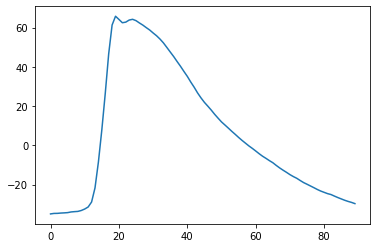

In [ ]:
spikes = data[0]['spikeindices']
plt.plot(data[0]['membrane_potential'][spikes[0]-20:spikes[0]+70])

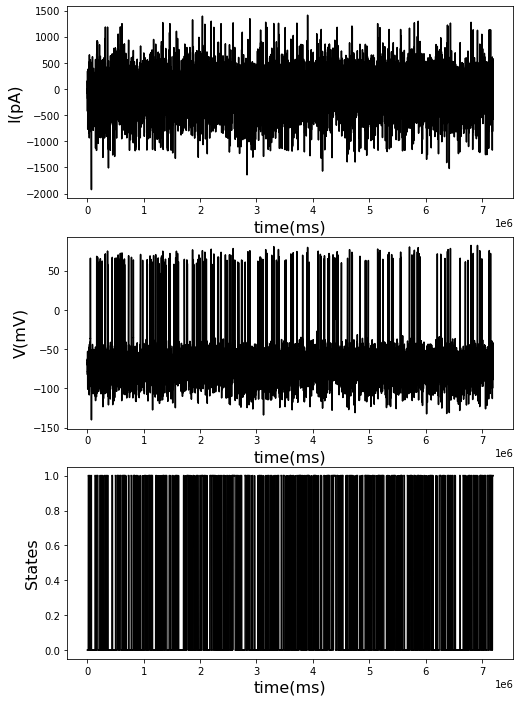

In [ ]:
fig,ax = plt.subplots(3,1,figsize=[8,12])

ax[1].plot(data[0]['membrane_potential'],c='black')
ax[1].set_xlabel('time(ms)',fontsize=16)
ax[1].set_ylabel('V(mV)',fontsize=16)
ax[0].plot(data[0]['input_current'],c='black')
ax[0].set_xlabel('time(ms)',fontsize=16)
ax[0].set_ylabel('I(pA)',fontsize=16)
ax[2].plot(data[0]['hidden_state'],c='black')
ax[2].set_xlabel('time(ms)',fontsize=16)
ax[2].set_ylabel('States',fontsize=16)
fig.tight_layout=True

# Figures for all 14 cells analyzed (11 Inhibitory and 3 excitatory)

In [ ]:
pip install decorator==5.0.9

Note: you may need to restart the kernel to use updated packages.


'C:\Users\Nishant' is not recognized as an internal or external command,
operable program or batch file.


In [ ]:
from matplotlib import pyplot as plt
import networkx as nx
g1 = nx.DiGraph()
g1.add_edges_from([("root", "a"), ("a", "b"), ("a", "e"), ("b", "c"), ("b", "d"), ("d", "e")])
plt.tight_layout()
nx.draw_networkx(g1, arrows=True)
plt.savefig("g1.png", format="PNG")
# tell matplotlib you're done with the plot: https://stackoverflow.com/questions/741877/how-do-i-tell-matplotlib-that-i-am-done-with-a-plot
plt.clf()

NetworkXError: ignored

<Figure size 432x288 with 0 Axes>

In [ ]:
v = np.random.randn(100)
dv =np.diff(v)

In [ ]:
plot_threshold_variablity_analysed('C:/Users/Nishant Joshi/Google Drive/Analyzed/')

In [ ]:
#@title
data = loadmat_('C:/Users/Nishant Joshi/Google Drive/Analyzed/Copy of NC_171207_aCSF_E1_analyzed.mat')
for i in data:
    print(i['input_generation_settings'])

{'condition': 'aCSF', 'experimenter': 'NC', 'baseline': -70, 'amplitude_scaling': 700, 'tau': 50, 'mean_firing_rate': 0.0005, 'sampling_rate': 20, 'duration': 360000, 'FLAG_convert_to_amphere': 1, 'cell_type': 'Fast Spiking', 'experimentname': 'NC_171207_aCSF_E1', 'experimentername': 'NC', 'experimentnr': 1, 'trialnr': 1}
{'condition': 'aCSF', 'experimenter': 'NC', 'baseline': -80, 'amplitude_scaling': 2100, 'tau': 250, 'mean_firing_rate': 0.0001, 'sampling_rate': 20, 'duration': 360000, 'FLAG_convert_to_amphere': 1, 'cell_type': 'Fast Spiking', 'experimentname': 'NC_171207_aCSF_E1', 'experimentername': 'NC', 'experimentnr': 1, 'trialnr': 2, 'baseline_normalized': -0.14285714285714285}
{'condition': 'aCSF', 'experimenter': 'NC', 'baseline': -80, 'amplitude_scaling': 2100, 'tau': 250, 'mean_firing_rate': 0.0001, 'sampling_rate': 20, 'duration': 360000, 'FLAG_convert_to_amphere': 1, 'cell_type': 'Fast Spiking', 'experimentname': 'NC_171207_aCSF_E1', 'experimentername': 'NC', 'experimentn

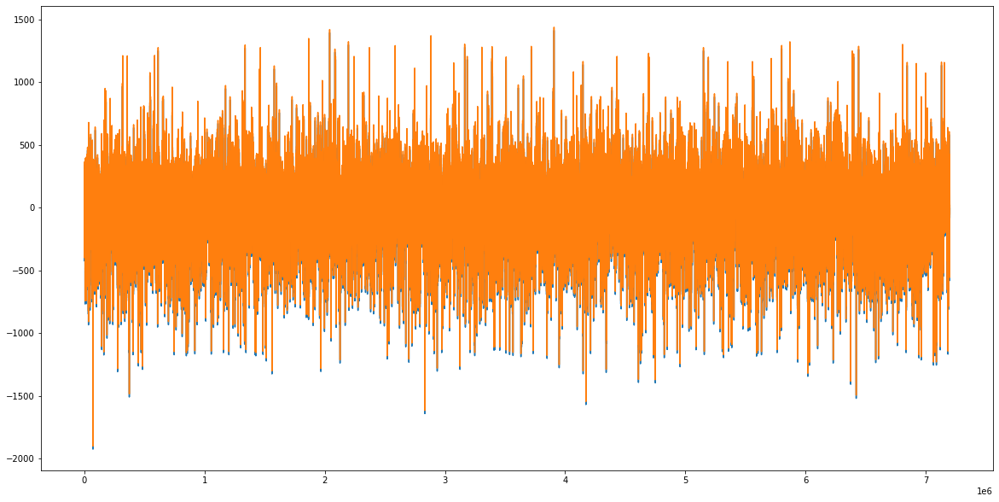

In [ ]:
#@title
plt.figure(1,figsize=[20,10])
# ax1 = plt.subplot(211)
# ax2 = plt.subplot(212)
plt.plot(data[0]['input_current'])
plt.plot(data[1]['input_current'])
plt.show()

<ipython-input-9-707cf7226068>:14: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
<ipython-input-9-707cf7226068>:15: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


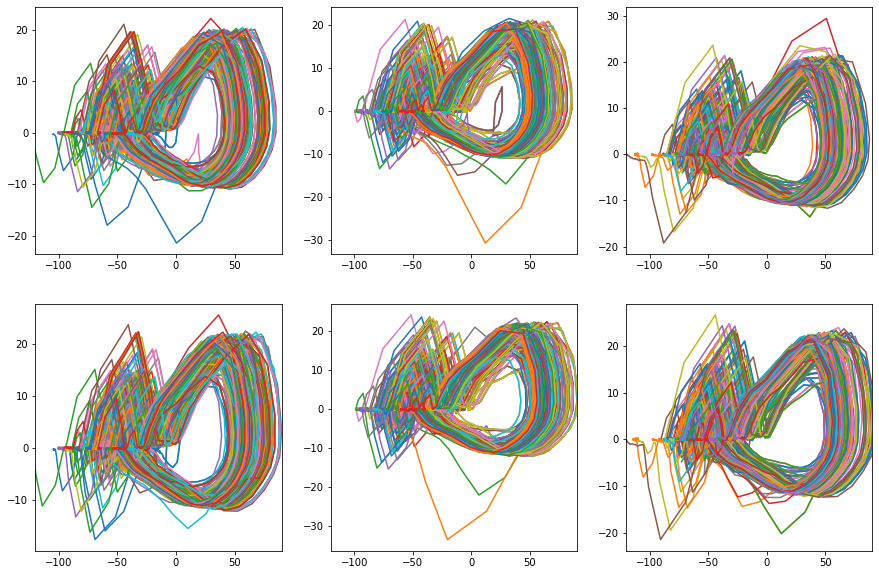

In [ ]:
#@title
plt.figure(2, figsize = [15,10])
ax1_1 = plt.subplot(231)
ax1_2 = plt.subplot(232)
ax1_3 = plt.subplot(233)
ax2_1 = plt.subplot(234)
ax2_2 = plt.subplot(235)
ax2_3 = plt.subplot(236)
idx_1 = [~np.isnan(data[1]['spikeindices'])]
idx_2 = [~np.isnan(data[2]['spikeindices'])]

m_potential_1 = data[1]['membrane_potential']
m_potential_2 = data[2]['membrane_potential']

spikes1 = data[1]['spikeindices'][idx_1]
spikes2 = data[2]['spikeindices'][idx_2]

spike1_1 = spikes1[:len(spikes1)//3]
spike2_1 = spikes1[len(spikes1)//3:2*len(spikes1)//3]
spike3_1 = spikes1[2*len(spikes1)//3:]

spike1_2 = spikes2[:len(spikes2)//3]
spike2_2 = spikes2[len(spikes2)//3:2*len(spikes2)//3]
spike3_2 = spikes2[2*len(spikes2)//3:]




for i in spike1_1:
    ax1_1.plot(m_potential_1[i-199:i+200],np.diff(m_potential_1[i-200:i+200]))
    ax1_1.set_xlim([-120,90])

for j in spike2_1:
    ax1_2.plot(m_potential_1[j-199:j+200],np.diff(m_potential_1[j-200:j+200]))
    ax1_2.set_xlim([-120,90])

for k in spike3_1:
    ax1_3.plot(m_potential_1[k-199:k+200],np.diff(m_potential_1[k-200:k+200]))
    ax1_3.set_xlim([-120,90])


for l in spike1_1:
    ax2_1.plot(m_potential_2[l-199:l+200],np.diff(m_potential_2[l-200:l+200]))
    ax2_1.set_xlim([-120,90])

for m in spike2_1:
    ax2_2.plot(m_potential_2[m-199:m+200],np.diff(m_potential_2[m-200:m+200]))
    ax2_2.set_xlim([-120,90])

for n in spike3_1:
    ax2_3.plot(m_potential_2[n-199:n+200],np.diff(m_potential_2[n-200:n+200]))
    ax2_3.set_xlim([-120,90])
plt.show()


<ipython-input-10-e926d8b93bee>:9: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


793
793


<ipython-input-10-e926d8b93bee>:36: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


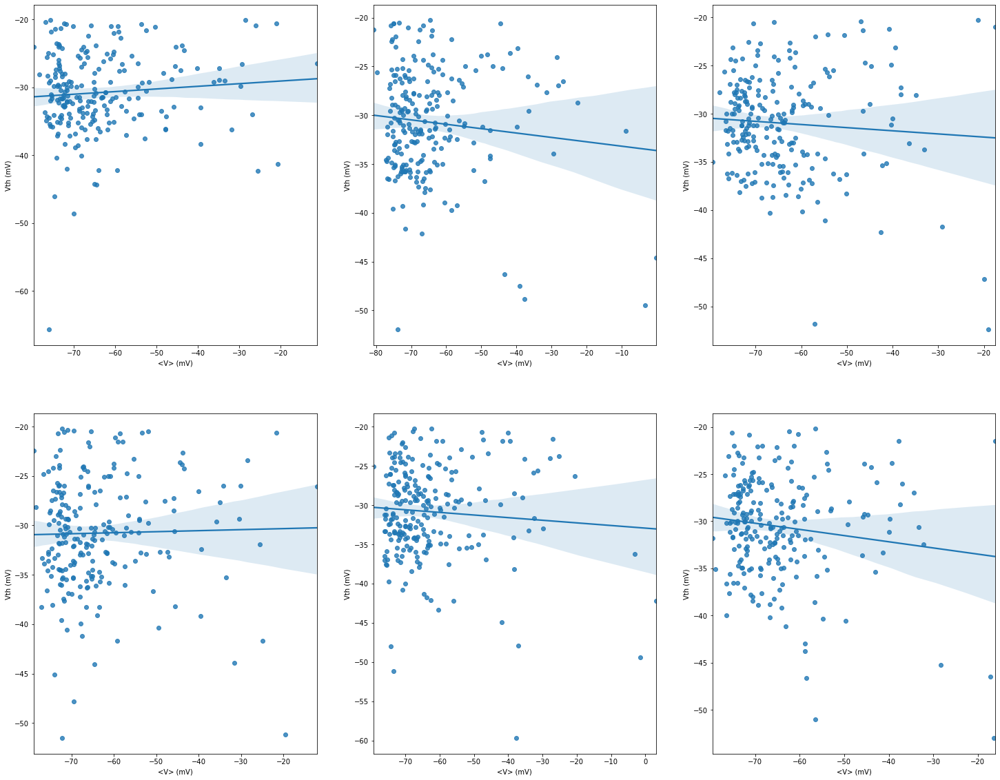

In [ ]:
#@title
plt.figure(2, figsize = [25,20])
ax1_1 = plt.subplot(231)
ax1_2 = plt.subplot(232)
ax1_3 = plt.subplot(233)
ax2_1 = plt.subplot(234)
ax2_2 = plt.subplot(235)
ax2_3 = plt.subplot(236)
threshold1 = data[1]['thresholds'][idx_1]
print(len(threshold1))
print(len(spikes1))

v_avg1 = []

for i in range(len(spikes1)-1):
    if i == 0:
        v_avg1.append(np.mean(m_potential_1[:spikes1[i]]))

    else:
        v_avg1.append(np.mean(m_potential_1[spikes1[i]:spikes1[i+1]]))
v_avg1.append(np.mean(m_potential_1[spikes1[-1]:]))
sns.regplot(x=v_avg1[:len(spikes1)//3],y=threshold1[:len(spikes1)//3],ax=ax1_1 )

ax1_1.set_xlabel('<V> (mV)')
ax1_1.set_ylabel('Vth (mV)')

sns.regplot(x=v_avg1[len(spikes1)//3:2*len(spikes1)//3],y=threshold1[len(spikes1)//3:2*len(spikes1)//3],ax=ax1_2 )
ax1_2.set_xlabel('<V> (mV)')
ax1_2.set_ylabel('Vth (mV)')


sns.regplot(x=v_avg1[2*len(spikes1)//3:],y=threshold1[2*len(spikes1)//3:],ax=ax1_3 )
ax1_3.set_xlabel('<V> (mV)')
ax1_3.set_ylabel('Vth (mV)')

threshold2 = data[2]['thresholds'][idx_2]

v_avg2 = []

for i in range(len(spikes2)-1):
    if i == 0:
        v_avg2.append(np.mean(m_potential_2[:spikes2[i]]))

    else:
        v_avg2.append(np.mean(m_potential_2[spikes2[i]:spikes2[i+1]]))
v_avg2.append(np.mean(m_potential_2[spikes2[-1]:]))

sns.regplot(x=v_avg2[:len(spikes2)//3],y=threshold2[:len(spikes2)//3],ax=ax2_1 )
ax2_1.set_xlabel('<V> (mV)')
ax2_1.set_ylabel('Vth (mV)')

sns.regplot(x=v_avg2[len(spikes2)//3:2*len(spikes2)//3],y=threshold2[len(spikes2)//3:2*len(spikes2)//3],ax=ax2_2 )
ax2_2.set_xlabel('<V> (mV)')
ax2_2.set_ylabel('Vth (mV)')

sns.regplot(x=v_avg2[2*len(spikes2)//3:],y=threshold2[2*len(spikes2)//3:],ax=ax2_3 )
ax2_3.set_xlabel('<V> (mV)')
ax2_3.set_ylabel('Vth (mV)')

plt.show()

[-2.81606959e-05 -4.04842648e-04  6.05988228e-03 -7.68759246e-05
  5.24193709e-03 -2.68586206e-04  2.19188354e-03 -2.88632140e-05
 -2.72285762e-04 -1.52124377e-05  4.23326182e-04]


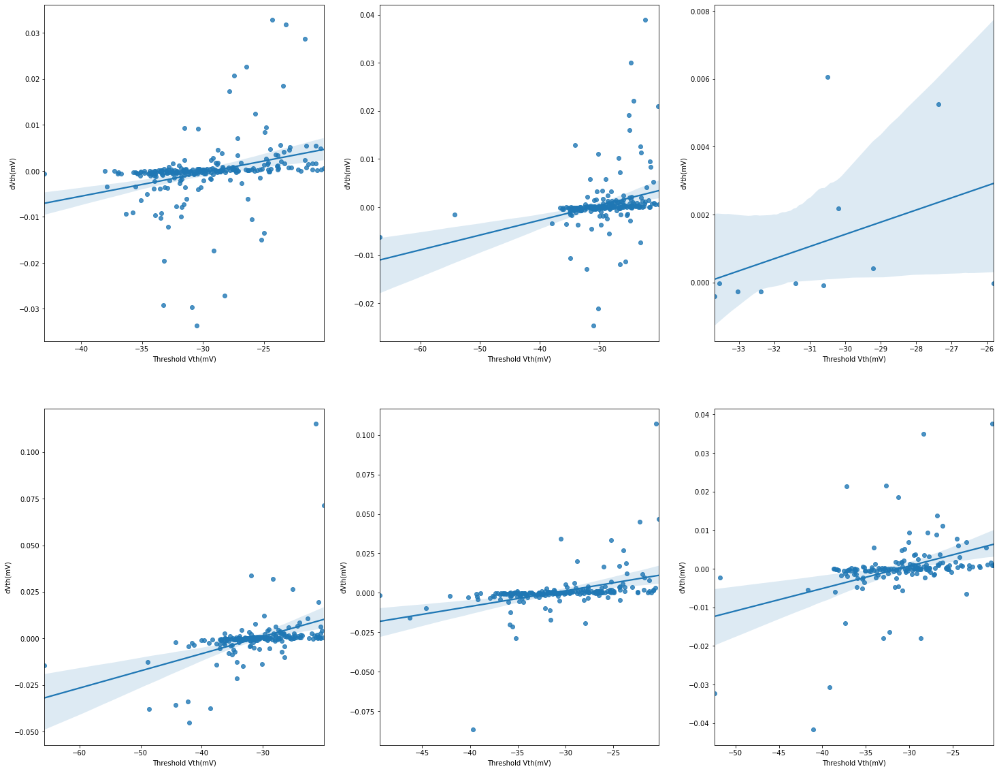

In [ ]:
#@title
plt.figure(3, figsize = [25,20])
ax1_1 = plt.subplot(231)
ax1_2 = plt.subplot(232)
ax1_3 = plt.subplot(233)
ax2_1 = plt.subplot(234)
ax2_2 = plt.subplot(235)
ax2_3 = plt.subplot(236)
threshold1 = data[0]['thresholds']
isi = np.diff(data[0]['spikeindices'])
threshold_diff1 = np.diff(threshold1)/isi
threshold1 = threshold1[1:]
sns.regplot(x=threshold1[:len(spikes1)//3],y=threshold_diff1[:len(spikes1)//3],ax=ax1_1 )
ax1_1.set_xlabel('Threshold Vth(mV)')
ax1_1.set_ylabel('dVth(mV)')

sns.regplot(x=threshold1[len(spikes1)//3:2*len(spikes1)//3],y=threshold_diff1[len(spikes1)//3:2*len(spikes1)//3],ax=ax1_2 )
ax1_2.set_xlabel('Threshold Vth(mV)')
ax1_2.set_ylabel('dVth(mV)')
print(threshold_diff1[2*len(spikes1)//3:])
sns.regplot(x=threshold1[2*len(spikes1)//3:],y=threshold_diff1[2*len(spikes1)//3:],ax=ax1_3 )
ax1_3.set_xlabel('Threshold Vth(mV)')
ax1_3.set_ylabel('dVth(mV)')

threshold2 = data[1]['thresholds']
isi_2 = np.diff(data[1]['spikeindices'])
threshold_diff2 = np.diff(threshold2)/isi_2
threshold2 = threshold2[1:]
sns.regplot(x=threshold2[:len(spikes2)//3],y=threshold_diff2[:len(spikes2)//3],ax=ax2_1 )
ax2_1.set_xlabel('Threshold Vth(mV)')
ax2_1.set_ylabel('dVth(mV)')

sns.regplot(x=threshold2[len(spikes2)//3:2*len(spikes2)//3],y=threshold_diff2[len(spikes2)//3:2*len(spikes2)//3],ax=ax2_2 )
ax2_2.set_xlabel('Threshold Vth(mV)')
ax2_2.set_ylabel('dVth(mV)')

sns.regplot(x=threshold2[2*len(spikes2)//3:],y=threshold_diff2[2*len(spikes2)//3:],ax=ax2_3 )
ax2_3.set_xlabel('Threshold Vth(mV)')
ax2_3.set_ylabel('dVth(mV)')

plt.show()

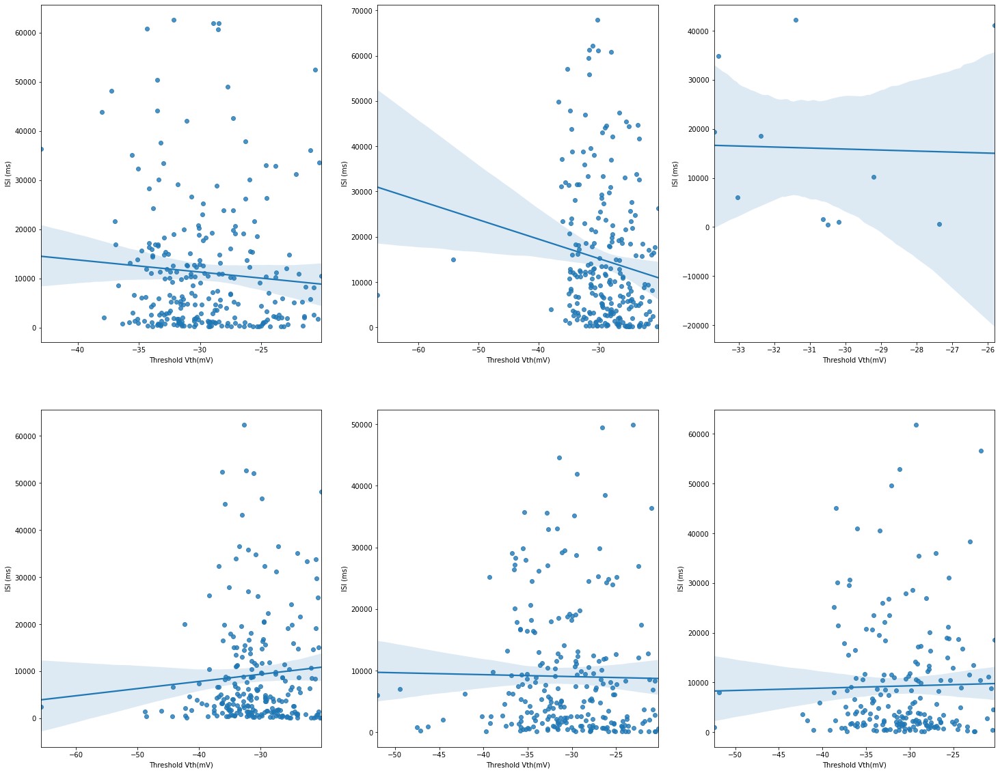

In [ ]:
#@title

plt.figure(3, figsize = [25,20])
ax1_1 = plt.subplot(231)
ax1_2 = plt.subplot(232)
ax1_3 = plt.subplot(233)
ax2_1 = plt.subplot(234)
ax2_2 = plt.subplot(235)
ax2_3 = plt.subplot(236)
threshold1 = data[0]['thresholds']
isi = np.diff(data[0]['spikeindices'])
threshold_diff1 = np.diff(threshold1)/isi
threshold1 = threshold1[1:]
sns.regplot(x=threshold1[:len(spikes1)//3],y=isi[:len(spikes1)//3],ax=ax1_1 )
ax1_1.set_xlabel('Threshold Vth(mV)')
ax1_1.set_ylabel('ISI (ms)')

sns.regplot(x=threshold1[len(spikes1)//3:2*len(spikes1)//3],y=isi[len(spikes1)//3:2*len(spikes1)//3],ax=ax1_2 )
ax1_2.set_xlabel('Threshold Vth(mV)')
ax1_2.set_ylabel('ISI (ms)')

sns.regplot(x=threshold1[2*len(spikes1)//3:],y=isi[2*len(spikes1)//3:],ax=ax1_3 )
ax1_3.set_xlabel('Threshold Vth(mV)')
ax1_3.set_ylabel('ISI (ms)')

threshold2 = data[1]['thresholds']
isi_2 = np.diff(data[1]['spikeindices'])
threshold_diff2 = np.diff(threshold2)/isi_2
threshold2 = threshold2[1:]
sns.regplot(x=threshold2[:len(spikes2)//3],y=isi_2[:len(spikes2)//3],ax=ax2_1 )
ax2_1.set_xlabel('Threshold Vth(mV)')
ax2_1.set_ylabel('ISI (ms)')

sns.regplot(x=threshold2[len(spikes2)//3:2*len(spikes2)//3],y=isi_2[len(spikes2)//3:2*len(spikes2)//3],ax=ax2_2 )
ax2_2.set_xlabel('Threshold Vth(mV)')
ax2_2.set_ylabel('ISI (ms)')

sns.regplot(x=threshold2[2*len(spikes2)//3:],y=isi_2[2*len(spikes2)//3:],ax=ax2_3 )
ax2_3.set_xlabel('Threshold Vth(mV)')
ax2_3.set_ylabel('ISI (ms)')

plt.show()


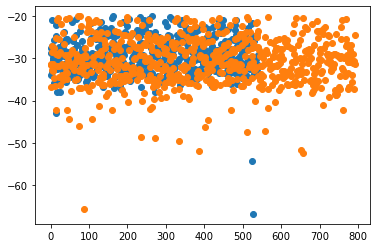

In [ ]:
plt.scatter(np.arange(len(data[0]['thresholds'])),data[0]['thresholds'])

plt.scatter(np.arange(len(data[1]['thresholds'])),data[1]['thresholds'])
plt.show()

In [ ]:
#@title
def analyze_single_cell(filename):
    def divide_list(lis, div):
        meta = [] 
        division = len(lis)//div
        for i in range(div):
            division = len(lis)//div
            if i ==div-1:
                meta.append(lis[i*division:])
            else:
                meta.append(lis[i*division:(i+1)*division])
        return meta
    print(filename)
    data = loadmat_('C:/Users/Nishant Joshi/Google Drive/Analyzed/'+filename)
    temp = []
    for i in  data:
        if i['input_generation_settings']['condition'].lower() =='acsf':
            temp.append(i)
    data = temp
    
    for i in data:
        
        if 'cell_type' in i['input_generation_settings']:
            print((i['input_generation_settings']['cell_type'],i['input_generation_settings']['condition'] ))
            celltype = i['input_generation_settings']['cell_type']
#         except:
#             pass
####################################################
    plt.figure(1, figsize = [15,10])
    plt.title(filename+' '+celltype,fontsize =18)

#     ax_list1 = []
#     for i in range(len(data)):
#         temp = []
#         for k in range(3):
#             ind_ = int(str(len(data))+ '3'+str(i+1))
#             temp.append(plt.subplot(ind_))
    
#         ax_list1.append(temp)
    if len(data) ==2:
        ax1_1 = plt.subplot(231)
        ax1_2 = plt.subplot(232)
        ax1_3 = plt.subplot(233)
        ax2_1 = plt.subplot(234)
        ax2_2 = plt.subplot(235)
        ax2_3 = plt.subplot(236)
    if len(data) ==3:
        ax1_1 = plt.subplot(331)
        ax1_2 = plt.subplot(332)
        ax1_3 = plt.subplot(333)
        ax2_1 = plt.subplot(334)
        ax2_2 = plt.subplot(335)
        ax2_3 = plt.subplot(336)
        ax3_1 = plt.subplot(337)
        ax3_2 = plt.subplot(338)
        ax3_3 = plt.subplot(339)
    if len(data) ==4:
        ax1_1 = plt.subplot(431)
        ax1_2 = plt.subplot(432)
        ax1_3 = plt.subplot(433)
        ax2_1 = plt.subplot(434)
        ax2_2 = plt.subplot(435)
        ax2_3 = plt.subplot(436)
        ax3_1 = plt.subplot(437)
        ax3_2 = plt.subplot(438)
        ax3_3 = plt.subplot(439)
        ax4_1 = plt.subplot(4,3,10)
        ax4_2 = plt.subplot(4,3,11)
        ax4_3 = plt.subplot(4,3,12)
        
    idx_ = []
    for i in range(len(data)):
        idx_.append(~np.isnan(data[i]['spikeindices']))
#     idx_2 = [~np.isnan(data[2]['spikeindices'])]
    m_potential = []
    for i in range(len(data)):
        m_potential.append(data[i]['membrane_potential'])
#     m_potential_2 = data[2]['membrane_potential']
    spikes = []
    for i in range(len(data)):
        spikes.append(data[i]['spikeindices'][idx_[i]])
#     spikes2 = data[2]['spikeindices'][idx_2]
    divided_spikes = [] 
    for i in range(len(data)):

        divided_spikes.append(divide_list(spikes[i],3))

#     spikes1  = data[0]['spikeindices']
#     spikes2  = data[1]['spikeindices']
    
    spike1_1 = spikes[0][:len(spikes[0])//3]
    spike2_1 = spikes[0][len(spikes[0])//3:2*len(spikes[0])//3]
    spike3_1 = spikes[0][2*len(spikes[0])//3:]

    spike1_2 = spikes[1][:len(spikes[1])//3]
    spike2_2 = spikes[1][len(spikes[1])//3:2*len(spikes[1])//3]
    spike3_2 = spikes[1][2*len(spikes[1])//3:]
    
    if len(data) ==3:

        spike1_3 = spikes[2][:len(spikes[2])//3]
        spike2_3 = spikes[2][len(spikes[2])//3:2*len(spikes[2])//3]
        spike3_3 = spikes[2][2*len(spikes[2])//3:]
        
    if len(data) ==4:

        spike1_4 = spikes[3][:len(spikes[3])//3]
        spike2_4 = spikes[3][len(spikes[3])//3:2*len(spikes[3])//3]
        spike3_4 = spikes[3][2*len(spikes[3])//3:]
        
            
    for i in spike1_1:
        ax1_1.plot(m_potential[0][i-199:i+200],np.diff(m_potential[0][i-200:i+200]))
        ax1_1.set_xlim([-120,90])
        ax1_1.set_xlabel('V (mv)',fontsize = 14)
        ax1_1.set_ylabel('dV/dt (mV/ms)',fontsize = 14)
        plt.title(filename+' '+celltype,fontsize =18)

    for j in spike2_1:
        ax1_2.plot(m_potential[0][j-199:j+200],np.diff(m_potential[0][j-200:j+200]))
        ax1_2.set_xlim([-120,90])
        ax1_2.set_xlabel('V (mv)',fontsize = 14)
        ax1_2.set_ylabel('dV/dt (mV/ms)',fontsize = 14)
        plt.title(filename+' '+celltype,fontsize =18)

    for k in spike3_1:
        ax1_3.plot(m_potential[0][k-199:k+200],np.diff(m_potential[0][k-200:k+200]))
        ax1_3.set_xlim([-120,90])

        ax1_3.set_xlabel('V (mv)',fontsize = 14)
        ax1_3.set_ylabel('dV/dt (mV/ms)',fontsize = 14)
        plt.title(filename+' '+celltype,fontsize =18)

    for l in spike1_2:
        ax2_1.plot(m_potential[1][l-199:l+200],np.diff(m_potential[1][l-200:l+200]))
        ax2_1.set_xlim([-120,90])
        ax2_1.set_xlabel('V (mv)',fontsize = 14)
        ax2_1.set_ylabel('dV/dt (mV/ms)',fontsize = 14)
        plt.title(filename+' '+celltype,fontsize =18)

    for m in spike2_2:
        ax2_2.plot(m_potential[1][m-199:m+200],np.diff(m_potential[1][m-200:m+200]))
        ax2_2.set_xlim([-120,90])
        ax2_2.set_xlabel('V (mv)',fontsize = 14)
        ax2_2.set_ylabel('dV/dt (mV/ms)',fontsize = 14)
        plt.title(filename+' '+celltype,fontsize =18)

    for n in spike3_2:
        ax2_3.plot(m_potential[1][n-199:n+200],np.diff(m_potential[1][n-200:n+200]))
        ax2_3.set_xlim([-120,90])
        ax2_3.set_xlabel('V (mv)',fontsize = 14)
        ax2_3.set_ylabel('dV/dt (mV/ms)',fontsize = 14)  
        plt.title(filename+' '+celltype,fontsize =18)

    if len(data) ==3:
        
        for l in spike1_3:
            ax3_1.plot(m_potential[2][l-199:l+200],np.diff(m_potential[2][l-200:l+200]))
            ax3_1.set_xlim([-120,90])
            ax3_1.set_xlabel('V (mv)',fontsize = 14)
            ax3_1.set_ylabel('dV/dt (mV/ms)',fontsize = 14)
            plt.title(filename+' '+celltype,fontsize =18)

        for m in spike2_3:
            ax3_2.plot(m_potential[2][m-199:m+200],np.diff(m_potential[2][m-200:m+200]))
            ax3_2.set_xlim([-120,90])
            ax3_2.set_xlabel('V (mv)',fontsize = 14)
            ax3_2.set_ylabel('dV/dt (mV/ms)',fontsize = 14)
            plt.title(filename+' '+celltype,fontsize =18)

        for n in spike3_3:
            ax3_3.plot(m_potential[2][n-199:n+200],np.diff(m_potential[2][n-200:n+200]))
            ax3_3.set_xlim([-120,90])
            ax3_3.set_xlabel('V (mv)',fontsize = 14)
            ax3_3.set_ylabel('dV/dt (mV/ms)',fontsize = 14)
            plt.title(filename+' '+celltype,fontsize =18)

    if len(data) ==4:
        
        for l in spike1_4:
            ax4_1.plot(m_potential[3][l-199:l+200],np.diff(m_potential[3][l-200:l+200]))
            ax4_1.set_xlim([-120,90])
            ax4_1.set_xlabel('V (mv)',fontsize = 14)
            ax4_1.set_ylabel('dV/dt (mV/ms)',fontsize = 14)
            plt.title(filename+' '+celltype,fontsize =18)

        for m in spike2_4:
            ax4_2.plot(m_potential[3][m-199:m+200],np.diff(m_potential[3][m-200:m+200]))
            ax4_2.set_xlim([-120,90])
            ax4_2.set_xlabel('V (mv)',fontsize = 14)
            ax4_2.set_ylabel('dV/dt (mV/ms)',fontsize = 14)
            plt.title(filename+' '+celltype,fontsize =18)

        for n in spike3_4:
            ax4_3.plot(m_potential[3][n-199:n+200],np.diff(m_potential[3][n-200:n+200]))
            ax4_3.set_xlim([-120,90])
            ax4_3.set_xlabel('V (mv)',fontsize = 14)
            ax4_3.set_ylabel('dV/dt (mV/ms)',fontsize = 14)
            plt.title(filename+' '+celltype,fontsize =18)

#     finish = True
#     plot_idx = 0
#     data_idx = 0
#     while finish:
        
#         for i in divided_spikes[data_idx]:
#             print(len(i))
#             for j in i:
                
#                 ax_list1[data_idx][plot_idx].plot(m_potential[data_idx][j-199:j+200],
#                                                   np.diff(m_potential[data_idx][j-200:j+200]))
#             plot_idx+=1
#             print('plot_idx ',plot_idx)
#             if plot_idx+1 ==3:
#                 data_idx+=1
#         finish=False
    plt.title(filename+' '+celltype)
    plt.show()
   ##############################################################################
    plt.figure(2, figsize = [25,20])
    plt.title(filename+' '+celltype,fontsize =18)

    ax_fig1 = []
    if len(data)==2:
        for i in range(6):
            ind = int(str(len(data))+'3'+str(i+1))
            ax_fig1.append(plt.subplot(ind))
    elif len(data) ==3:
        for i in range(9):
            ind = int(str(len(data))+'3'+str(i+1))
            ax_fig1.append(plt.subplot(ind))
    elif len(data) ==4:
        for i in range(12):
            if i<9:
                ind = int(str(len(data))+'3'+str(i+1))
                ax_fig1.append(plt.subplot(ind))
            else:
                ax_fig1.append(plt.subplot(len(data),3,i+1))
    if len(data)==2:
        ax1_1 = plt.subplot(231)
        ax1_2 = plt.subplot(232)
        ax1_3 = plt.subplot(233)
        ax2_1 = plt.subplot(234)
        ax2_2 = plt.subplot(235)
        ax2_3 = plt.subplot(236)
    if len(data) ==3:
        ax1_1 = plt.subplot(331)
        ax1_2 = plt.subplot(332)
        ax1_3 = plt.subplot(333)
        ax2_1 = plt.subplot(334)
        ax2_2 = plt.subplot(335)
        ax2_3 = plt.subplot(336)
        ax3_1 = plt.subplot(337)
        ax3_2 = plt.subplot(338)
        ax3_3 = plt.subplot(339)
    if len(data) ==4:
        ax1_1 = plt.subplot(431)
        ax1_2 = plt.subplot(432)
        ax1_3 = plt.subplot(433)
        ax2_1 = plt.subplot(434)
        ax2_2 = plt.subplot(435)
        ax2_3 = plt.subplot(436)
        ax3_1 = plt.subplot(437)
        ax3_2 = plt.subplot(438)
        ax3_3 = plt.subplot(439)
        ax4_1 = plt.subplot(4,3,10)
        ax4_2 = plt.subplot(4,3,11)
        ax4_3 = plt.subplot(4,3,12)
        
    threshold1 = data[0]['thresholds'][idx_[0]]


    v_avg1 = []

    for i in range(len(spikes[0])-1):
        if i == 0:
            v_avg1.append(np.mean(m_potential[0][:spikes[0][i]]))

        else:
            v_avg1.append(np.mean(m_potential[0][spikes[0][i]:spikes[0][i+1]]))
    v_avg1.append(np.mean(m_potential[0][spikes[0][-1]:]))
    sns.regplot(x=v_avg1[:len(spikes[0])//3],y=threshold1[:len(spikes[0])//3],ax=ax_fig1[0] )

    ax1_1.set_xlabel('<V> (mV)',fontsize = 14)
    ax1_1.set_ylabel('Vth (mV)',fontsize = 14)

    sns.regplot(x=v_avg1[len(spikes[0])//3:2*len(spikes[0])//3],y=threshold1[len(spikes[0])//3:2*len(spikes[0])//3],ax=ax1_2 )
    ax1_2.set_xlabel('<V> (mV)',fontsize = 14)
    ax1_2.set_ylabel('Vth (mV)',fontsize = 14)


    sns.regplot(x=v_avg1[2*len(spikes[0])//3:],y=threshold1[2*len(spikes[0])//3:],ax=ax1_3 )
    ax1_3.set_xlabel('<V> (mV)',fontsize = 14)
    ax1_3.set_ylabel('Vth (mV)',fontsize = 14)

    threshold2 = data[1]['thresholds'][idx_[1]]

    v_avg2 = []

    for i in range(len(spikes[1])-1):
        if i == 0:
            v_avg2.append(np.mean(m_potential[1][:spikes[1][i]]))

        else:
            v_avg2.append(np.mean(m_potential[1][spikes[1][i]:spikes[1][i+1]]))
    v_avg2.append(np.mean(m_potential[1][spikes[1][-1]:]))

    sns.regplot(x=v_avg2[:len(spikes[1])//3],y=threshold2[:len(spikes[1])//3],ax=ax2_1 )
    ax2_1.set_xlabel('<V> (mV)',fontsize = 14)
    ax2_1.set_ylabel('Vth (mV)',fontsize = 14)

    sns.regplot(x=v_avg2[len(spikes[1])//3:2*len(spikes[1])//3],y=threshold2[len(spikes[1])//3:2*len(spikes[1])//3],ax=ax2_2 )
    ax2_2.set_xlabel('<V> (mV)',fontsize = 14)
    ax2_2.set_ylabel('Vth (mV)',fontsize = 14)

    sns.regplot(x=v_avg2[2*len(spikes[1])//3:],y=threshold2[2*len(spikes[1])//3:],ax=ax2_3 )
    ax2_3.set_xlabel('<V> (mV)',fontsize = 14)
    ax2_3.set_ylabel('Vth (mV)',fontsize = 14)
    if len(data)==3:
        threshold3 = data[2]['thresholds'][idx_[2]]

        v_avg3 = []

        for i in range(len(spikes[2])-1):
            if i == 0:
                v_avg3.append(np.mean(m_potential[2][:spikes[2][i]]))

            else:
                v_avg3.append(np.mean(m_potential[2][spikes[2][i]:spikes[2][i+1]]))
        v_avg3.append(np.mean(m_potential[2][spikes[2][-1]:]))

        sns.regplot(x=v_avg3[:len(spikes[2])//3],y=threshold3[:len(spikes[2])//3],ax=ax3_1 )
        ax3_1.set_xlabel('<V> (mV)',fontsize = 14)
        ax3_1.set_ylabel('Vth (mV)',fontsize = 14)

        sns.regplot(x=v_avg3[len(spikes[2])//3:2*len(spikes[2])//3],y=threshold3[len(spikes[2])//3:2*len(spikes[2])//3],ax=ax3_2 )
        ax3_2.set_xlabel('<V> (mV)',fontsize = 14)
        ax3_2.set_ylabel('Vth (mV)',fontsize = 14)

        sns.regplot(x=v_avg3[2*len(spikes[2])//3:],y=threshold3[2*len(spikes[2])//3:],ax=ax3_3 )
        ax3_3.set_xlabel('<V> (mV)',fontsize = 14)
        ax3_3.set_ylabel('Vth (mV)',fontsize = 14)        
    if len(data)==4:
        threshold4 = data[3]['thresholds'][idx_[3]]

        v_avg4 = []

        for i in range(len(spikes[3])-1):
            if i == 0:
                v_avg4.append(np.mean(m_potential[3][:spikes[3][i]]))

            else:
                v_avg4.append(np.mean(m_potential[3][spikes[3][i]:spikes[3][i+1]]))
        v_avg4.append(np.mean(m_potential[3][spikes[3][-1]:]))

        sns.regplot(x=v_avg4[:len(spikes[3])//3],y=threshold4[:len(spikes[3])//3],ax=ax4_1 )
        ax4_1.set_xlabel('<V> (mV)',fontsize = 14)
        ax4_1.set_ylabel('Vth (mV)',fontsize = 14)

        sns.regplot(x=v_avg4[len(spikes[3])//3:2*len(spikes[3])//3],y=threshold4[len(spikes[3])//3:2*len(spikes[3])//3],ax=ax4_2 )
        ax4_2.set_xlabel('<V> (mV)',fontsize = 14)
        ax4_2.set_ylabel('Vth (mV)',fontsize = 14)

        sns.regplot(x=v_avg4[2*len(spikes[3])//3:],y=threshold4[2*len(spikes[3])//3:],ax=ax4_3 )
        ax4_3.set_xlabel('<V> (mV)',fontsize = 14)
        ax4_3.set_ylabel('Vth (mV)',fontsize = 14) 
    plt.title(filename+' '+celltype)
    plt.show()
########################################################################    
    plt.figure(3, figsize = [25,20])
    plt.title(filename+' '+celltype,fontsize =18)

    if len(data)==2:
        ax1_1 = plt.subplot(231)
        ax1_2 = plt.subplot(232)
        ax1_3 = plt.subplot(233)
        ax2_1 = plt.subplot(234)
        ax2_2 = plt.subplot(235)
        ax2_3 = plt.subplot(236)
    if len(data) ==3:
        ax1_1 = plt.subplot(331)
        ax1_2 = plt.subplot(332)
        ax1_3 = plt.subplot(333)
        ax2_1 = plt.subplot(334)
        ax2_2 = plt.subplot(335)
        ax2_3 = plt.subplot(336)
        ax3_1 = plt.subplot(337)
        ax3_2 = plt.subplot(338)
        ax3_3 = plt.subplot(339)
    if len(data) ==4:
        ax1_1 = plt.subplot(431)
        ax1_2 = plt.subplot(432)
        ax1_3 = plt.subplot(433)
        ax2_1 = plt.subplot(434)
        ax2_2 = plt.subplot(435)
        ax2_3 = plt.subplot(436)
        ax3_1 = plt.subplot(437)
        ax3_2 = plt.subplot(438)
        ax3_3 = plt.subplot(439)
        ax4_1 = plt.subplot(4,3,10)
        ax4_2 = plt.subplot(4,3,11)
        ax4_3 = plt.subplot(4,3,12)
    threshold1 = data[0]['thresholds']
    isi = np.diff(data[0]['spikeindices'])
    threshold_diff1 = np.diff(threshold1)/isi
    threshold1 = threshold1[1:]
    sns.regplot(x=threshold1[:len(spikes[0])//3],y=threshold_diff1[:len(spikes[0])//3],ax=ax1_1 )
    ax1_1.set_xlabel('Threshold Vth(mV)',fontsize = 14)
    ax1_1.set_ylabel('dVth(mV)',fontsize = 14)

    sns.regplot(x=threshold1[len(spikes[0])//3:2*len(spikes[0])//3],y=threshold_diff1[len(spikes[0])//3:2*len(spikes[0])//3],ax=ax1_2 )
    ax1_2.set_xlabel('Threshold Vth(mV)',fontsize = 14)
    ax1_2.set_ylabel('dVth(mV)',fontsize = 14)
    sns.regplot(x=threshold1[2*len(spikes[0])//3:],y=threshold_diff1[2*len(spikes[0])//3:],ax=ax1_3 )
    ax1_3.set_xlabel('Threshold Vth(mV)',fontsize = 14)
    ax1_3.set_ylabel('dVth(mV)',fontsize = 14)

    threshold2 = data[1]['thresholds']
    isi_2 = np.diff(data[1]['spikeindices'])
    threshold_diff2 = np.diff(threshold2)/isi_2
    threshold2 = threshold2[1:]
    sns.regplot(x=threshold2[:len(spikes[1])//3],y=threshold_diff2[:len(spikes[1])//3],ax=ax2_1 )
    ax2_1.set_xlabel('Threshold Vth(mV)',fontsize = 14)
    ax2_1.set_ylabel('dVth(mV)',fontsize = 14)

    sns.regplot(x=threshold2[len(spikes[1])//3:2*len(spikes[1])//3],y=threshold_diff2[len(spikes[1])//3:2*len(spikes[1])//3],ax=ax2_2 )
    ax2_2.set_xlabel('Threshold Vth(mV)',fontsize = 14)
    ax2_2.set_ylabel('dVth(mV)',fontsize = 14)

    sns.regplot(x=threshold2[2*len(spikes[1])//3:],y=threshold_diff2[2*len(spikes[1])//3:],ax=ax2_3 )
    ax2_3.set_xlabel('Threshold Vth(mV)',fontsize = 14)
    ax2_3.set_ylabel('dVth(mV)',fontsize = 14)
    if len(data) ==3:
        threshold3 = data[2]['thresholds']
        isi_3 = np.diff(data[2]['spikeindices'])
        threshold_diff3 = np.diff(threshold3)/isi_3
        threshold3 = threshold3[1:]
        sns.regplot(x=threshold3[:len(spikes[2])//3],y=threshold_diff3[:len(spikes[2])//3],ax=ax3_1 )
        ax3_1.set_xlabel('Threshold Vth(mV)',fontsize = 14)
        ax3_1.set_ylabel('dVth(mV)',fontsize = 14)

        sns.regplot(x=threshold3[len(spikes[2])//3:2*len(spikes[2])//3],y=threshold_diff3[len(spikes[2])//3:2*len(spikes[2])//3],ax=ax3_2 )
        ax3_2.set_xlabel('Threshold Vth(mV)',fontsize = 14)
        ax3_2.set_ylabel('dVth(mV)',fontsize = 14)

        sns.regplot(x=threshold3[2*len(spikes[2])//3:],y=threshold_diff3[2*len(spikes[2])//3:],ax=ax3_3 )
        ax3_3.set_xlabel('Threshold Vth(mV)',fontsize = 14)
        ax3_3.set_ylabel('dVth(mV)',fontsize = 14)       

    if len(data) ==4:
        threshold4 = data[3]['thresholds']
        isi_4 = np.diff(data[3]['spikeindices'])
        threshold_diff4 = np.diff(threshold4)/isi_4
        threshold4 = threshold4[1:]
        sns.regplot(x=threshold4[:len(spikes[3])//3],y=threshold_diff4[:len(spikes[3])//3],ax=ax4_1 )
        ax4_1.set_xlabel('Threshold Vth(mV)',fontsize = 14)
        ax4_1.set_ylabel('dVth(mV)',fontsize = 14)

        sns.regplot(x=threshold4[len(spikes[3])//3:2*len(spikes[3])//3],y=threshold_diff4[len(spikes[3])//3:2*len(spikes[3])//3],ax=ax4_2 )
        ax4_2.set_xlabel('Threshold Vth(mV)',fontsize = 14)
        ax4_2.set_ylabel('dVth(mV)',fontsize = 14)

        sns.regplot(x=threshold4[2*len(spikes[3])//3:],y=threshold_diff4[2*len(spikes[3])//3:],ax=ax4_3 )
        ax3_3.set_xlabel('Threshold Vth(mV)',fontsize = 14)
        ax3_3.set_ylabel('dVth(mV)',fontsize = 14)       
    plt.title(filename+' '+celltype)
    plt.show()
    
##################################################################################
    plt.figure(4, figsize = [25,20])
    plt.title(filename+' '+celltype,fontsize =18)

    if len(data)==2:
        ax1_1 = plt.subplot(231)
        ax1_2 = plt.subplot(232)
        ax1_3 = plt.subplot(233)
        ax2_1 = plt.subplot(234)
        ax2_2 = plt.subplot(235)
        ax2_3 = plt.subplot(236)
    if len(data) ==3:
        ax1_1 = plt.subplot(331)
        ax1_2 = plt.subplot(332)
        ax1_3 = plt.subplot(333)
        ax2_1 = plt.subplot(334)
        ax2_2 = plt.subplot(335)
        ax2_3 = plt.subplot(336)
        ax3_1 = plt.subplot(337)
        ax3_2 = plt.subplot(338)
        ax3_3 = plt.subplot(339)
    if len(data) ==4:
        ax1_1 = plt.subplot(431)
        ax1_2 = plt.subplot(432)
        ax1_3 = plt.subplot(433)
        ax2_1 = plt.subplot(434)
        ax2_2 = plt.subplot(435)
        ax2_3 = plt.subplot(436)
        ax3_1 = plt.subplot(437)
        ax3_2 = plt.subplot(438)
        ax3_3 = plt.subplot(439)
        ax4_1 = plt.subplot(4,3,10)
        ax4_2 = plt.subplot(4,3,11)
        ax4_3 = plt.subplot(4,3,12)
    threshold1 = data[0]['thresholds']
    isi = np.diff(data[0]['spikeindices'])
    threshold_diff1 = np.diff(threshold1)/isi
    threshold1 = threshold1[1:]
    sns.regplot(x=threshold1[:len(spikes[0])//3],y=isi[:len(spikes[0])//3],ax=ax1_1 )
    ax1_1.set_xlabel('Threshold Vth(mV)',fontsize = 14)
    ax1_1.set_ylabel('ISI (ms)',fontsize = 14)

    sns.regplot(x=threshold1[len(spikes[0])//3:2*len(spikes[0])//3],y=isi[len(spikes[0])//3:2*len(spikes[0])//3],ax=ax1_2 )
    ax1_2.set_xlabel('Threshold Vth(mV)',fontsize = 14)
    ax1_2.set_ylabel('ISI (ms)',fontsize = 14)

    sns.regplot(x=threshold1[2*len(spikes[0])//3:],y=isi[2*len(spikes[0])//3:],ax=ax1_3 )
    ax1_3.set_xlabel('Threshold Vth(mV)',fontsize = 14)
    ax1_3.set_ylabel('ISI (ms)',fontsize = 14)

    threshold2 = data[1]['thresholds']
    isi_2 = np.diff(data[1]['spikeindices'])
    threshold_diff2 = np.diff(threshold2)/isi_2
    threshold2 = threshold2[1:]
    sns.regplot(x=threshold2[:len(spikes[1])//3],y=isi_2[:len(spikes[1])//3],ax=ax2_1 )
    ax2_1.set_xlabel('Threshold Vth(mV)',fontsize = 14)
    ax2_1.set_ylabel('ISI (ms)',fontsize = 14)

    sns.regplot(x=threshold2[len(spikes[1])//3:2*len(spikes[1])//3],y=isi_2[len(spikes[1])//3:2*len(spikes[1])//3],ax=ax2_2 )
    ax2_2.set_xlabel('Threshold Vth(mV)',fontsize = 14)
    ax2_2.set_ylabel('ISI (ms)',fontsize = 14)

    sns.regplot(x=threshold2[2*len(spikes[1])//3:],y=isi_2[2*len(spikes[1])//3:],ax=ax2_3 )
    ax2_3.set_xlabel('Threshold Vth(mV)',fontsize = 14)
    ax2_3.set_ylabel('ISI (ms)',fontsize = 14)
    if len(data)==3:
        threshold3 = data[2]['thresholds']
        isi_3 = np.diff(data[2]['spikeindices'])
        threshold_diff3 = np.diff(threshold3)/isi_3
        threshold3 = threshold3[1:]
        sns.regplot(x=threshold3[:len(spikes[2])//3],y=isi_3[:len(spikes[2])//3],ax=ax3_1 )
        ax3_1.set_xlabel('Threshold Vth(mV)',fontsize = 14)
        ax3_1.set_ylabel('ISI (ms)',fontsize = 14)

        sns.regplot(x=threshold3[len(spikes[2])//3:2*len(spikes[2])//3],y=isi_3[len(spikes[2])//3:2*len(spikes[2])//3],ax=ax3_2)
        ax3_2.set_xlabel('Threshold Vth(mV)',fontsize = 14)
        ax3_2.set_ylabel('ISI (ms)',fontsize = 14)

        sns.regplot(x=threshold3[2*len(spikes[2])//3:],y=isi_3[2*len(spikes[2])//3:],ax=ax3_3 )
        ax3_3.set_xlabel('Threshold Vth(mV)',fontsize = 14)
        ax3_3.set_ylabel('ISI (ms)',fontsize = 14)
    if len(data)==4:
        threshold4 = data[3]['thresholds']
        isi_4 = np.diff(data[3]['spikeindices'])
        threshold_diff4 = np.diff(threshold4)/isi_4
        threshold4 = threshold4[1:]
        sns.regplot(x=threshold4[:len(spikes[3])//3],y=isi_4[:len(spikes[3])//3],ax=ax4_1 )
        ax4_1.set_xlabel('Threshold Vth(mV)',fontsize = 14)
        ax4_1.set_ylabel('ISI (ms)',fontsize = 14)

        sns.regplot(x=threshold4[len(spikes[3])//3:2*len(spikes[3])//3],y=isi_4[len(spikes[3])//3:2*len(spikes[3])//3],ax=ax4_2)
        ax4_2.set_xlabel('Threshold Vth(mV)',fontsize = 14)
        ax4_2.set_ylabel('ISI (ms)',fontsize = 14)

        sns.regplot(x=threshold4[2*len(spikes[3])//3:],y=isi_4[2*len(spikes[3])//3:],ax=ax4_3 )
        ax4_3.set_xlabel('Threshold Vth(mV)',fontsize = 14)
        ax4_3.set_ylabel('ISI (ms)',fontsize = 14)
    plt.show()  

Copy of NC_171010_aCSF_D1ago_E1_analyzed.mat
('fast_spiking', 'aCSF')
('fast_spiking', 'aCSF')


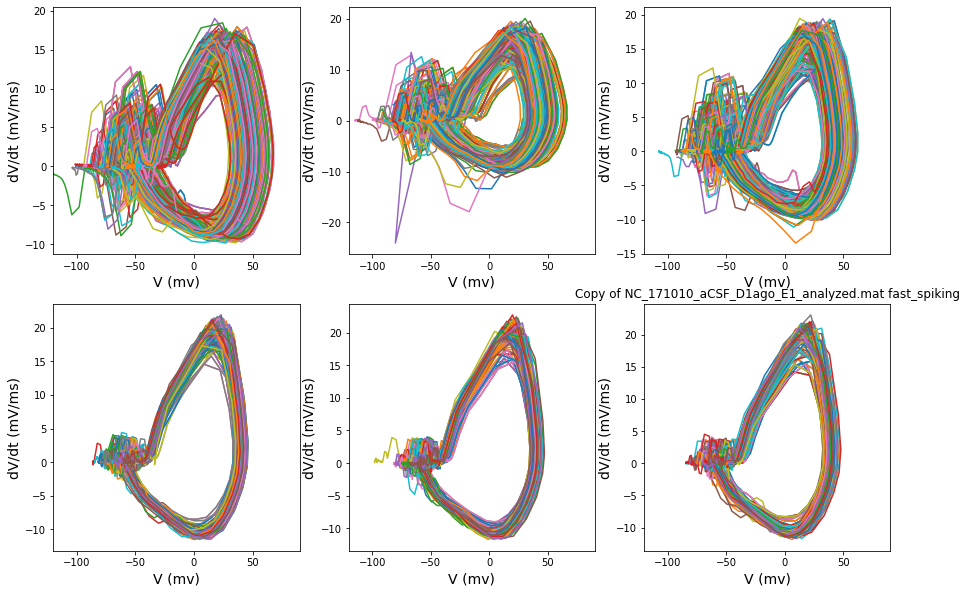

<ipython-input-14-f5b98abef153>:240: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:241: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be

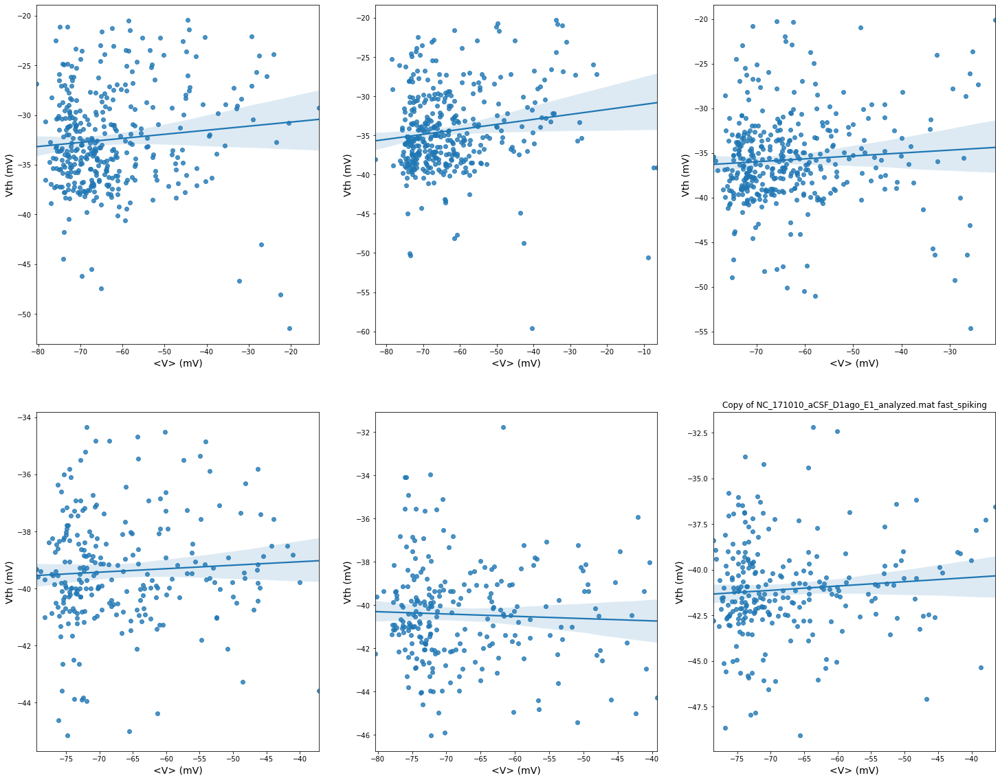

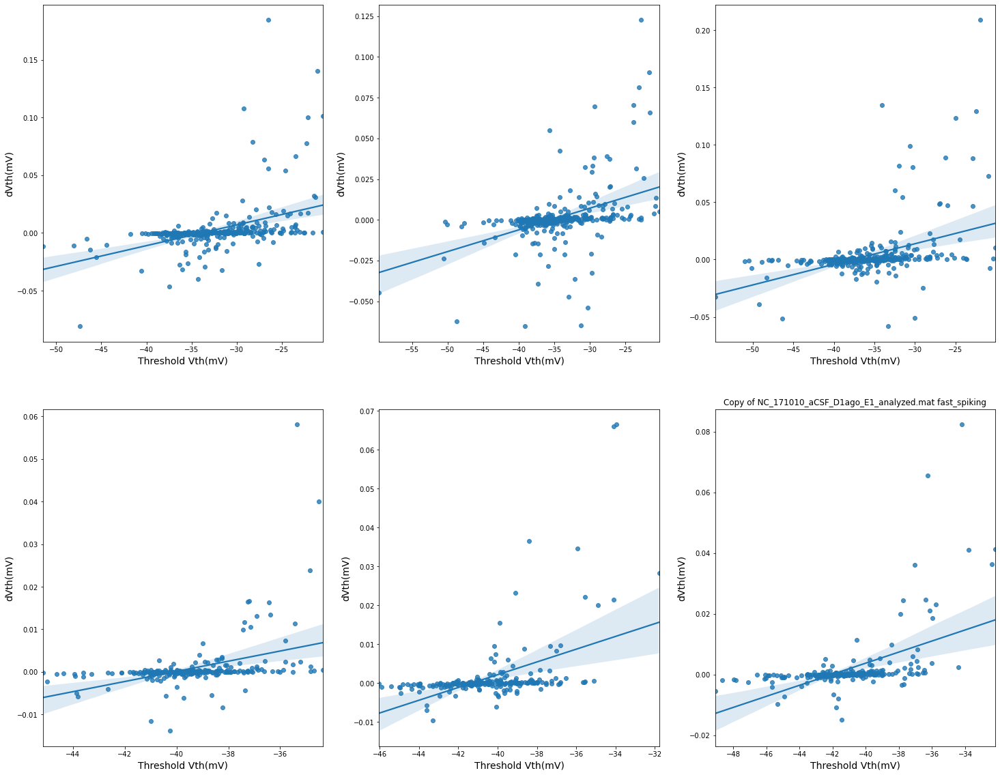

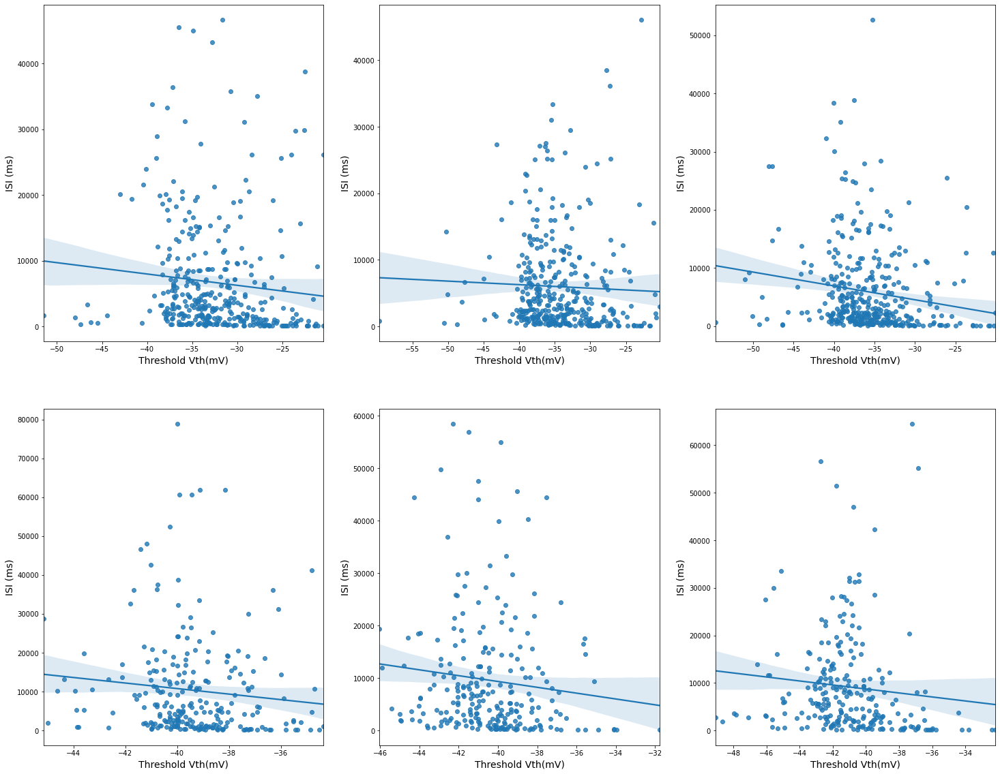

Copy of NC_171010_aCSF_D1ago_E3_analyzed.mat
('Fast Spiking', 'aCSF')
('Fast Spiking', 'aCSF')
('Fast Spiking', 'aCSF')


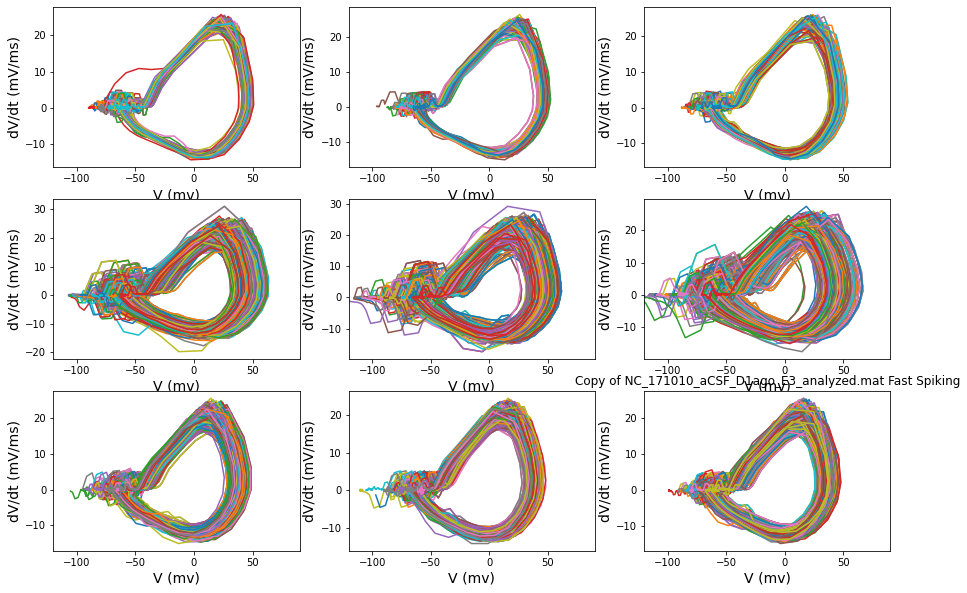

<ipython-input-14-f5b98abef153>:247: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:248: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:249: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be

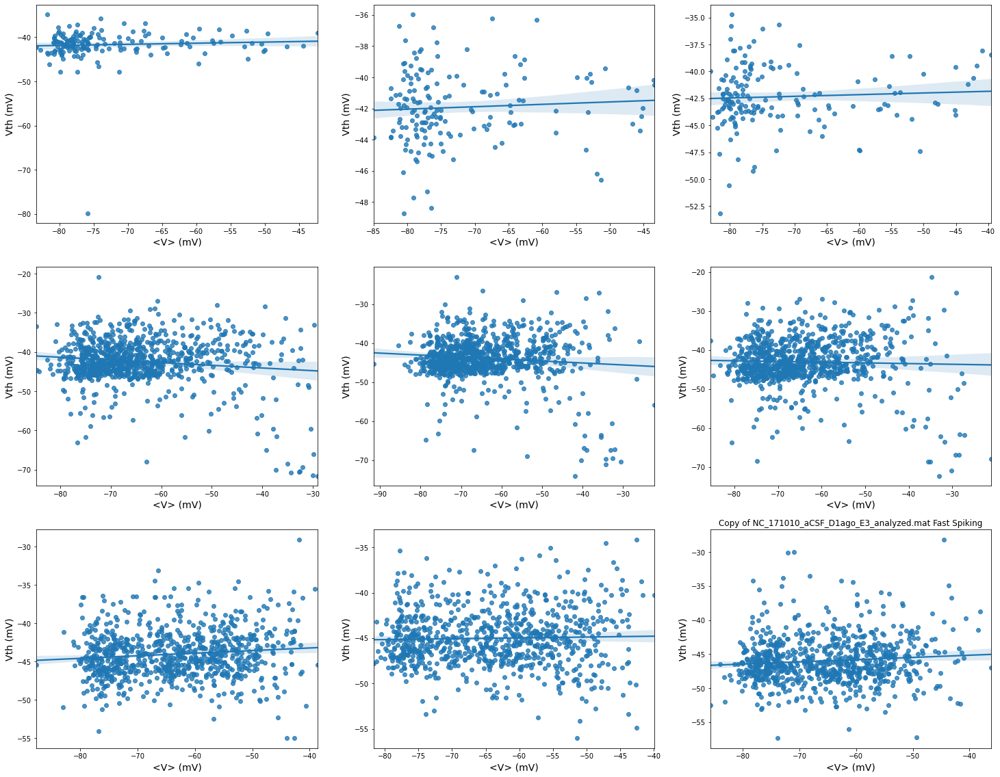

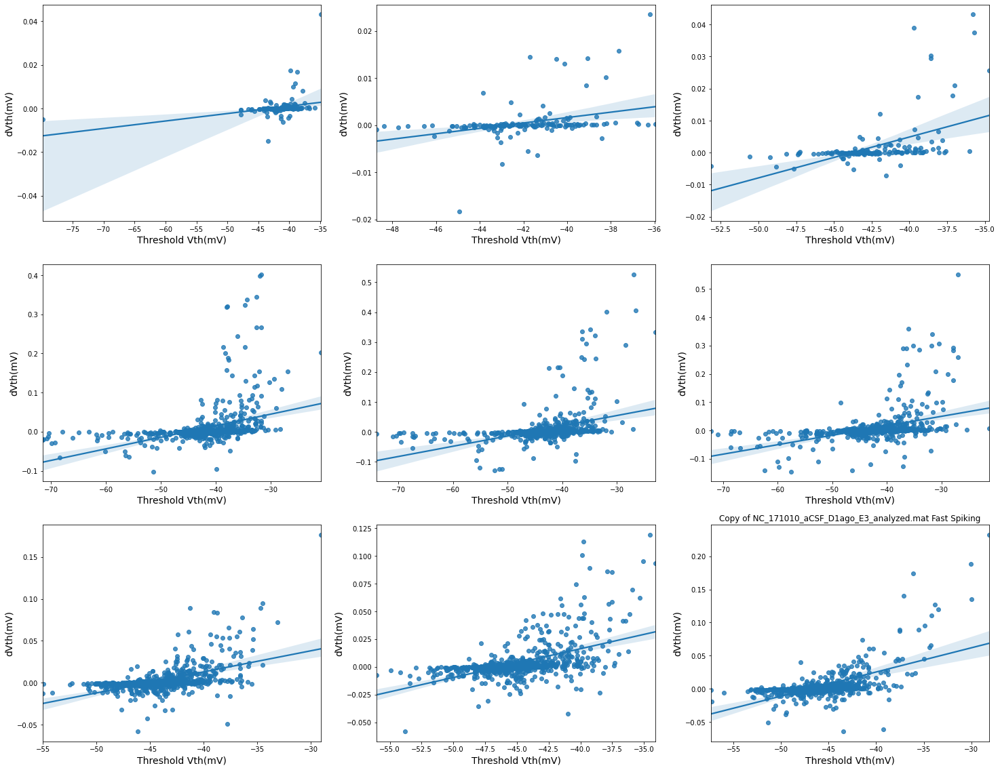

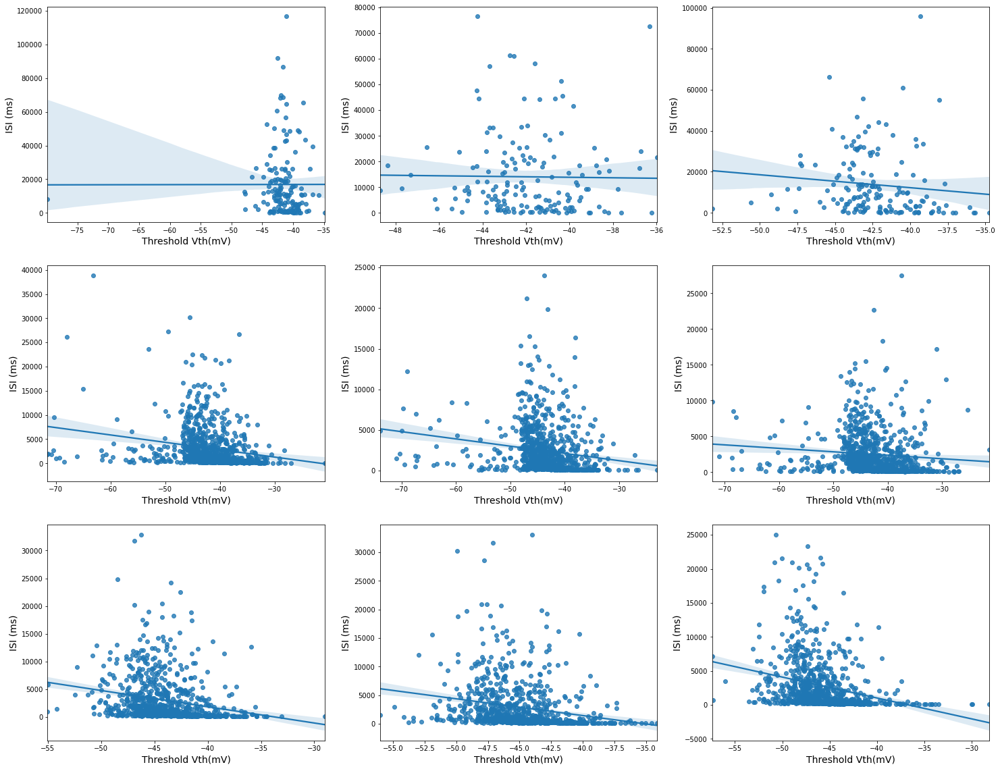

Copy of NC_171010_aCSF_D1ago_E4_analyzed.mat
('pyramidal', 'aCSF')
('pyramidal', 'aCSF')


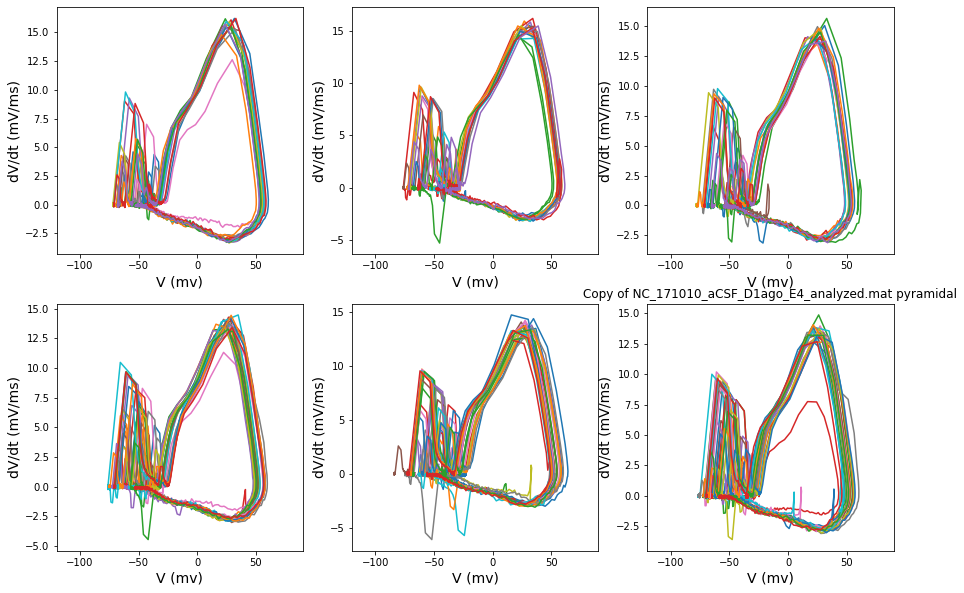

<ipython-input-14-f5b98abef153>:240: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:241: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be

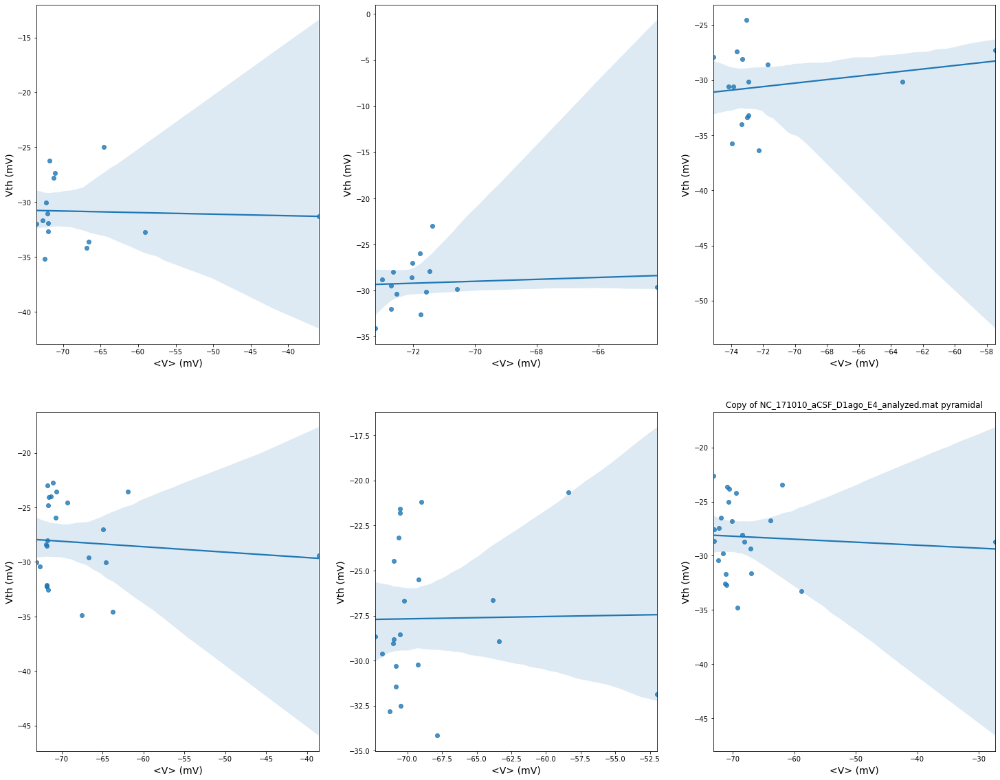

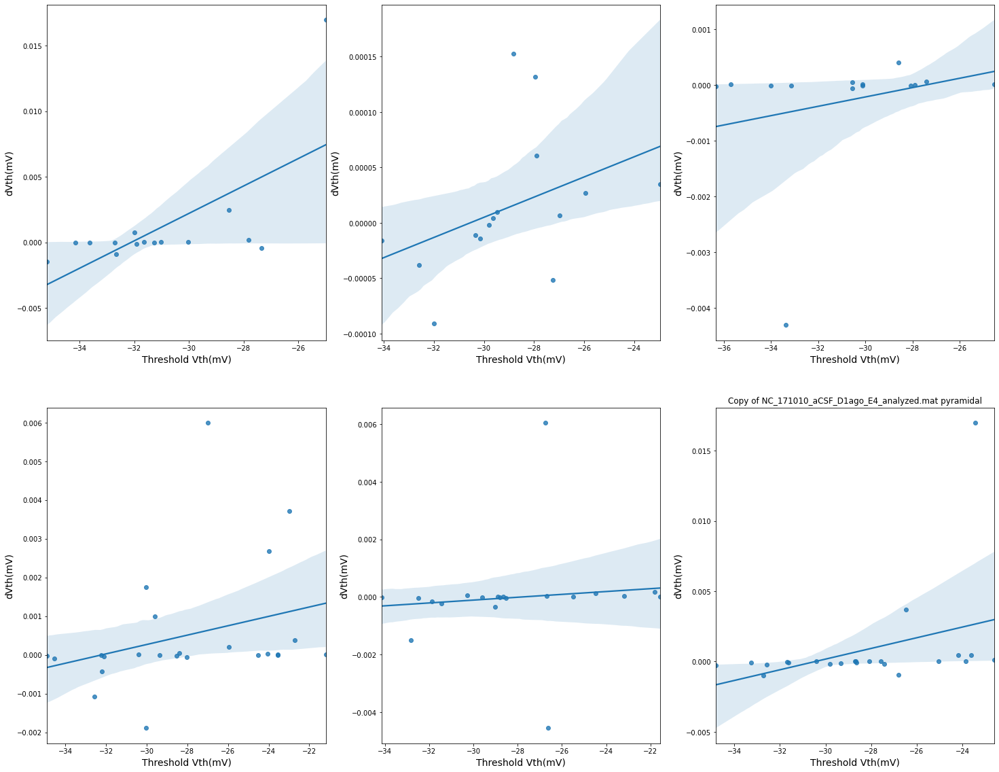

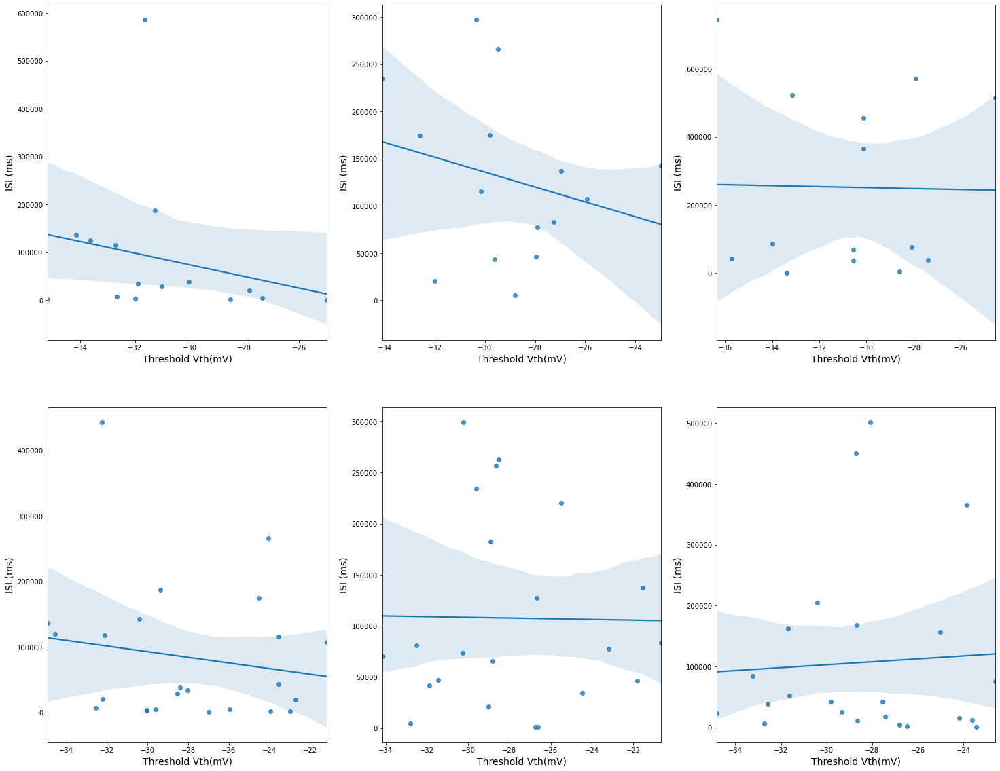

Copy of NC_171110_aCSF_D1ago_E1_analyzed.mat
('Fast Spiking', 'aCSF')
('Fast Spiking', 'aCSF')


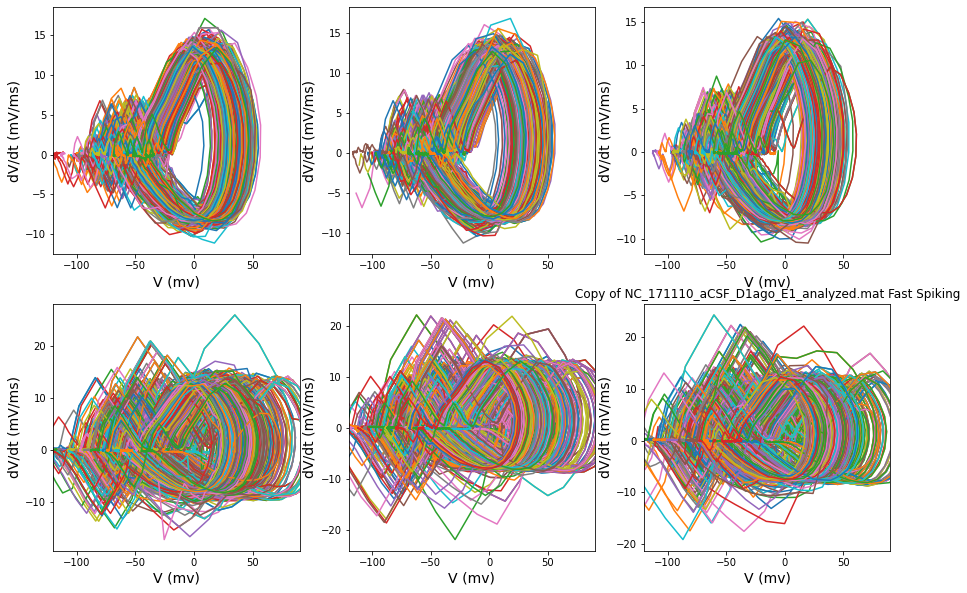

<ipython-input-14-f5b98abef153>:240: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:241: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be

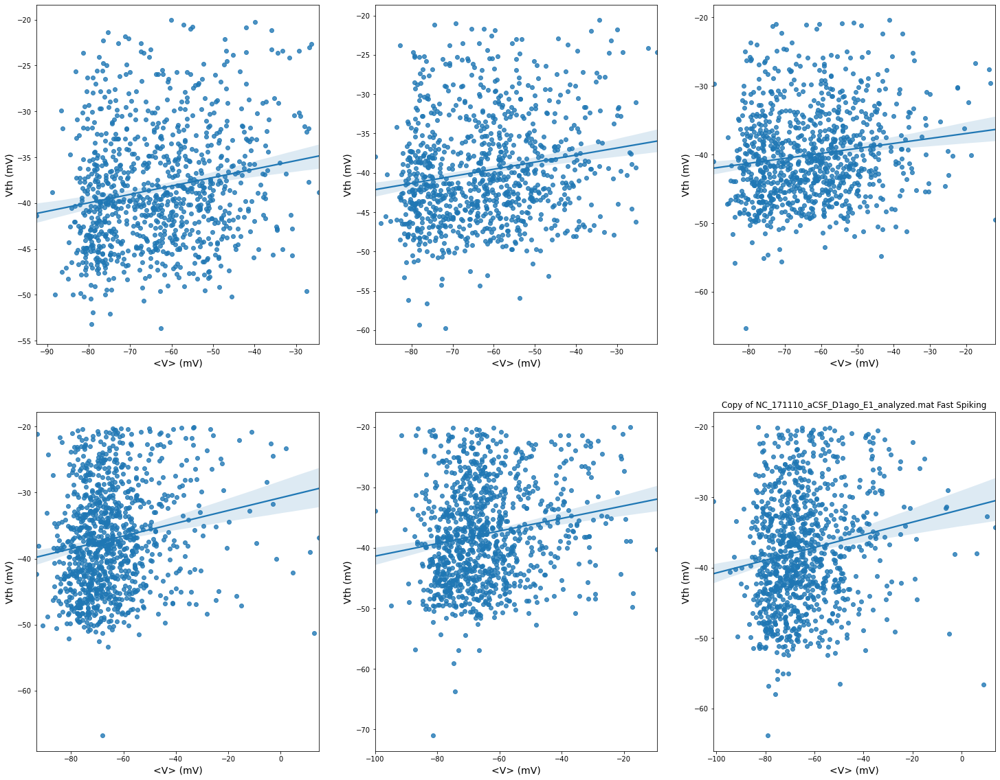

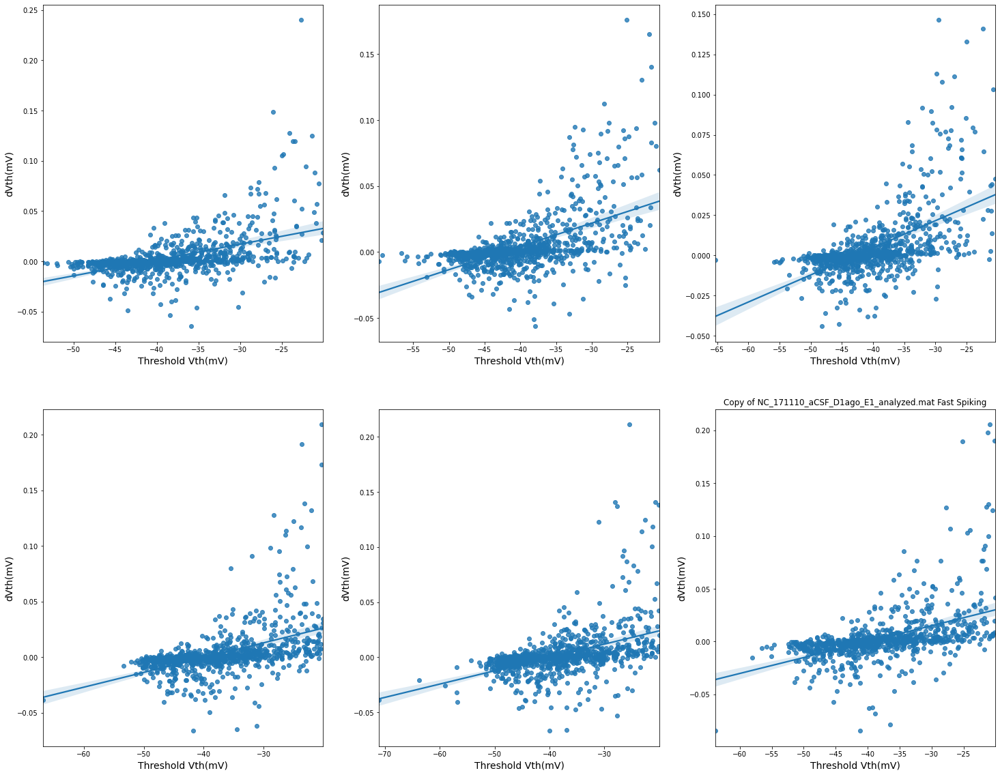

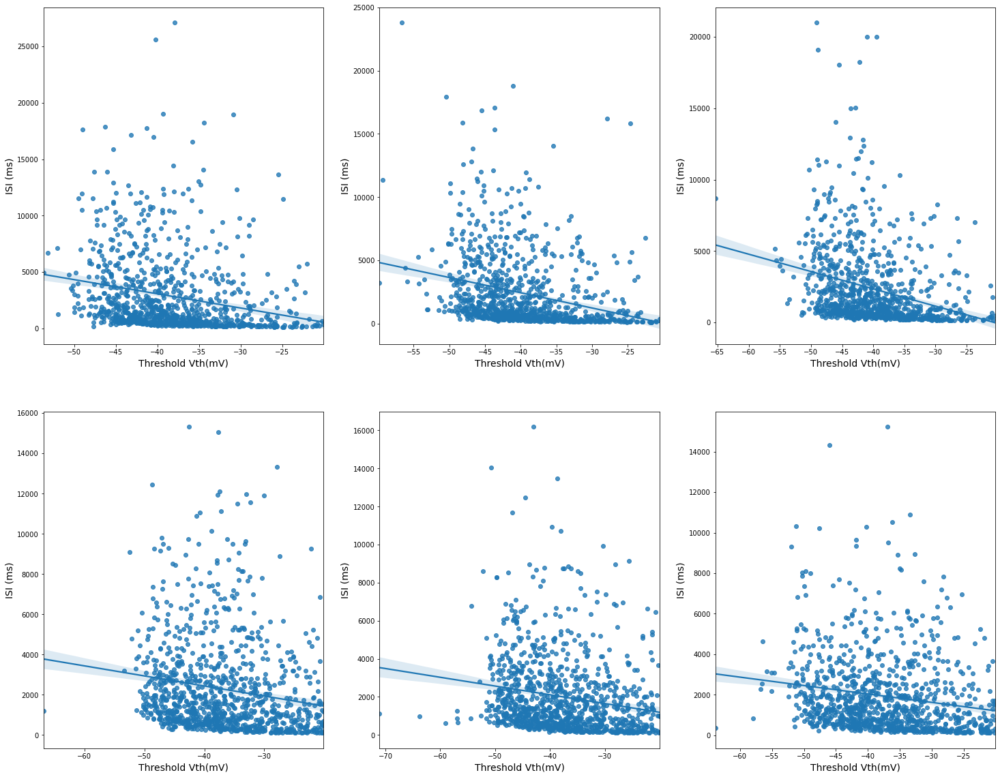

Copy of NC_171110_aCSF_D1ago_E2_analyzed.mat
('Fast Spiking', 'aCSF')
('Fast Spiking', 'aCSF')


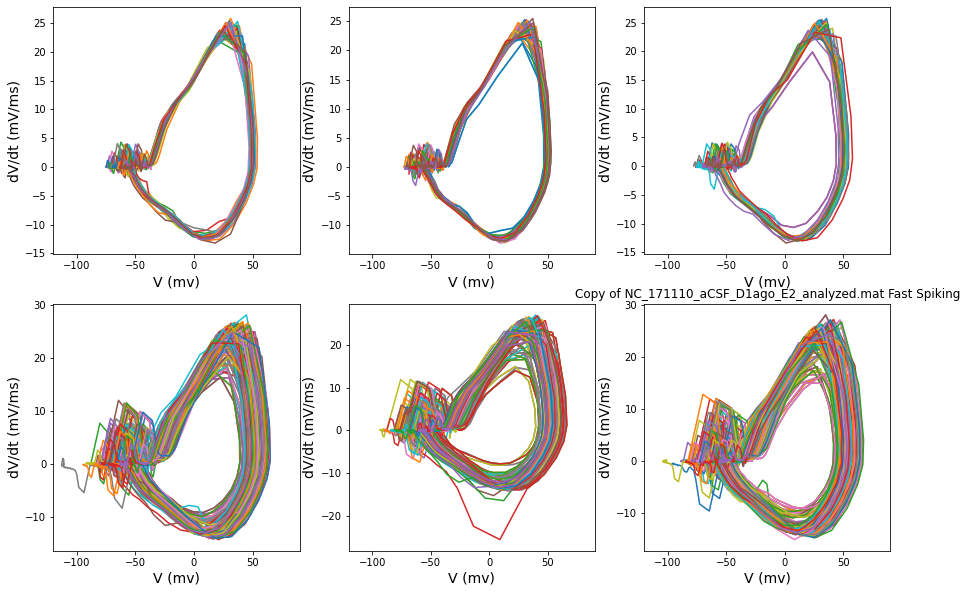

<ipython-input-14-f5b98abef153>:240: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:241: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be

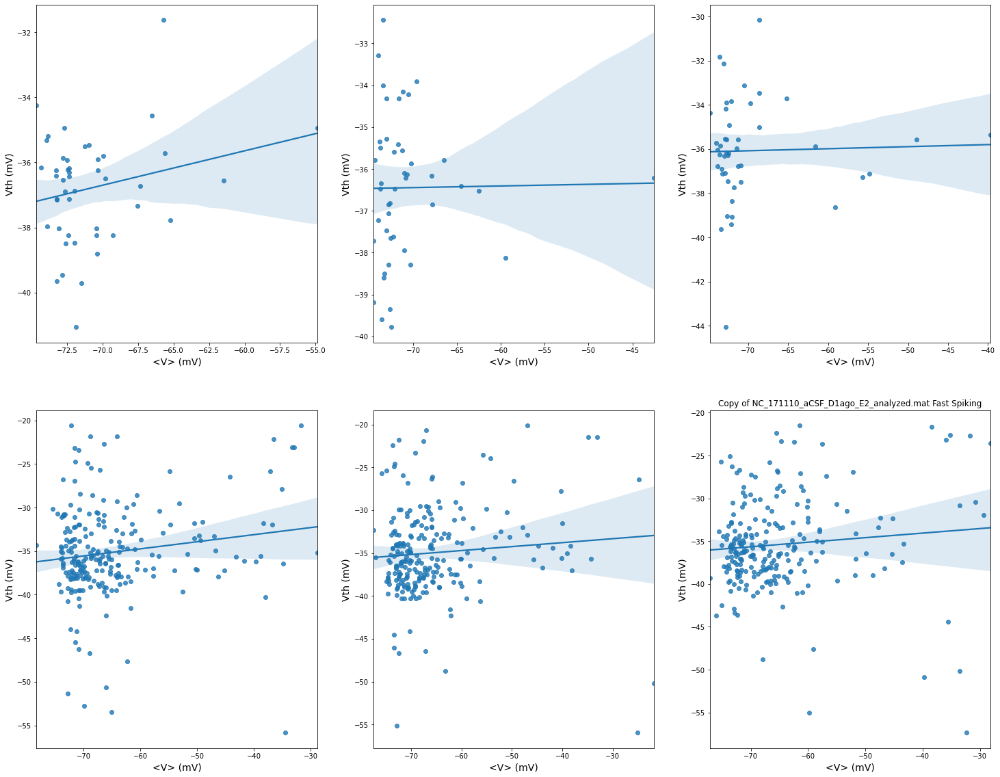

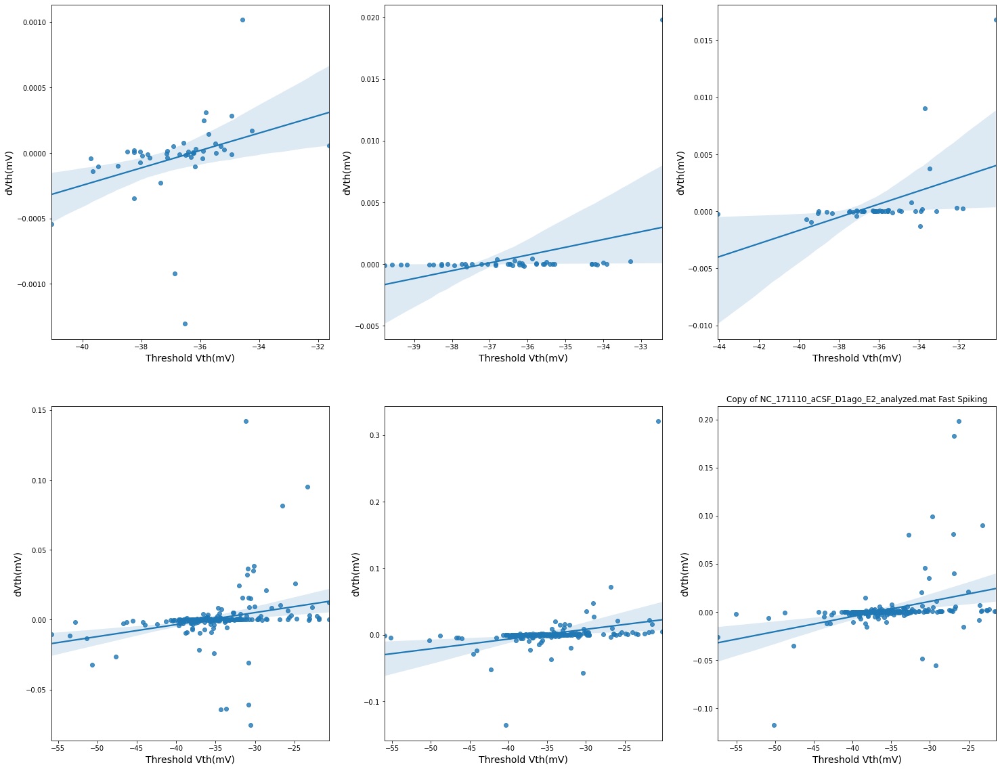

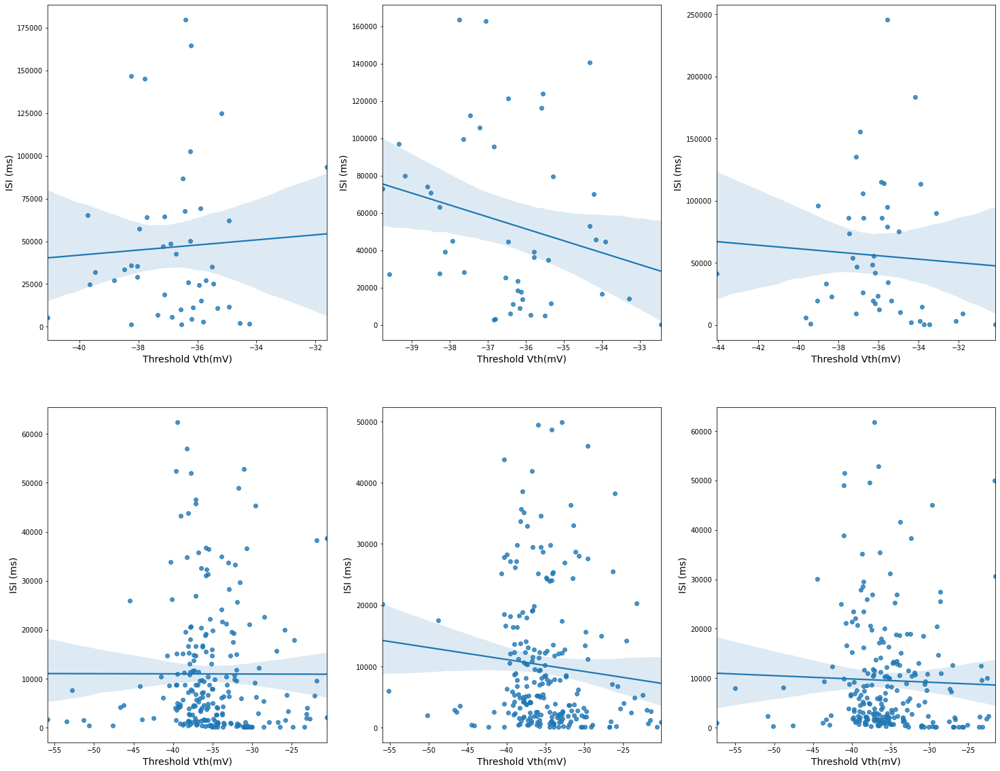

Copy of NC_171110_aCSF_D1ago_E3_analyzed.mat
('Fast Spiking', 'aCSF')
('Fast Spiking', 'aCSF')


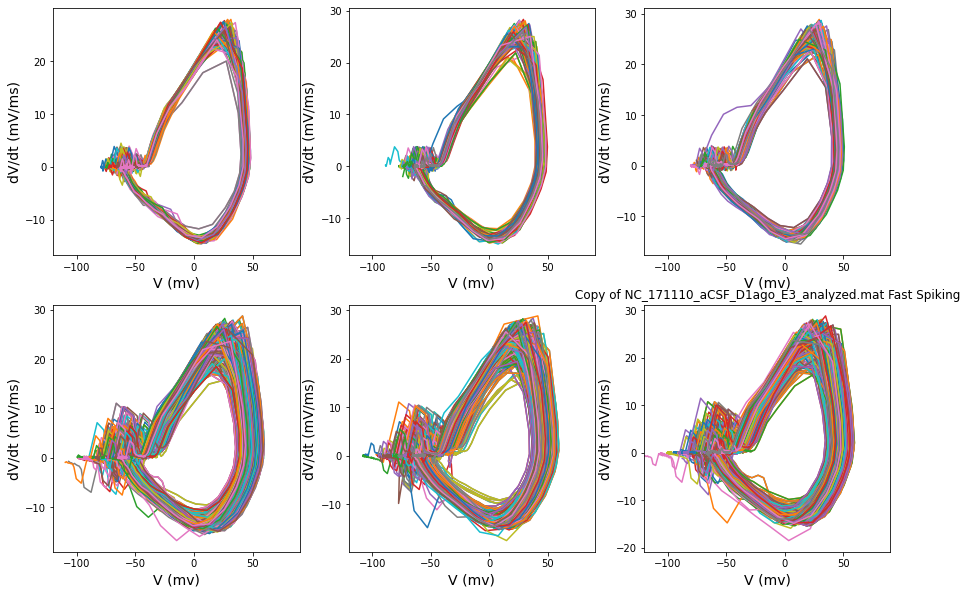

<ipython-input-14-f5b98abef153>:240: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:241: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be

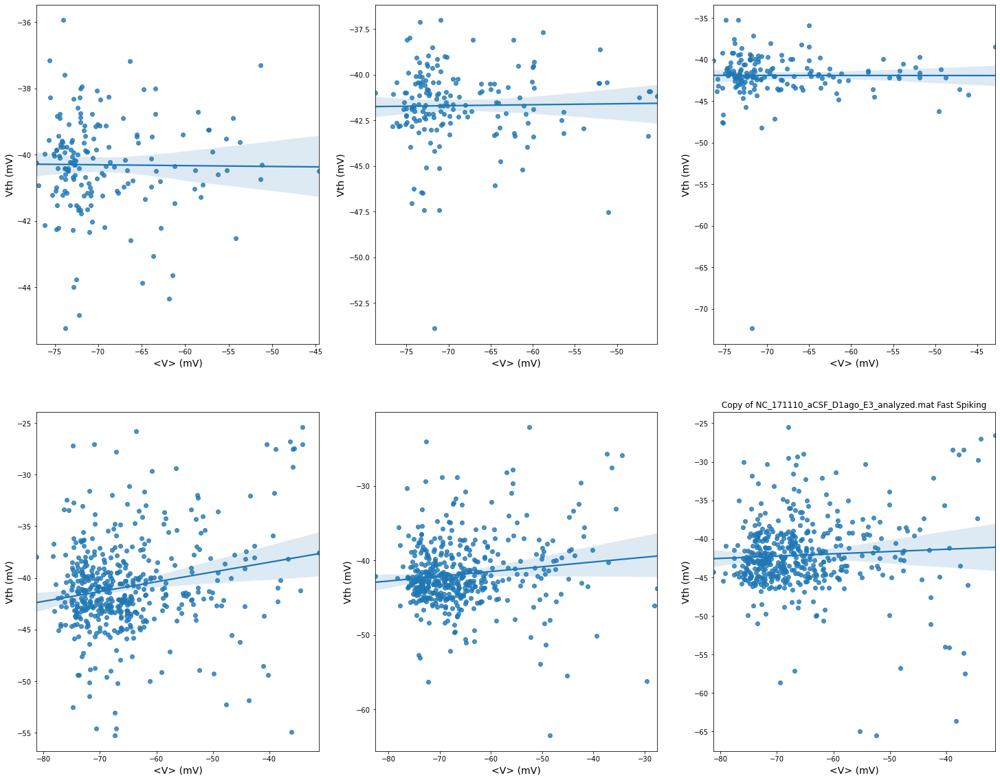

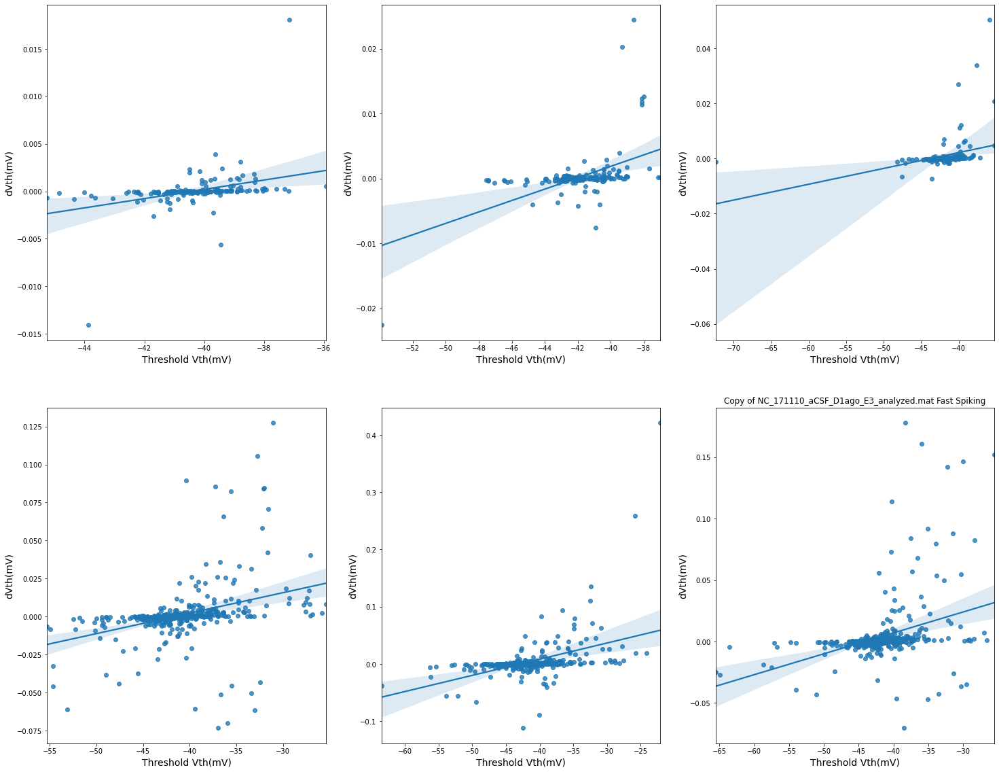

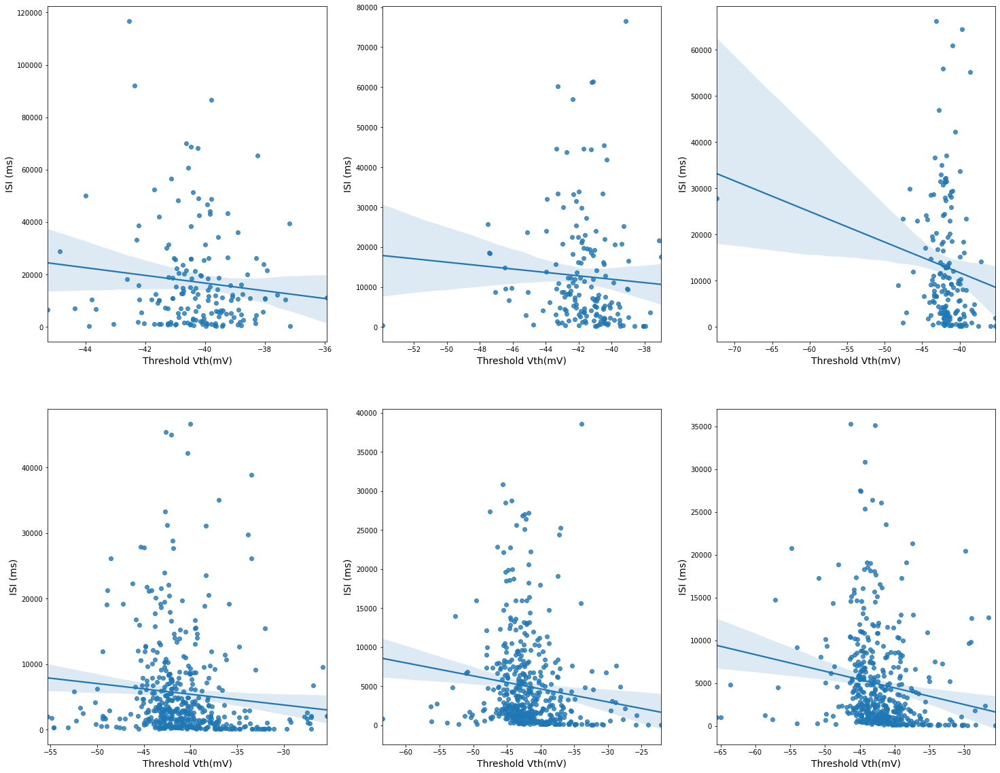

Copy of NC_171207_aCSF_E1_analyzed.mat
('Fast Spiking', 'aCSF')
('Fast Spiking', 'aCSF')
('Fast Spiking', 'aCSF')


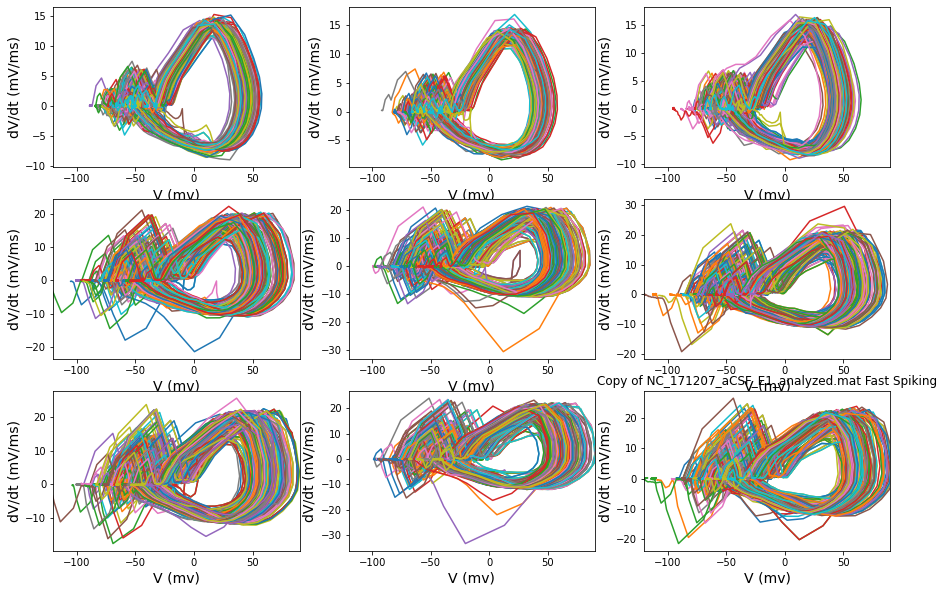

<ipython-input-14-f5b98abef153>:247: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:248: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:249: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be

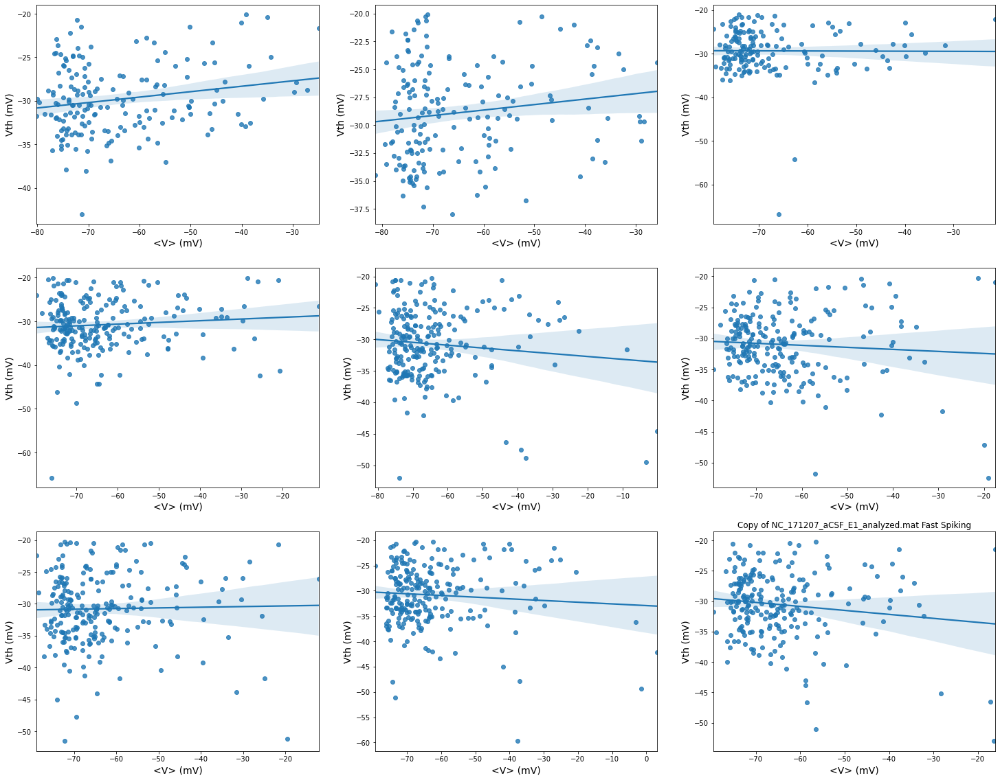

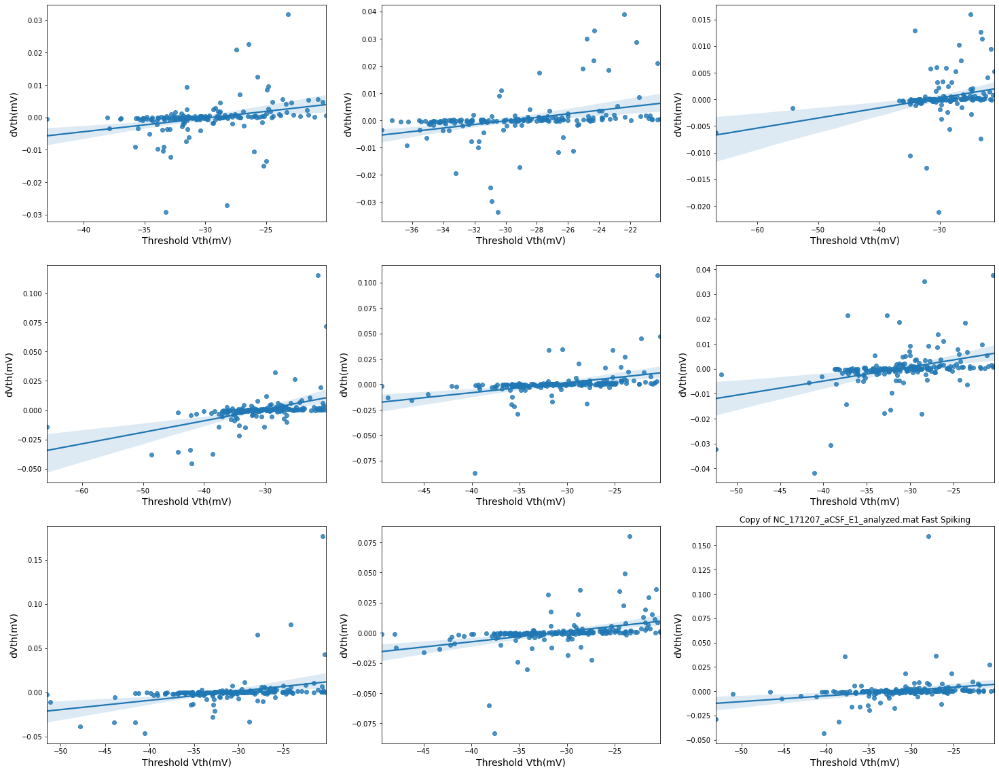

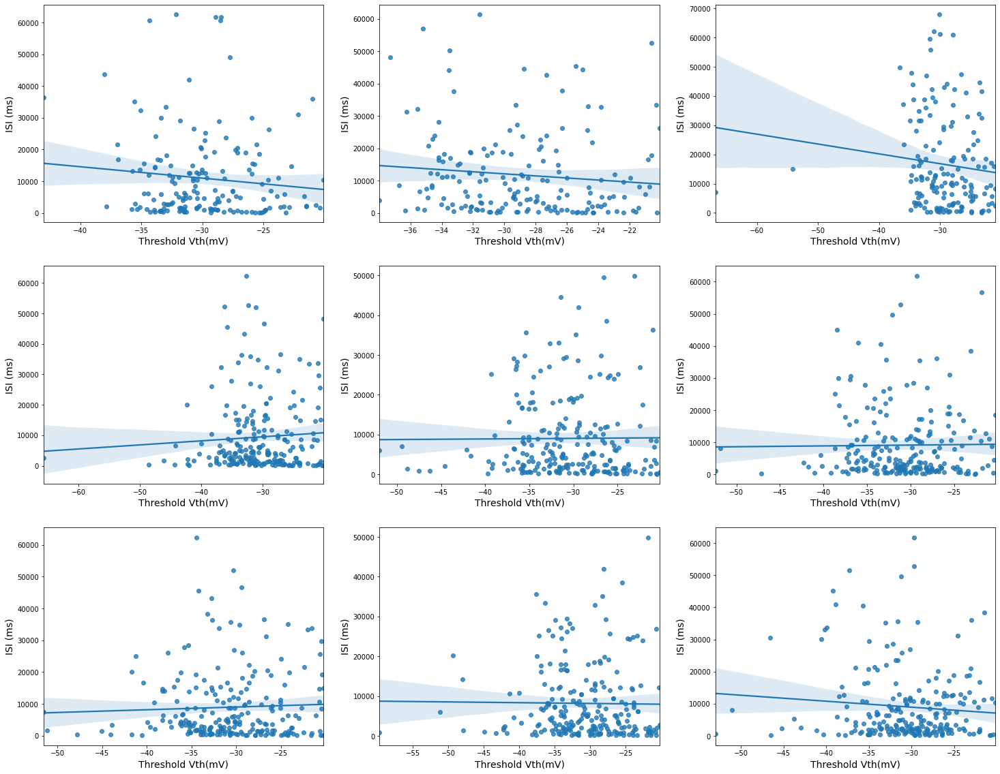

Copy of NC_171207_aCSF_E3_analyzed.mat
('Fast Spiking', 'aCSF')
('Fast Spiking', 'aCSF')
('Fast Spiking', 'aCSF')


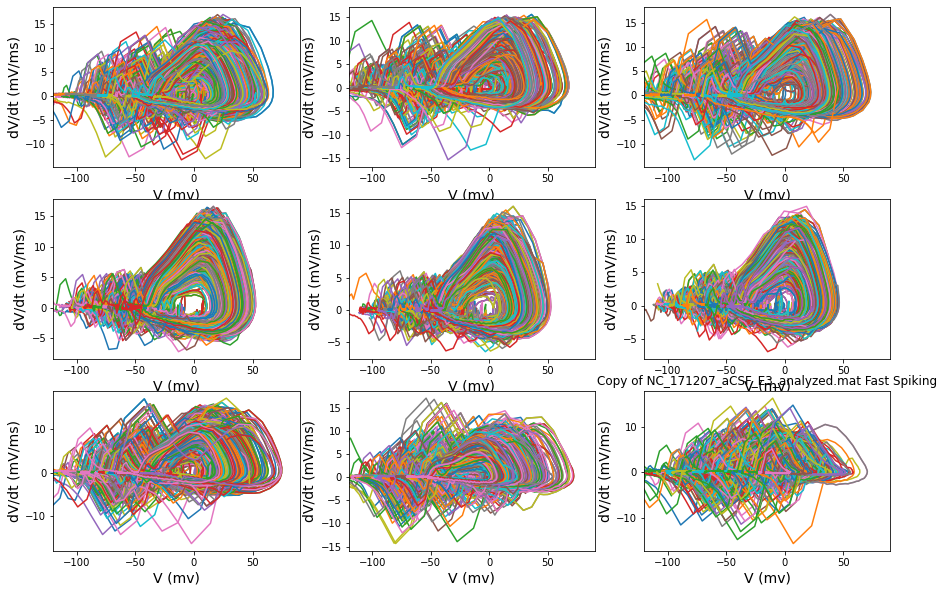

<ipython-input-14-f5b98abef153>:247: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:248: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:249: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be

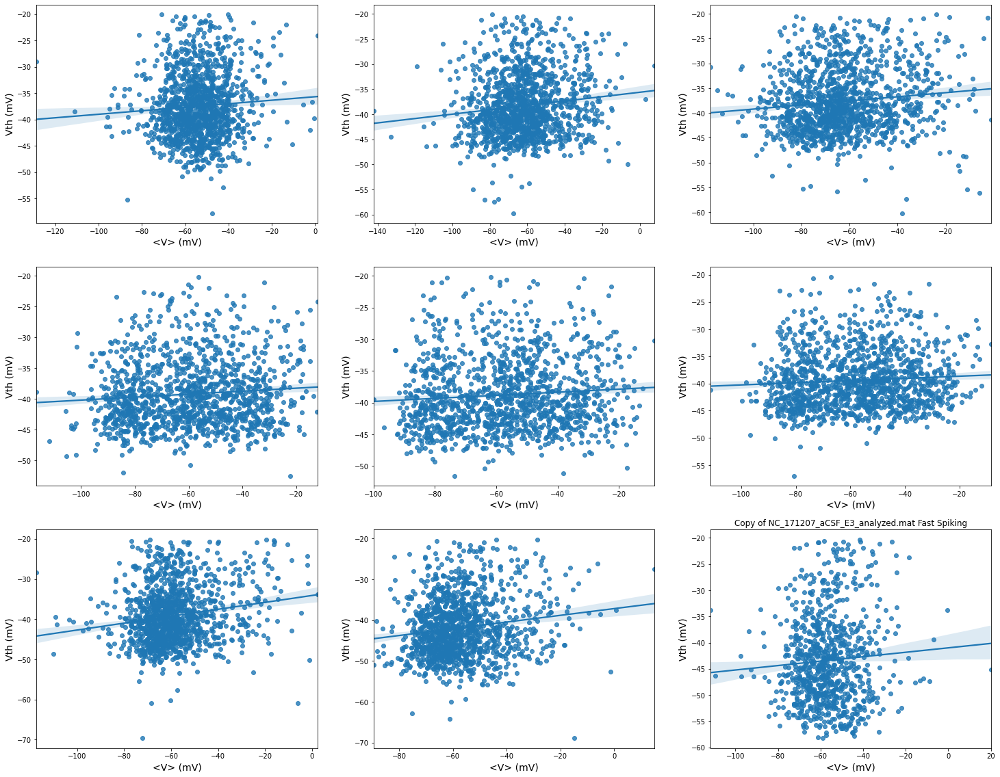

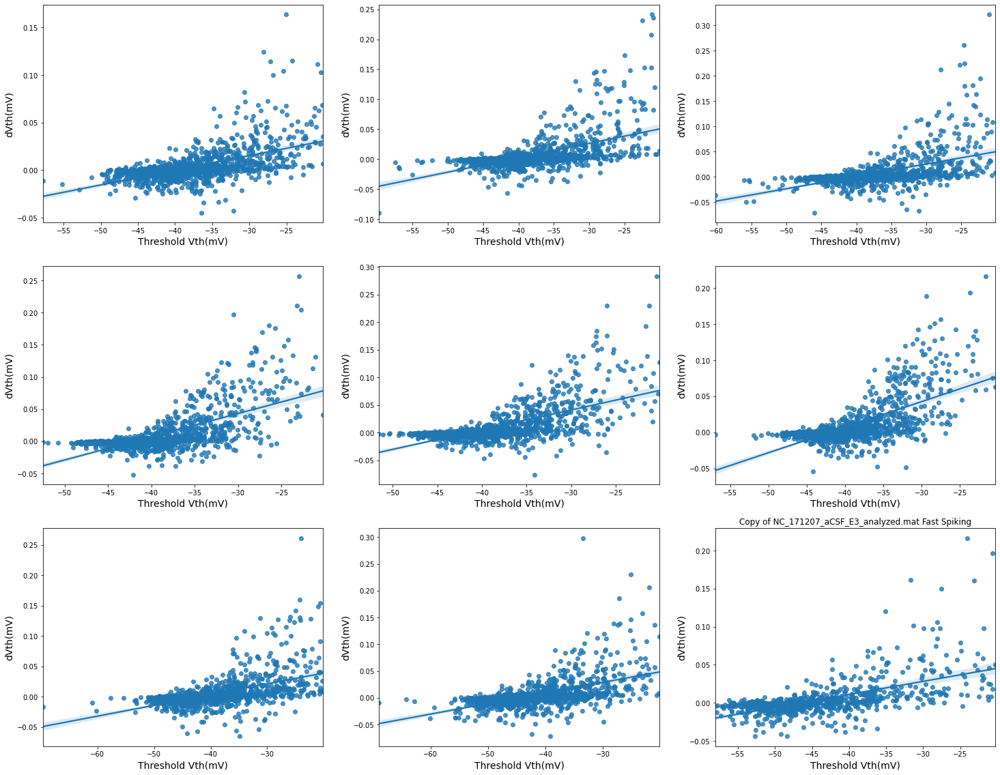

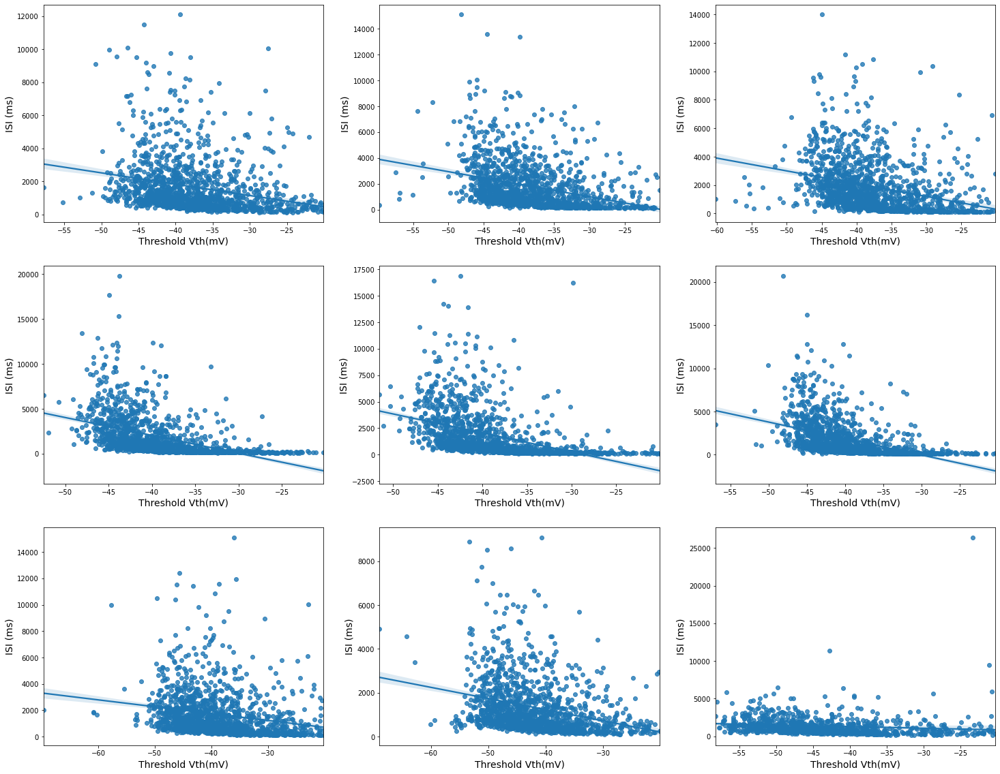

Copy of NC_171207_aCSF_E4_analyzed.mat
('Fast Spiking', 'aCSF')
('Fast Spiking', 'aCSF')


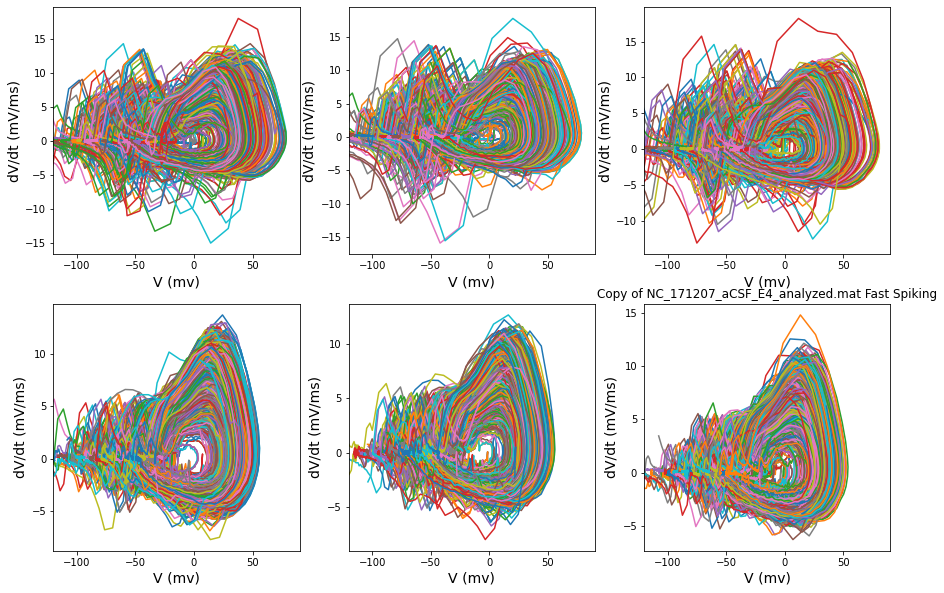

<ipython-input-14-f5b98abef153>:240: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:241: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be

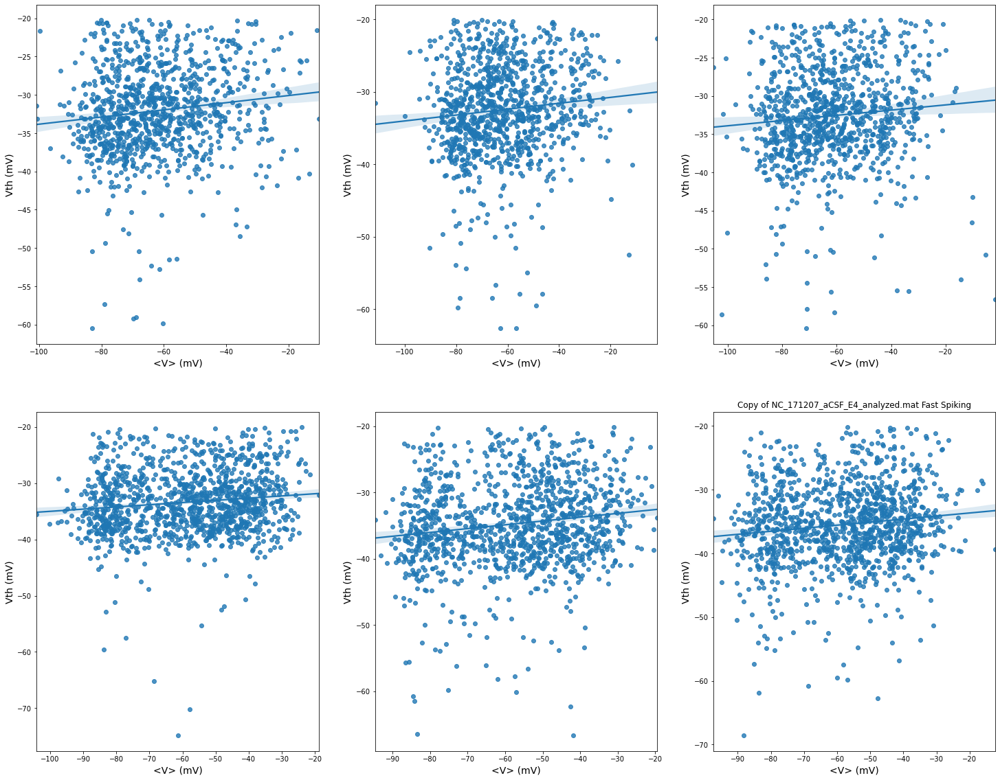

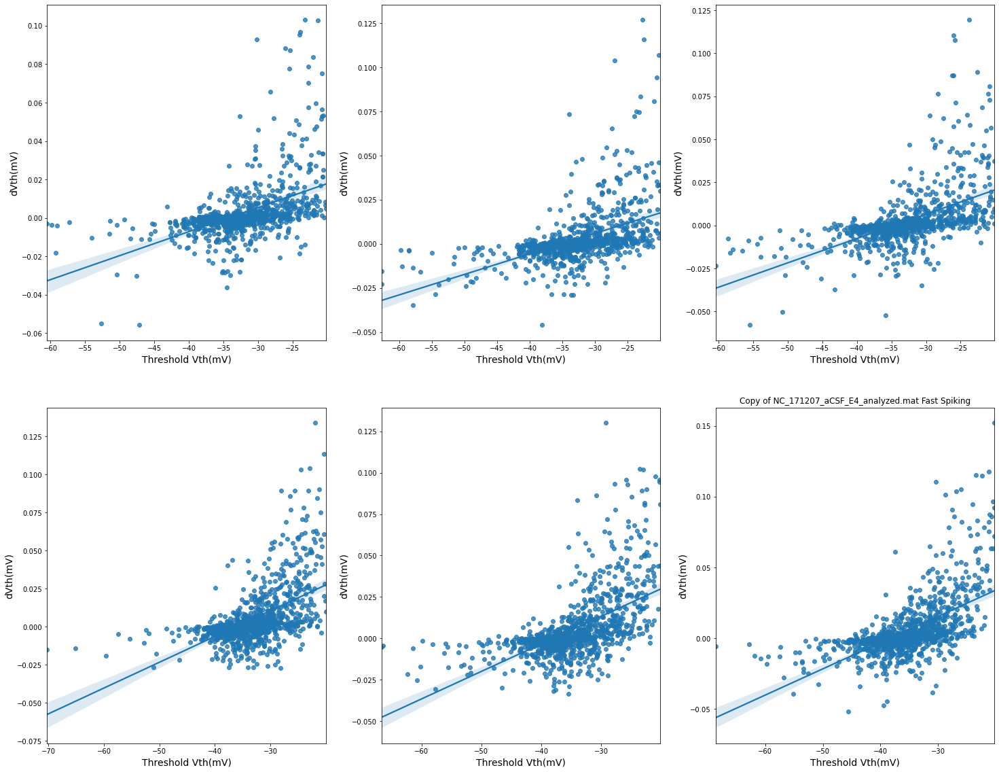

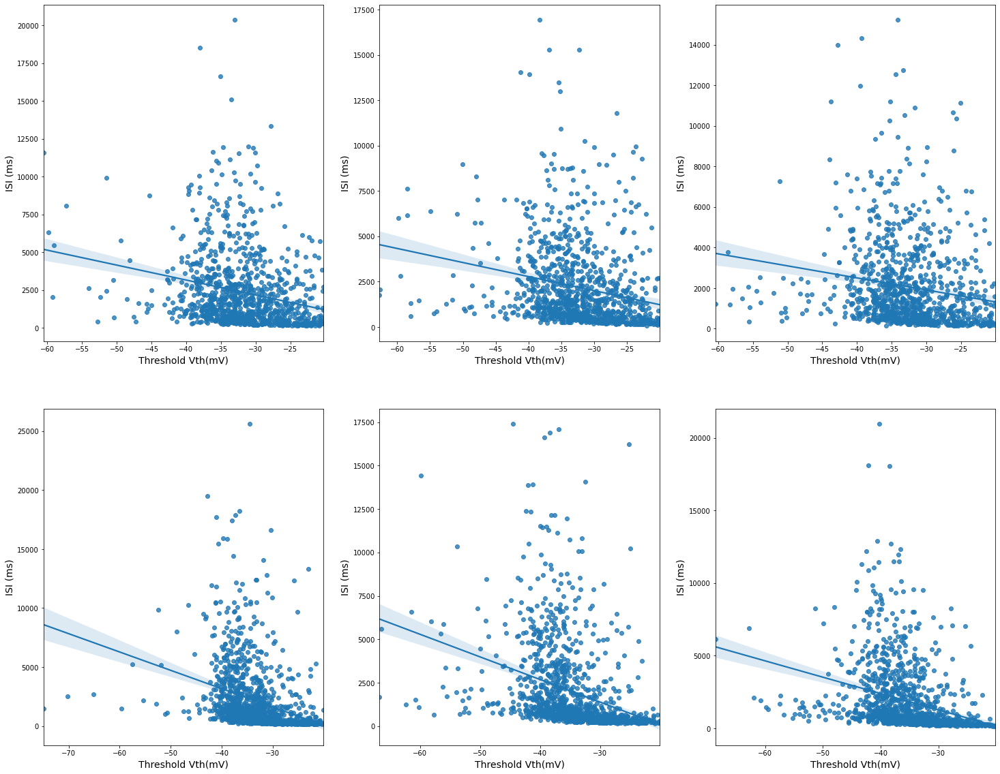

Copy of NC_171207_aCSF_E5_analyzed.mat
('Fast Spiking', 'aCSF')
('Fast Spiking', 'aCSF')


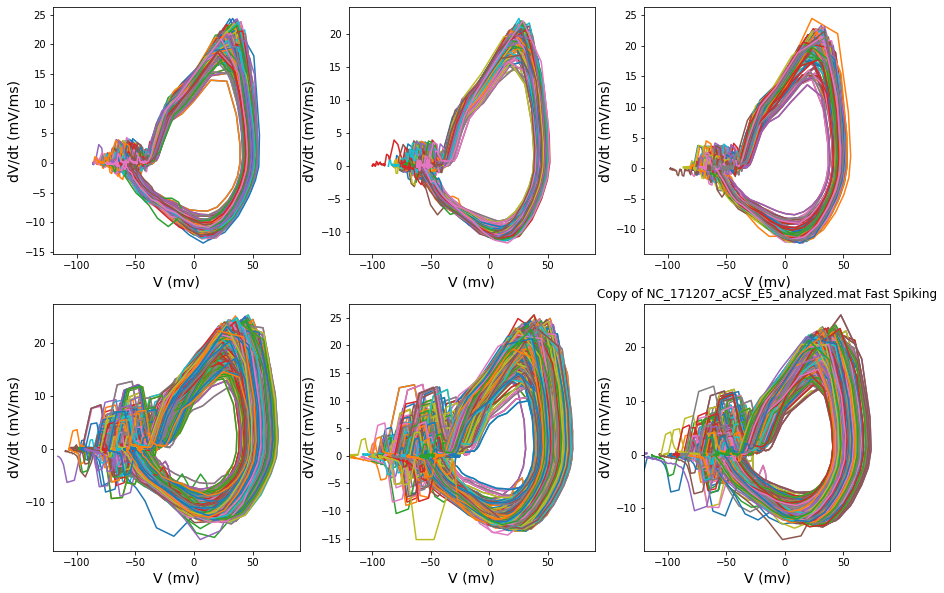

<ipython-input-14-f5b98abef153>:240: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:241: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be

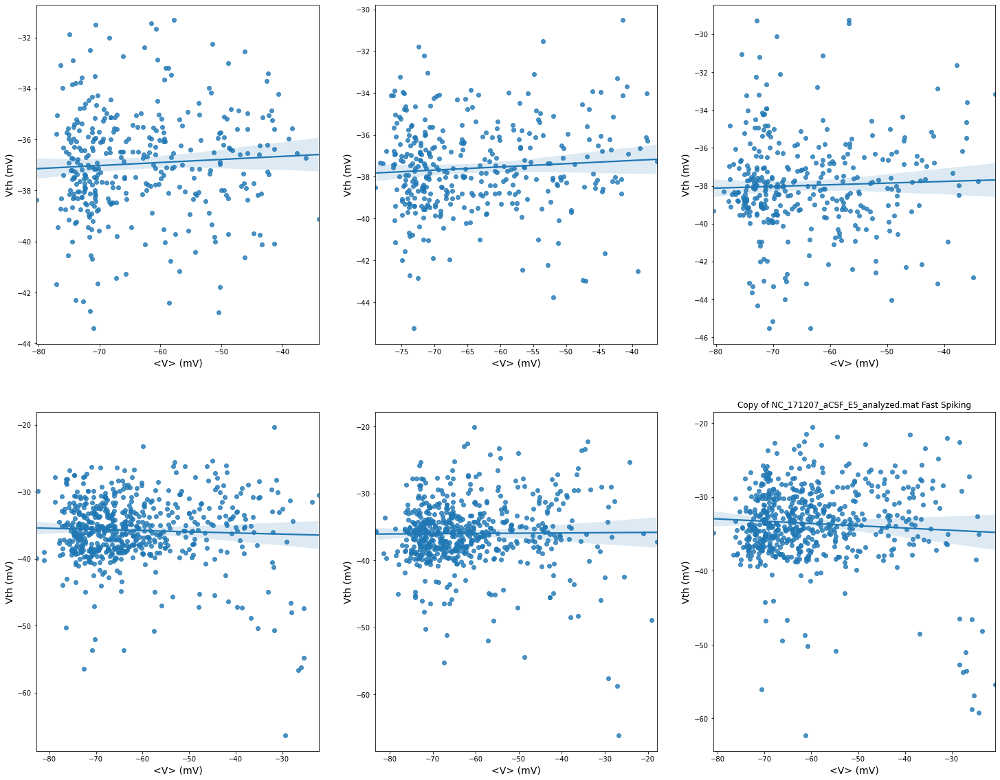

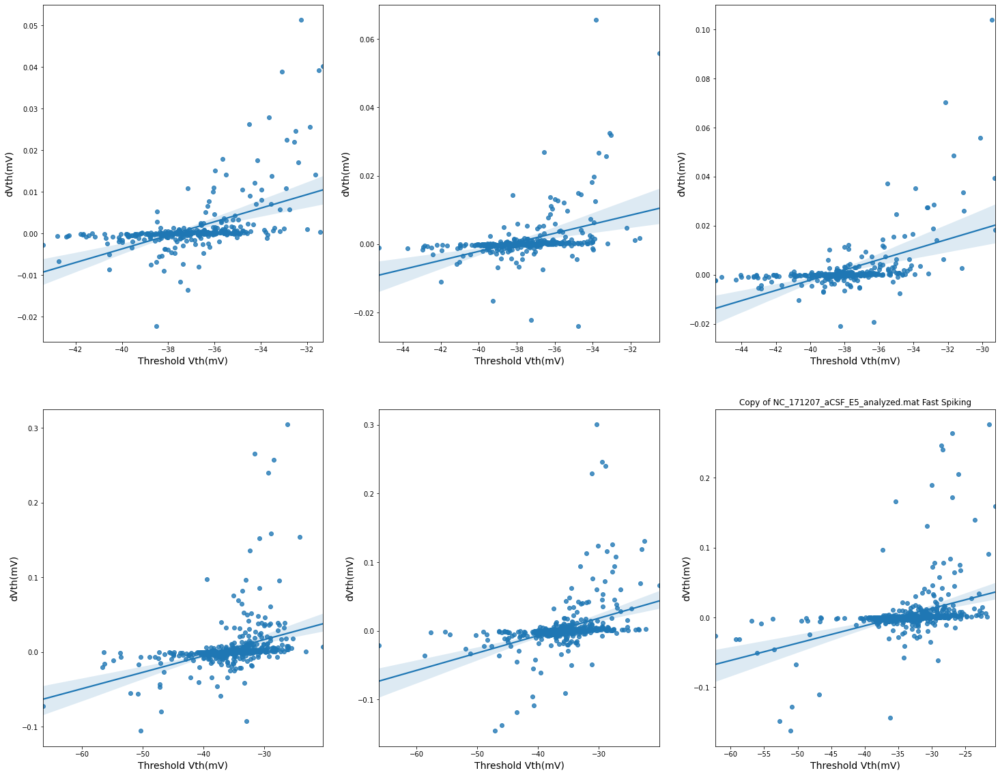

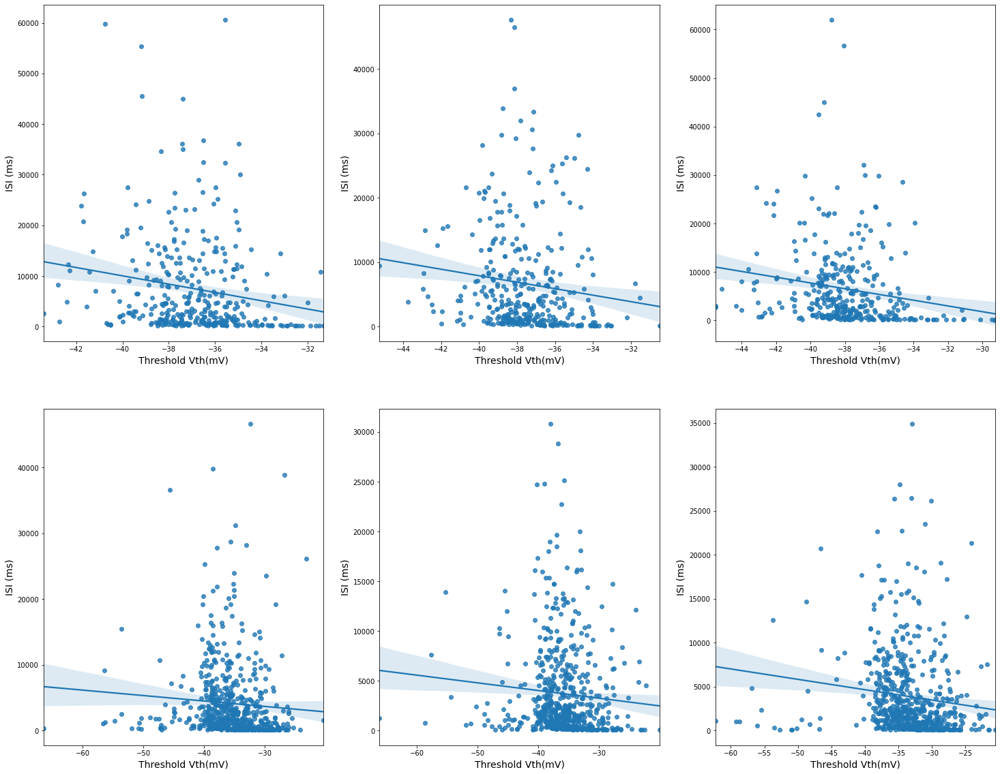

Copy of NC_171207_aCSF_E6_analyzed.mat
('Fast Spiking', 'aCSF')
('Fast Spiking', 'aCSF')
('Fast Spiking', 'aCSF')


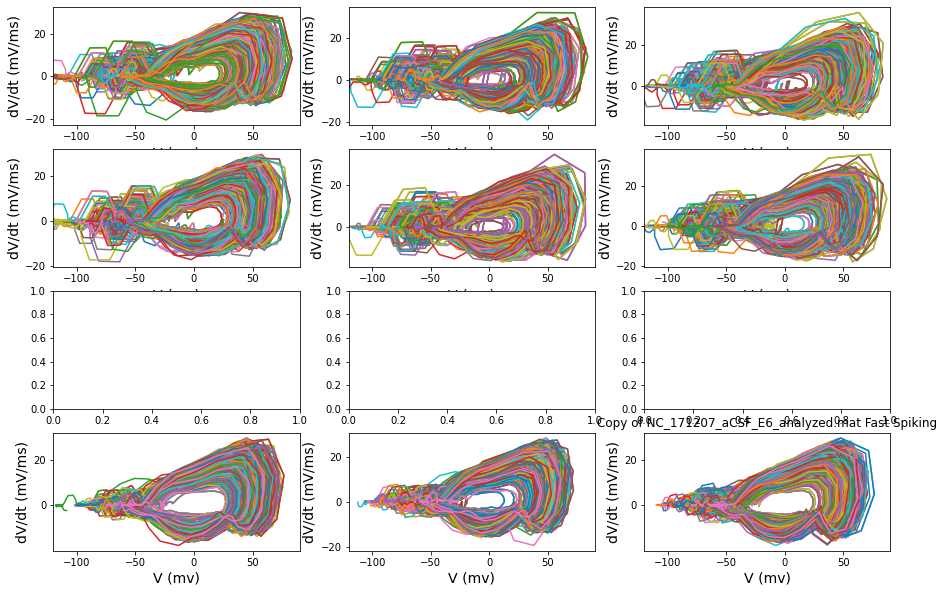

<ipython-input-14-f5b98abef153>:257: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:258: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:259: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be

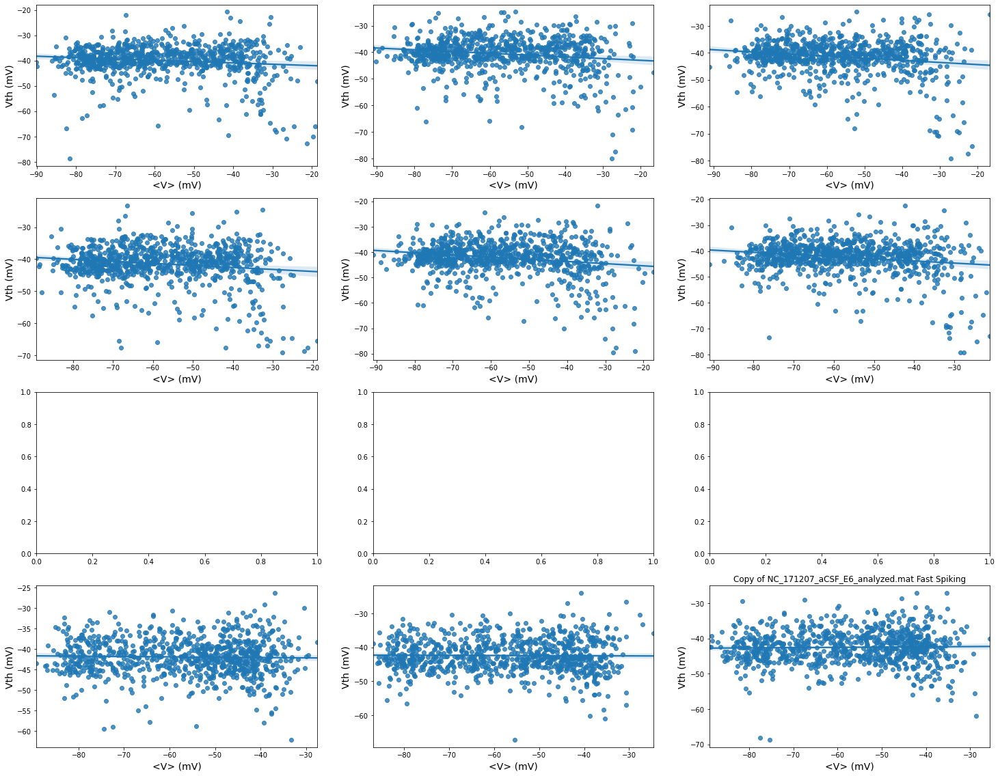

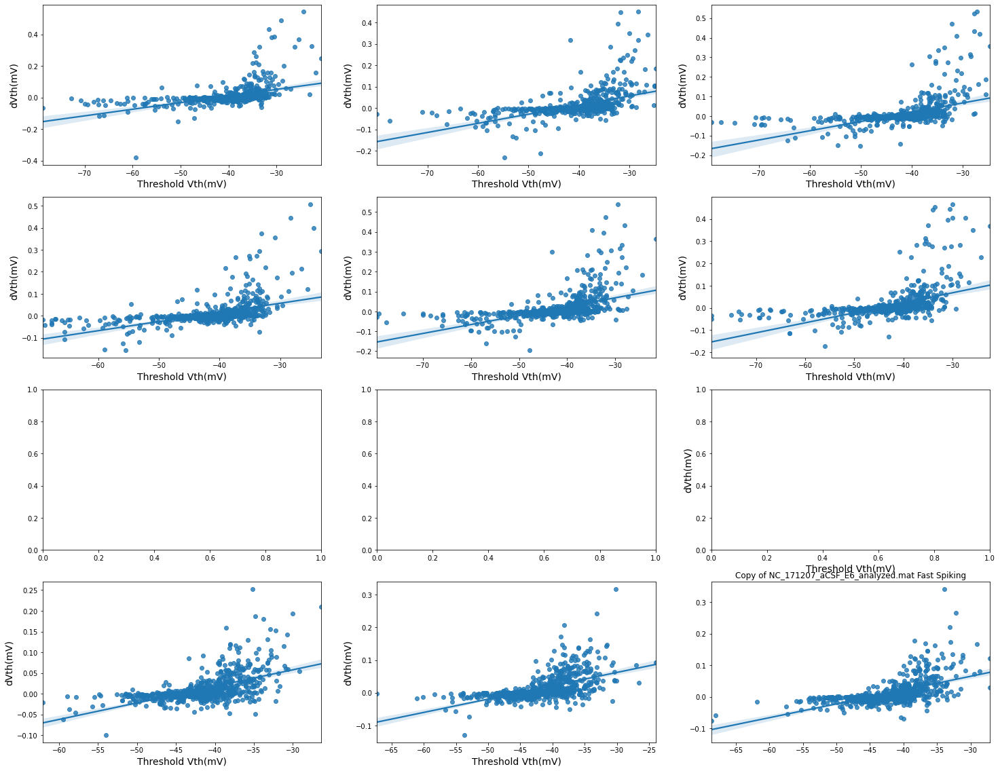

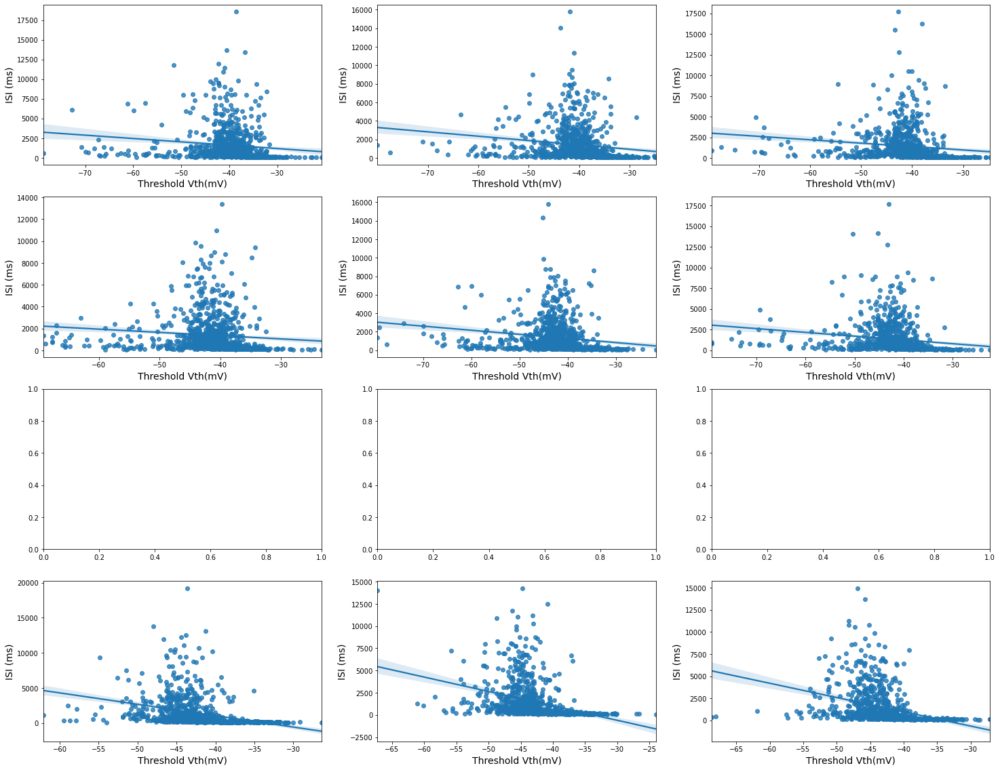

Copy of NC_171211_aCSF_E2_analyzed.mat
('Fast Spiking', 'aCSF')
('Fast Spiking', 'aCSF')


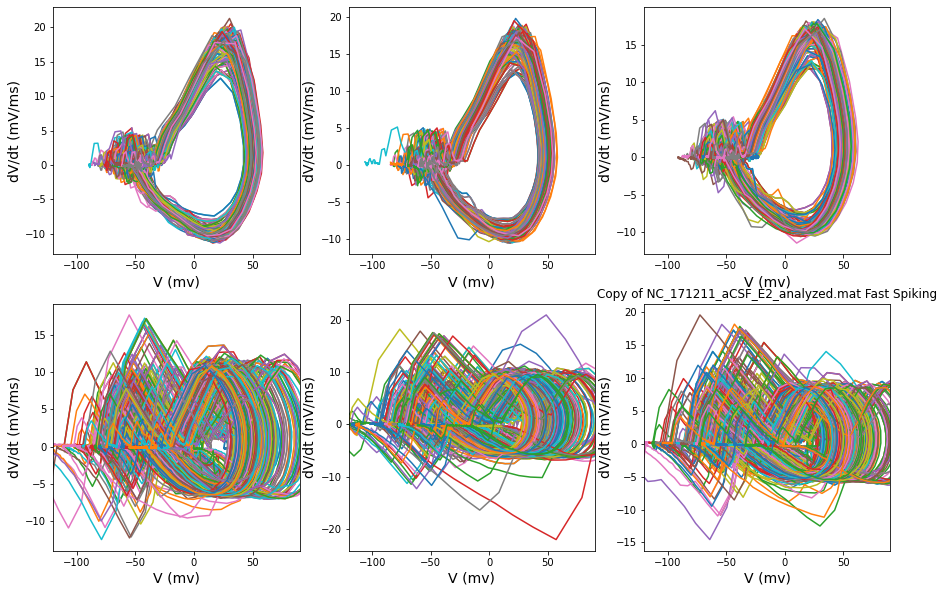

<ipython-input-14-f5b98abef153>:240: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:241: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be

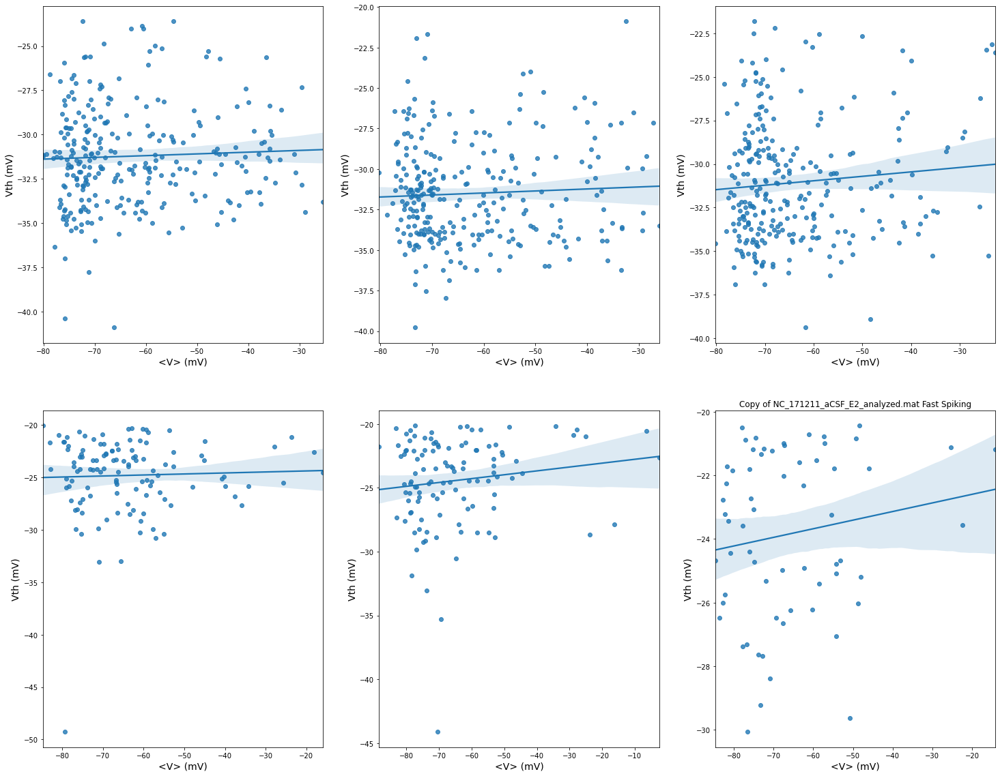

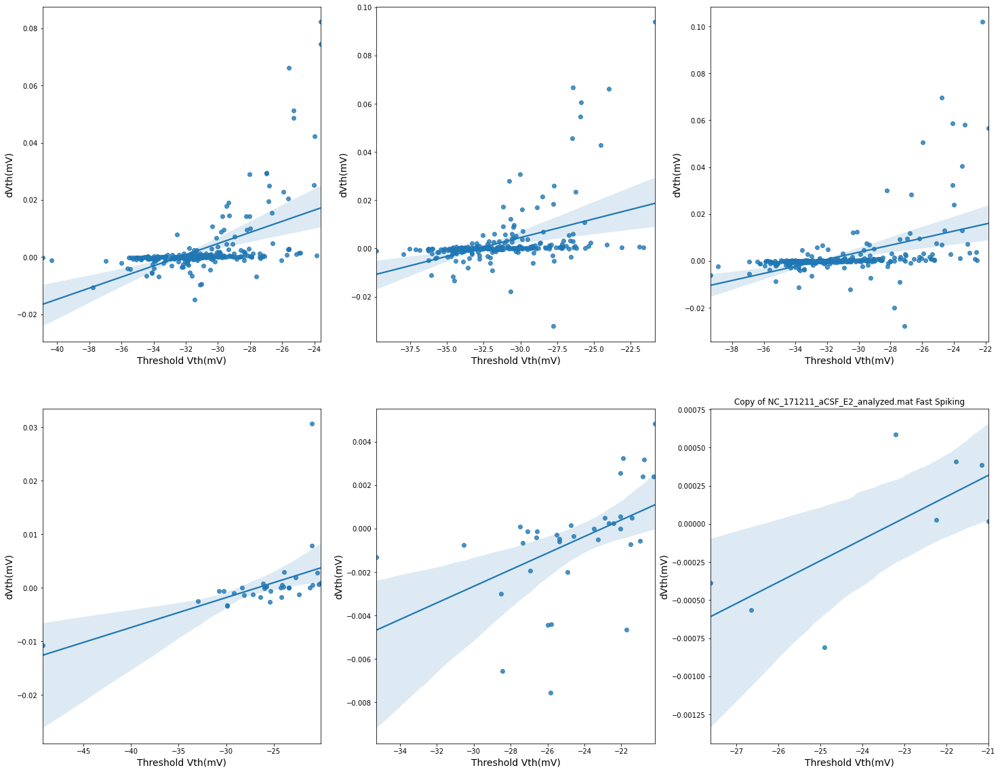

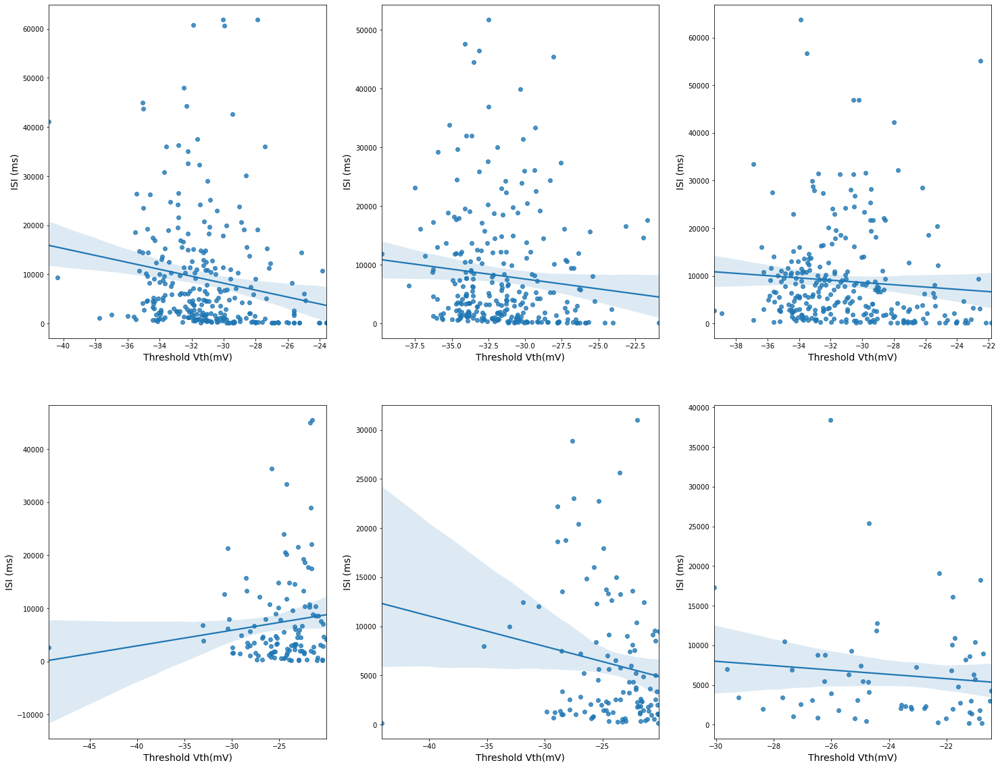

Copy of NC_171222_aCSF_D1ago_E2_analyzed.mat
('Excitatory', 'aCSF')
('Excitatory', 'aCSF')


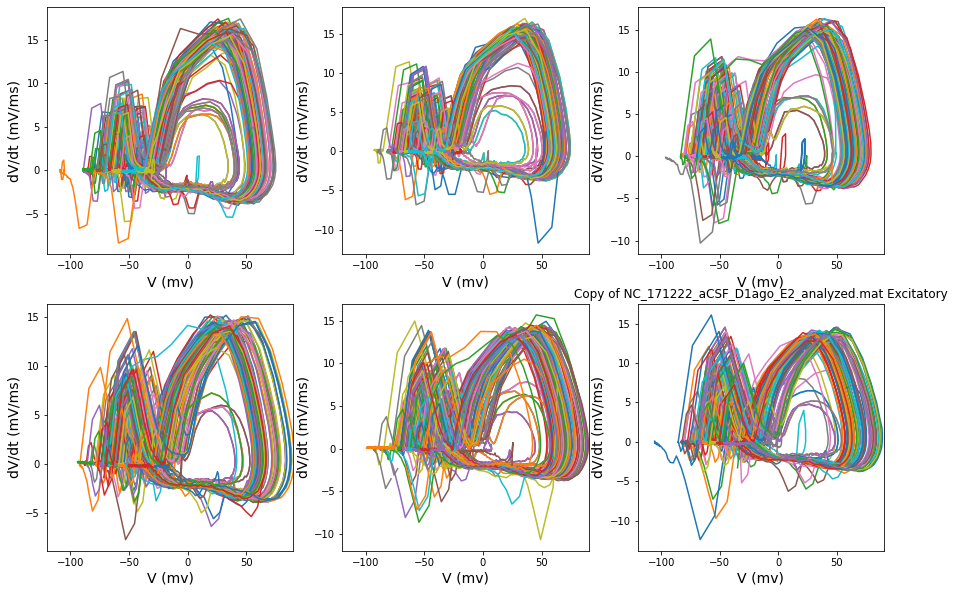

<ipython-input-14-f5b98abef153>:240: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:241: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be

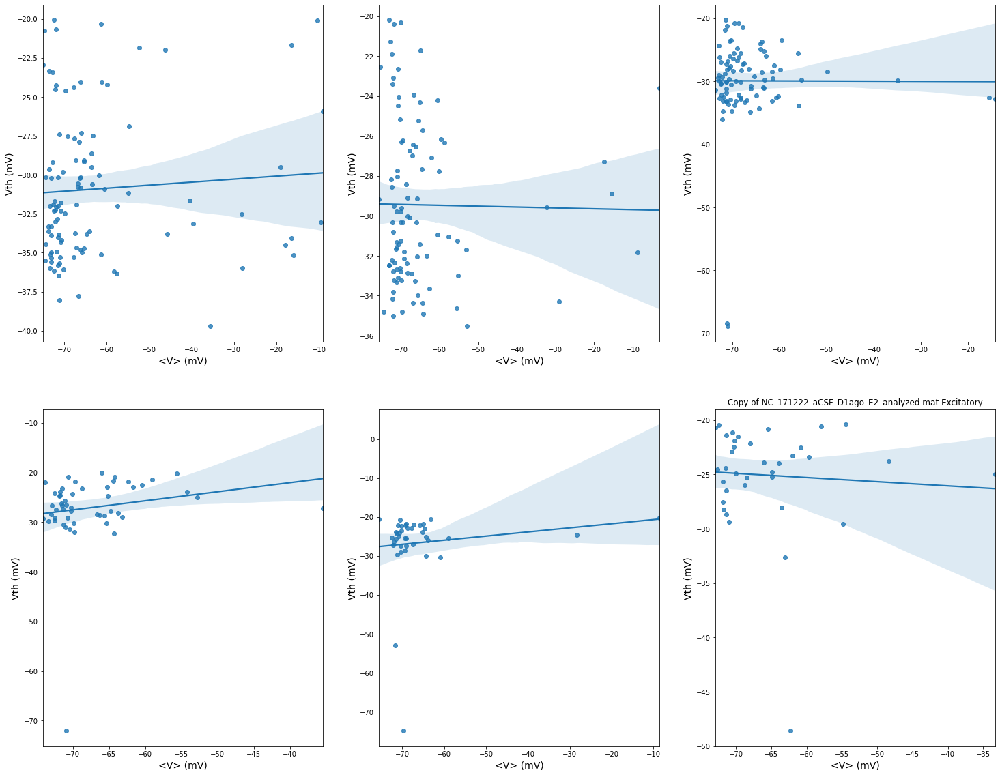

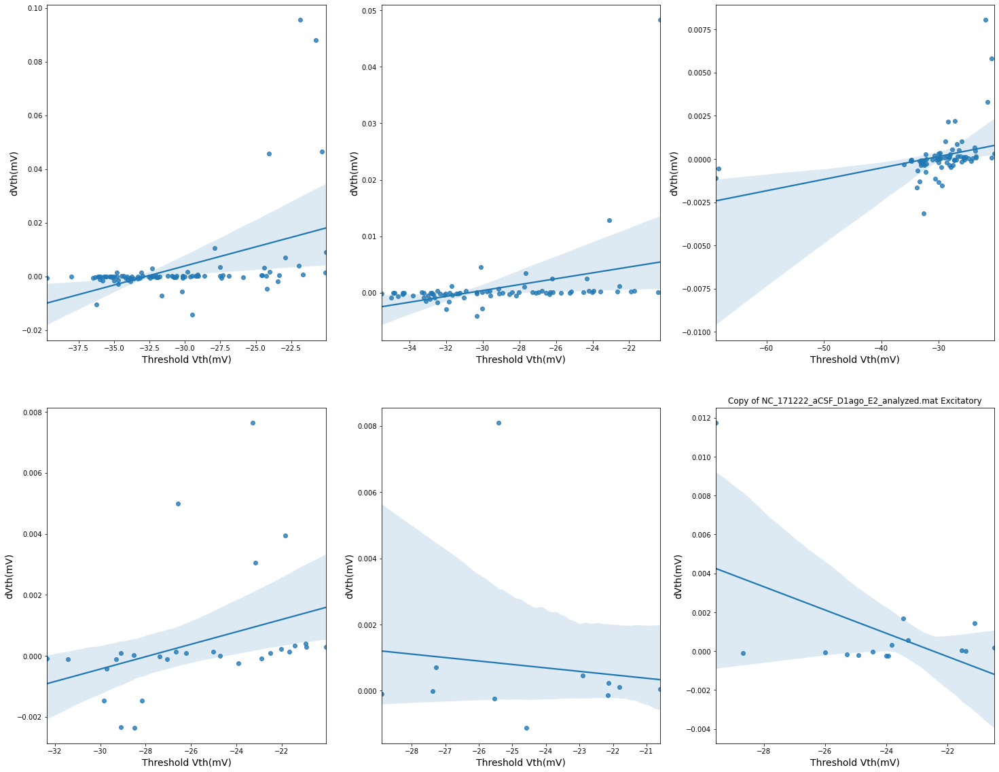

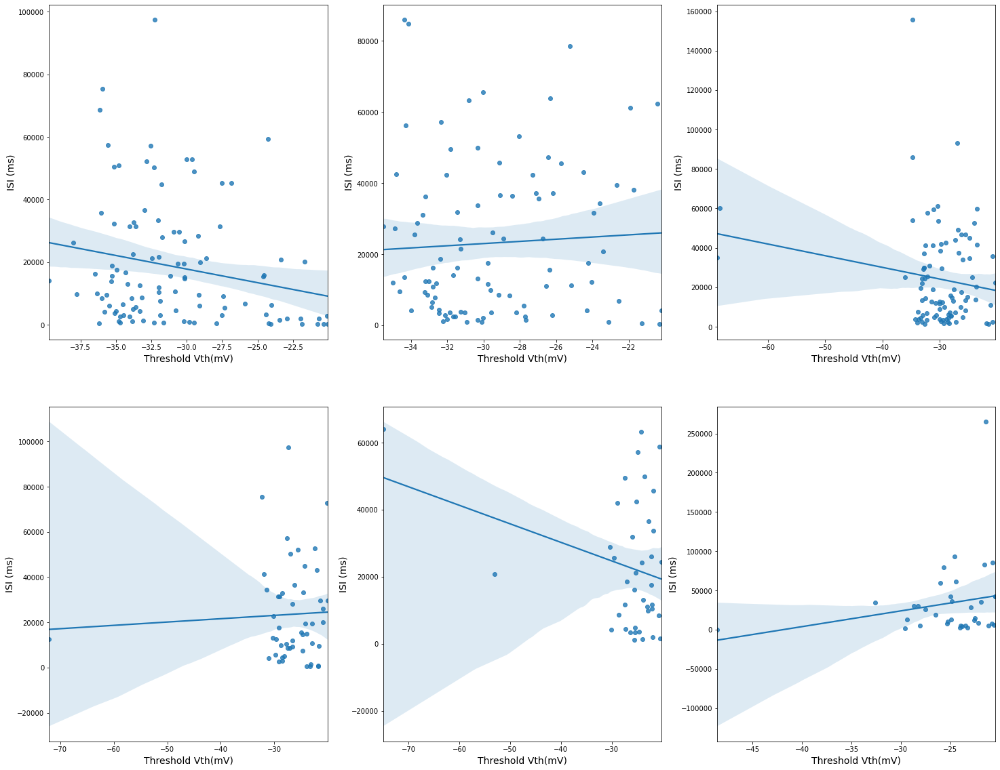

Copy of NC_171222_aCSF_D1ago_E3_analyzed.mat
('Excitatory', 'aCSF')
('Excitatory', 'aCSF')


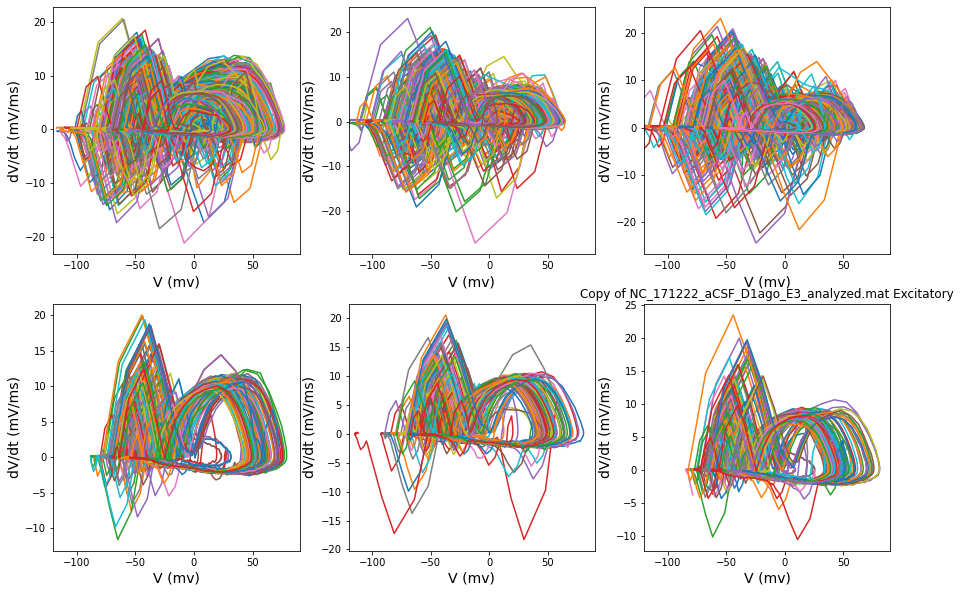

<ipython-input-14-f5b98abef153>:240: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:241: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
<ipython-input-14-f5b98abef153>:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be

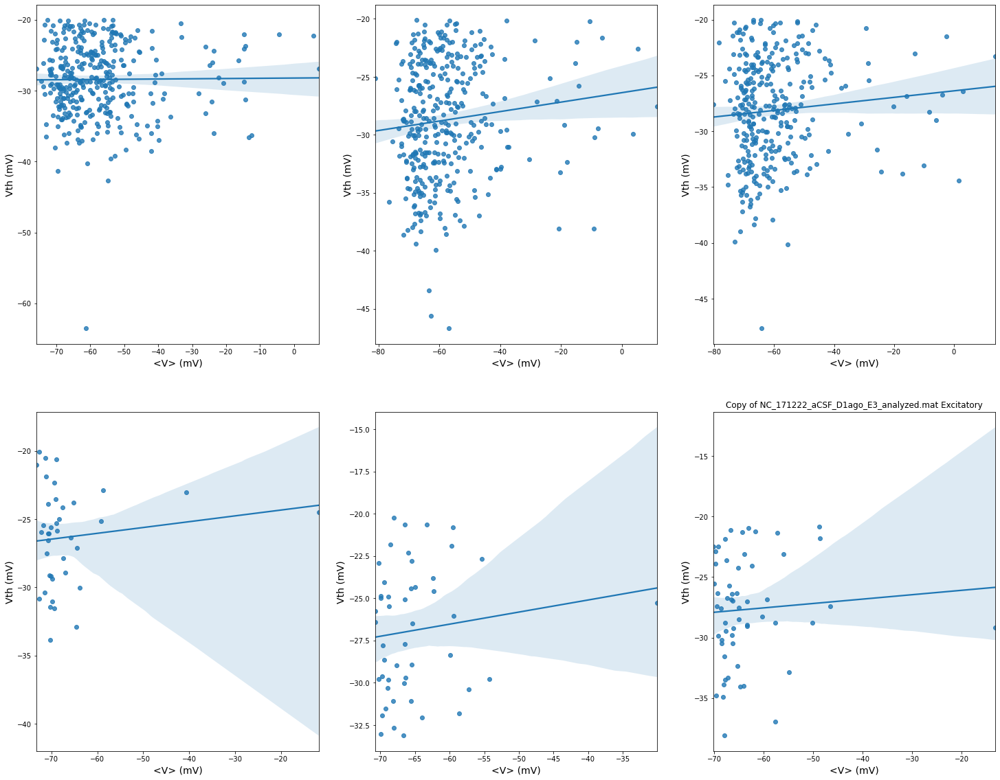

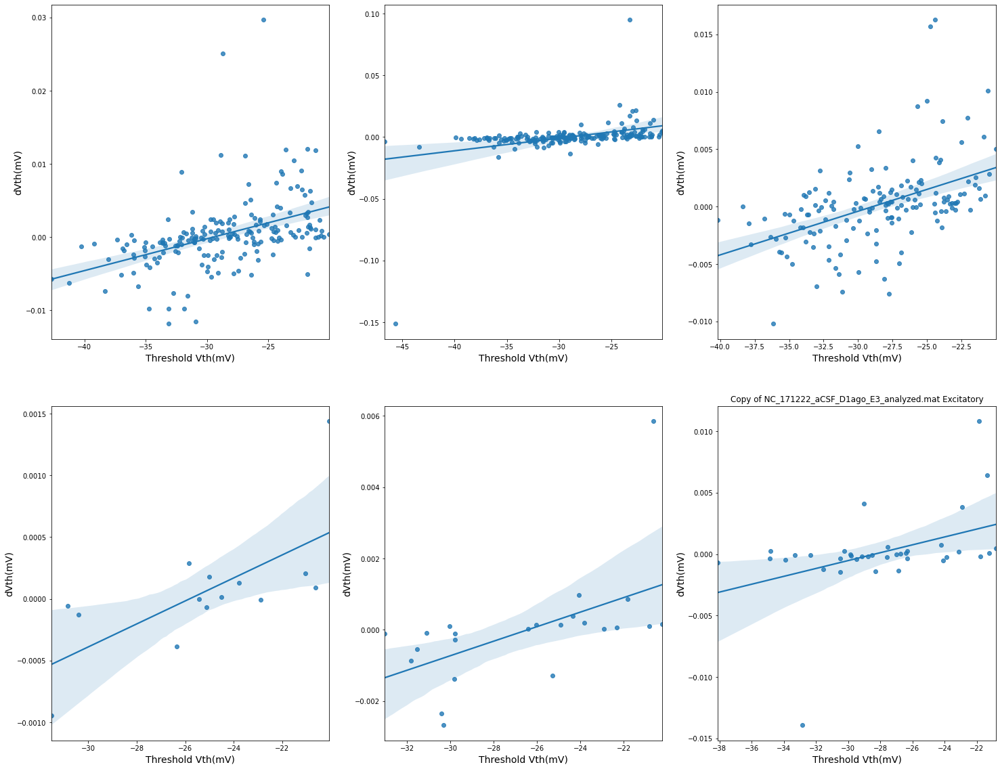

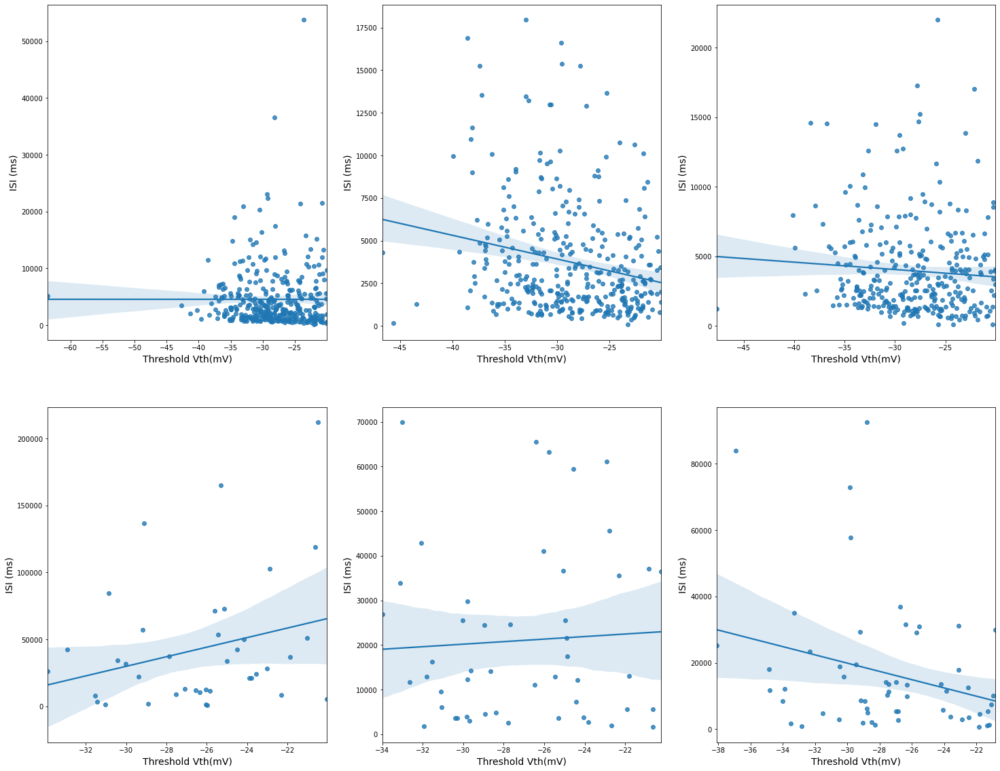

In [ ]:
#@title
listdir = os.listdir('C:/Users/Nishant Joshi/Google Drive/Analyzed/')
listdir=  ['Copy of NC_171010_aCSF_D1ago_E1_analyzed.mat',
                     'Copy of NC_171010_aCSF_D1ago_E3_analyzed.mat',
                     'Copy of NC_171010_aCSF_D1ago_E4_analyzed.mat',
                     'Copy of NC_171110_aCSF_D1ago_E1_analyzed.mat',
                     'Copy of NC_171110_aCSF_D1ago_E2_analyzed.mat',
                     'Copy of NC_171110_aCSF_D1ago_E3_analyzed.mat',
                     'Copy of NC_171207_aCSF_E1_analyzed.mat',
                     'Copy of NC_171207_aCSF_E3_analyzed.mat',
                     'Copy of NC_171207_aCSF_E4_analyzed.mat', 
                     'Copy of NC_171207_aCSF_E5_analyzed.mat',
                     'Copy of NC_171207_aCSF_E6_analyzed.mat', 
                     'Copy of NC_171211_aCSF_E2_analyzed.mat',
                     'Copy of NC_171222_aCSF_D1ago_E2_analyzed.mat', 
                     'Copy of NC_171222_aCSF_D1ago_E3_analyzed.mat']
for i in range(len(listdir)):
    analyze_single_cell(listdir[i])
#     analyze_single_cell('Copy of NC_171207_aCSF_E6_analyzed.mat')#listdir[i])


In [ ]:
# @title
a = ['171010_NC_126',
     '171010_NC_128',
     '171010_NC_129',
     '171110_NC_143',
     '171110_NC_144',
     '171110_NC_145',
     '171207_NC_146',
     '171207_NC_148',
     '171207_NC_149',
     '171207_NC_150',
     'NIL'
     '171211_NC_154',
     '171222_NC_161',
     '171222_NC_162']
path = 'C:/Users/Nishant Joshi/Google Drive/drive-download-20210929T052205Z-001/CC - Inhibitory/Analyzed/analyzed_CC_171110_NC_145_CC.mat'
data = loadmat_(path)#+'analyzed_CC_171110_NC_145_CC.mat')

# data = spio.loadmat(path, struct_as_record=False, squeeze_me=True)
# data = _todict(data) NC_171222_aCSF_D1ago_E2_analyzed
# print('_CC_' in path and 'analyzed' in path)
listdir=  ['Copy of NC_171010_aCSF_D1ago_E1_analyzed.mat',
            'Copy of NC_171010_aCSF_D1ago_E3_analyzed.mat',
            'Copy of NC_171010_aCSF_D1ago_E4_analyzed.mat',
            'Copy of NC_171110_aCSF_D1ago_E1_analyzed.mat',
            'Copy of NC_171110_aCSF_D1ago_E2_analyzed.mat',
            'Copy of NC_171110_aCSF_D1ago_E3_analyzed.mat',
            'Copy of NC_171207_aCSF_E1_analyzed.mat',
            'Copy of NC_171207_aCSF_E3_analyzed.mat',
            'Copy of NC_171207_aCSF_E4_analyzed.mat', 
            'Copy of NC_171207_aCSF_E5_analyzed.mat',
            'Copy of NC_171207_aCSF_E6_analyzed.mat', 
            'Copy of NC_171211_aCSF_E2_analyzed.mat',
            'Copy of NC_171222_aCSF_D1ago_E2_analyzed.mat', 
            'Copy of NC_171222_aCSF_D1ago_E3_analyzed.mat']

In [ ]:
#@title
# data  = loadmat_('C:/Users/Nishant Joshi/Google Drive/Analyzed/Copy of NC_170703_aCSF_D1ago_E1_analyzed.mat')
# print(data[0].keys())
# data[0]['Analysis']
def plot_cdf(data,ltype = 'line',c = None, ax=None):
  try:
    ind = ~np.isnan(data)
    data = data[ind]
    x = np.sort(data)
    y = 1. * np.arange(len(data)) / (len(data) - 1)
  except:
    x = np.sort(data)
    y = 1. * np.arange(len(data)) / (len(data) - 1)
  if ax!=None:
    if ltype == 'line':
      ax.plot(x,y,c=c)
    elif ltype == 'dashed':
      ax.plot(x,y,c=c,linestyle = 'dashed')
  else:
    if ltype == 'line':
      plt.plot(x,y,c=c)
    elif ltype == 'dashed':
      plt.plot(x,y,c=c,linestyle = 'dashed')

# plot_cdf(data[1]['thresholds'],ltype='dashed')

In [ ]:
#@title
acsf = ['asli_28-6-19_E2_analyzed.mat',
 'Copy of NC_170630_aCSF_D1ago_E4_analyzed.mat',
 'Copy of NC_170703_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_170711_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_170816_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_170821_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_170821_aCSF_D1ago_E2_analyzed.mat',
 'Copy of NC_170821_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_170830_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_170830_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_170830_aCSF_D1ago_E4_analyzed.mat',
 'Copy of NC_170913_aCSF_D1ago_E2_analyzed.mat',
 'Copy of NC_170914_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_171006_aCSF_D1ago_E7_analyzed.mat',
 'Copy of NC_171010_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_171010_aCSF_D1ago_E2_analyzed.mat',
 'Copy of NC_171010_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_171010_aCSF_D1ago_E4_analyzed.mat',
 'Copy of NC_171010_aCSF_D1ago_E5_analyzed.mat',
 'Copy of NC_171010_aCSF_D1ago_E6_analyzed.mat',
 'Copy of NC_171011_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_171011_aCSF_D1ago_E2_analyzed.mat',
 'Copy of NC_171011_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_171011_aCSF_D1ago_E4_analyzed.mat',
 'Copy of NC_171011_aCSF_D1ago_E5_analyzed.mat',
 'Copy of NC_171012_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_171012_aCSF_D1ago_E5_analyzed.mat',
 'Copy of NC_171012_aCSF_D1ago_E6_analyzed.mat',
 'Copy of NC_171012_aCSF_D1ago_E7_analyzed.mat',
 'Copy of NC_171012_aCSF_D1ago_E8_analyzed.mat',
 'Copy of NC_171012_aCSF_D1ago_E9_analyzed.mat',
 'Copy of NC_171017_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_171017_aCSF_D1ago_E2_analyzed.mat',
 'Copy of NC_171017_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_171017_aCSF_D1ago_E4_analyzed.mat',
 'Copy of NC_171017_aCSF_D1ago_E5_analyzed.mat',
 'Copy of NC_171110_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_171110_aCSF_D1ago_E2_analyzed.mat',
 'Copy of NC_171110_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_171207_aCSF_E1_analyzed.mat',
 'Copy of NC_171207_aCSF_E3_analyzed.mat',
 'Copy of NC_171207_aCSF_E4_analyzed.mat',
 'Copy of NC_171207_aCSF_E5_analyzed.mat',
 'Copy of NC_171207_aCSF_E6_analyzed.mat',
 'Copy of NC_171211_aCSF_E2_analyzed.mat',
 'Copy of NC_171222_aCSF_D1ago_E2_analyzed.mat',
 'Copy of NC_171222_aCSF_D1ago_E3_analyzed.mat',
 'Copy of xuan_10-10-18_E2_analyzed.mat',
 'Copy of xuan_14-1-19_E1_analyzed.mat',
 'Copy of xuan_14-1-19_E3_analyzed.mat',
 'Copy of xuan_14-3-19_E2_analyzed.mat',
 'Copy of xuan_14-3-19_E3_analyzed.mat',
 'Copy of xuan_3-4-19_E2_analyzed.mat',
 'Copy of xuan_6-3-19_E1_analyzed.mat',
 'Copy of xuan_6-3-19_E2_analyzed.mat',
 'Copy of xuan_7-3-19_E2_analyzed.mat',
 'Copy of xuan_7-3-19_E3_analyzed.mat',
 'Copy of xuan_8-1-19_E1_analyzed.mat',
 'Copy of xuan_8-1-19_E2_analyzed.mat',
 'Copy of xuan_8-1-19_E3_analyzed.mat',
 'Copy of xuan_9-1-19_E3_analyzed.mat',
 'Copy of xuan_9-1-19_E4_analyzed.mat',
 'NC_170615_aCSF_E1_analyzed.mat',
 'NC_170704_aCSF_D1ago_E2_analyzed.mat',
 'xuan_14-12-18_E1_analyzed.mat',
 'xuan_15-3-19_E1_analyzed.mat',
 'xuan_17-1-19_E2_analyzed.mat',
 'xuan_17-1-19_E3_analyzed.mat',
 'xuan_19-3-19_E1_analyzed.mat',
 'xuan_19-3-19_E4_analyzed.mat',
 'xuan_19-3-19_E5_analyzed.mat',
 'xuan_20-3-19_E3_analyzed.mat',
 'xuan_21-1-19_E1_analyzed.mat',
 'xuan_21-1-19_E2_analyzed.mat',
 'xuan_21-1-19_E5_analyzed.mat',
 'xuan_21-3-19_E1_analyzed.mat',
 'xuan_21-3-19_E3_analyzed.mat',
 'xuan_21-3-19_E4_analyzed.mat',
 'xuan_22-1-19_E1_analyzed.mat',
 'xuan_22-1-19_E2_analyzed.mat',
 'xuan_22-3-19_E1_analyzed.mat',
 'xuan_22-3-19_E2_analyzed.mat',
 'xuan_22-3-19_E3_analyzed.mat',
 'xuan_22-3-19_E4_analyzed.mat',
 'xuan_23-1-19_E1_analyzed.mat',
 'xuan_23-1-19_E2_analyzed.mat',
 'xuan_24-1-19_E2_analyzed.mat',
 'xuan_26-3-19_E2_analyzed.mat',
 'xuan_26-3-19_E4_analyzed.mat',
 'xuan_27-3-19_E2_analyzed.mat',
 'xuan_27-3-19_E4_analyzed.mat',
 'xuan_28-3-19_E2_analyzed.mat',
 'xuan_28-3-19_E3_analyzed.mat',
 'xuan_28-3-19_E4_analyzed.mat',
 'xuan_29-3-19_E1_analyzed.mat',
 'xuan_29-3-19_E2_analyzed.mat']
len(acsf)

96

In [ ]:
#@title

FI1_exc = []
firing_rate1_exc = []
thresholds_exc1 = []
isi_exc1 = []

FI2_exc = []
firing_rate2_exc = []
thresholds_exc2 = []  
isi_exc2 = []

FI3_exc = []
firing_rate3_exc = []  
FI4_exc = []
firing_rate4_exc = []  

FI1_inh = []
firing_rate1_inh = []
thresholds_inh1 = []
isi_inh1 = []
FI2_inh = []
firing_rate2_inh = []
thresholds_inh2 = []
isi_inh2 = []
FI3_inh = []
firing_rate3_inh = []
FI4_inh = []
firing_rate4_inh = []

path = 'C:/Users/Nishant Joshi/Google Drive/Analyzed/'
listdir = acsf# os.listdir(path)
for i in range(len(listdir)):

  data = loadmat_('C:/Users/Nishant Joshi/Google Drive/Analyzed/'+listdir[i])
  if data[0]['input_generation_settings']['tau'] == 250:
    for j in data:
        


        if j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==1:
            
            try:
              for m in range(len(j['firing_rate'])):
                firing_rate1_exc.append(j['firing_rate'][m])
            except:
                firing_rate1_exc.append(j['firing_rate'])
            try:
              for m in range(len(j['Analysis'])):
                FI1_exc.append(j['Analysis'][m]['FI'])
            except:
                FI1_exc.append(j['Analysis']['FI'])

            thresholds_exc1.append(j['thresholds'])
            isi = np.diff(j['spikeindices'])
            isi_exc1.append(isi)
  
        elif j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==2:

            try:
              for n in range(len(j['firing_rate'])):
                firing_rate2_exc.append(j['firing_rate'][n])
            except:
              firing_rate2_exc.append(j['firing_rate'])
            try:
              for n in range(len(j['Analysis'])):
                FI2_exc.append(j['Analysis'][n]['FI'])
            except:
              FI2_exc.append(j['Analysis']['FI'])

            thresholds_exc2.append(j['thresholds'])
            isi = np.diff(j['spikeindices'])
            isi_exc2.append(isi)

        elif j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==3:
          try:
            for l in range(len(j['firing_rate'])):
              firing_rate3_exc.append(j['firing_rate'][l])
              FI3_exc.append(j['Analysis'][l]['FI'])
          except:
            firing_rate3_exc.append(j['firing_rate'])
            FI3_exc.append(j['Analysis']['FI'])

        elif j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==4:
          try:
            for h in range(len(j['firing_rate'])):
              firing_rate2_exc.append(j['firing_rate'][h])
              FI2_exc.append(j['Analysis'][h]['FI'])
          except:
            firing_rate2_exc.append(j['firing_rate'])
            FI2_exc.append(j['Analysis']['FI'])

  if data[0]['input_generation_settings']['tau'] == 50:
    for j in data:
        if j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==1:
            try:
              for f in range(len(j['firing_rate'])):
                firing_rate1_inh.append(j['firing_rate'][f])
            except:
                firing_rate1_inh.append(j['firing_rate'])
            try:
              for f in range(len(j['Analysis'])):
                FI1_inh.append(j['Analysis'][f]['FI'])
            except:
              FI1_inh.append(j['Analysis']['FI'])

            thresholds_inh1.append(j['thresholds'])
            isi = np.diff(j['spikeindices'])
            isi_inh1.append(isi)

        elif j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==2:
            try:
              for r in range(len(j['firing_rate'])):                
                firing_rate2_inh.append(j['firing_rate'][r])
            except:
              firing_rate2_inh.append(j['firing_rate'])
            try:
              for r in range(len(j['Analysis'])):                
                FI2_inh.append(j['Analysis'][r]['FI'])
            except:
              FI2_inh.append(j['Analysis']['FI'])

            thresholds_inh2.append(j['thresholds'])
            isi = np.diff(j['spikeindices'])
            isi_inh2.append(isi)

        elif j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==3:
          try:
            for g in range(len(j['firing_rate'])):
              firing_rate3_inh.append(j['firing_rate'][g])
              FI3_inh.append(j['Analysis'][g]['FI'])
          except:
              firing_rate3_inh.append(j['firing_rate'])
              FI3_inh.append(j['Analysis']['FI'])

        elif j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==4:
          try:
            for d in range(len(j['firing_rate'])):
              firing_rate4_inh.append(j['firing_rate'][d])
              FI4_inh.append(j['Analysis'][d]['FI'])
          except:
            firing_rate4_inh.append(j['firing_rate'])
            FI4_inh.append(j['Analysis']['FI'])


#Figure for Information v Firing rate between multiple aCSF trials  

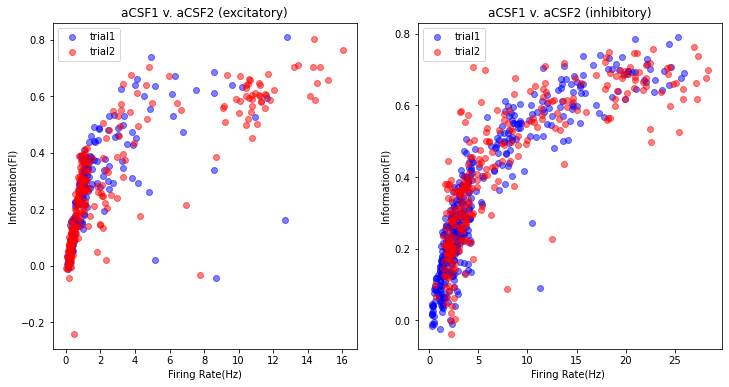

In [ ]:
#@title
fig,ax = plt.subplots(1,2,figsize=[12,6])

ax[0].scatter(firing_rate1_exc,FI1_exc,c='blue',alpha=0.5)
ax[0].scatter(firing_rate2_exc,FI2_exc,c='red',alpha=0.5)  
 
ax[0].set_ylabel('Information(FI)')
ax[0].set_xlabel('Firing Rate(Hz)')
ax[0].legend(['trial1','trial2'])
ax[0].set_title('aCSF1 v. aCSF2 (excitatory)')
# plt.show()

ax[1].scatter(firing_rate1_inh,FI1_inh,c='blue',alpha=0.5)
ax[1].scatter(firing_rate2_inh,FI2_inh,c='red',alpha=0.5)  

ax[1].set_xlabel('Firing Rate(Hz) ')
ax[1].set_ylabel('Information(FI)')
ax[1].set_title('aCSF1 v. aCSF2 (inhibitory)')
ax[1].legend(['trial1','trial2'])
# plt.show()
f = open('C:/Users/Nishant Joshi/Downloads/fi_fr.pdf' ,mode='wb')
plt.savefig(f, dpi=100,format='pdf')

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\axisgrid.py:1668: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\axisgrid.py:1668: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations


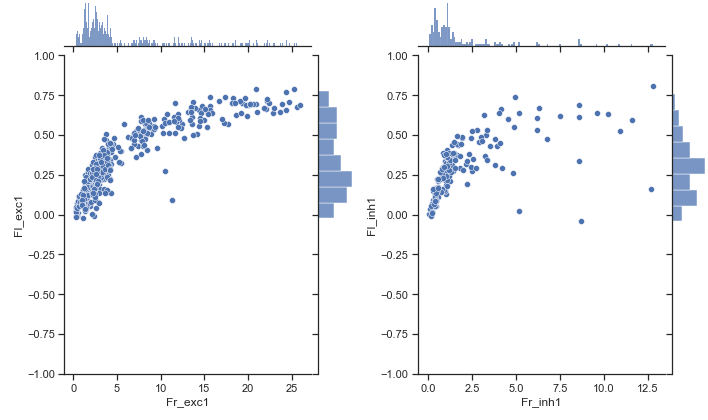

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\axisgrid.py:1668: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\axisgrid.py:1668: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations


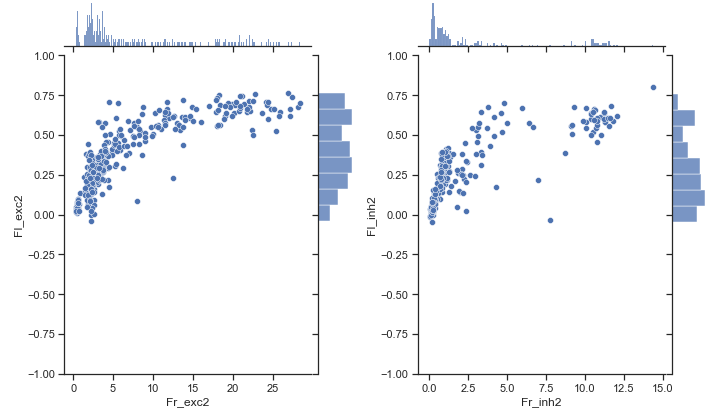

In [ ]:
#@title
import matplotlib.gridspec as gridspec
class SeabornFig2Grid():

 def __init__(self, seaborngrid, fig,  subplot_spec):
     self.fig = fig
     self.sg = seaborngrid
     self.subplot = subplot_spec
     if isinstance(self.sg, sns.axisgrid.FacetGrid) or \
         isinstance(self.sg, sns.axisgrid.PairGrid):
         self._movegrid()
     elif isinstance(self.sg, sns.axisgrid.JointGrid):
         self._movejointgrid()
     self._finalize()

 def _movegrid(self):
     """ Move PairGrid or Facetgrid """
     self._resize()
     n = self.sg.axes.shape[0]
     m = self.sg.axes.shape[1]
     self.subgrid = gridspec.GridSpecFromSubplotSpec(n,m, subplot_spec=self.subplot)
     for i in range(n):
         for j in range(m):
             self._moveaxes(self.sg.axes[i,j], self.subgrid[i,j])

 def _movejointgrid(self):
     """ Move Jointgrid """
     h= self.sg.ax_joint.get_position().height
     h2= self.sg.ax_marg_x.get_position().height
     r = int(np.round(h/h2))
     self._resize()
     self.subgrid = gridspec.GridSpecFromSubplotSpec(r+1,r+1, subplot_spec=self.subplot)

     self._moveaxes(self.sg.ax_joint, self.subgrid[1:, :-1])
     self._moveaxes(self.sg.ax_marg_x, self.subgrid[0, :-1])
     self._moveaxes(self.sg.ax_marg_y, self.subgrid[1:, -1])

 def _moveaxes(self, ax, gs):
     #https://stackoverflow.com/a/46906599/4124317
     ax.remove()
     ax.figure=self.fig
     self.fig.axes.append(ax)
     self.fig.add_axes(ax)
     ax._subplotspec = gs
     ax.set_position(gs.get_position(self.fig))
     ax.set_subplotspec(gs)

 def _finalize(self):
     plt.close(self.sg.fig)
     self.fig.canvas.mpl_connect("resize_event", self._resize)
     self.fig.canvas.draw()

 def _resize(self, evt=None):
     self.sg.fig.set_size_inches(self.fig.get_size_inches())

%matplotlib inline
plt.style.use('ggplot')

sns.set_theme(style="ticks")

df = pd.DataFrame({'Fr_exc1':firing_rate1_exc,'FI_exc1':FI1_exc})
g1 = sns.jointplot( data = df,x='Fr_exc1', y='FI_exc1',height=2,ratio=5,marginal_kws={'binwidth':0.1,'fill':True},ylim=[-1,1])

df2 = pd.DataFrame({'Fr_inh1':firing_rate1_inh,'FI_inh1':FI1_inh})
g2 = sns.jointplot( data = df2,x='Fr_inh1', y='FI_inh1',height=2,ratio=5,marginal_kws={'binwidth':0.1,'fill':True},ylim=[-1,1])


fig = plt.figure(figsize=(10,6))

gs = gridspec.GridSpec(1,2)

SeabornFig2Grid(g1, fig, gs[0])
SeabornFig2Grid(g2, fig, gs[1])
gs.tight_layout(fig)

plt.show()

df_exc = pd.DataFrame({'Fr_exc2':firing_rate2_exc,'FI_exc2':FI2_exc})
g1 = sns.jointplot( data = df_exc,x='Fr_exc2', y='FI_exc2',height=2,ratio=5,marginal_kws={'binwidth':0.1,'fill':True},ylim=[-1,1])


df2_inh = pd.DataFrame({'Fr_inh2':firing_rate2_inh,'FI_inh2':FI2_inh})
g2 = sns.jointplot( data = df2_inh,x='Fr_inh2', y='FI_inh2',height=2,ratio=5,marginal_kws={'binwidth':0.1,'fill':True},ylim=[-1,1])
fig = plt.figure(figsize=(10,6))

gs = gridspec.GridSpec(1,2)

SeabornFig2Grid(g1, fig, gs[0])
SeabornFig2Grid(g2, fig, gs[1])
gs.tight_layout(fig)

plt.show()

#Figure D, E and G from the Dopamine Paper

In [ ]:
#@title
  
def concat_plot( b,plt_type = 'cum',ltype='solid',isi = False,ax=None,c=None):
  
  def plot_cdf(data,c=c,ltype = 'line',ax=None):
    try:
      ind = ~np.isnan(data)
      data = data[ind]
      x = np.sort(data)
      y = 1. * np.arange(len(data)) / (len(data) - 1)
    except:
      x = np.sort(data)
      y = 1. * np.arange(len(data)) / (len(data) - 1)
    if ax!=None:
      if ltype == 'solid':
        ax.plot(x,y,c=c)
      elif ltype == 'dashed':
        ax.plot(x,y,c=c,linestyle = 'dashed')
    else:
      if ltype == 'solid':
        plt.plot(x,y,c=c)
      elif ltype == 'dashed':
        plt.plot(x,y,c=c,linestyle = 'dashed')

  a = []
  for i in b:
    a = np.concatenate((a,i))
  if plt_type =='cum':
    if ax !=None:
      if isi == True:
        plot_cdf(np.log(a),ltype=ltype,c=c,ax=ax)
      else:
        plot_cdf(a,ltype=ltype,c=c,ax=ax)
    else:
      if isi == True:
        plot_cdf(np.log(a),ltype=ltype)
      else:
        plot_cdf(a,c=c,ltype=ltype)
  elif plt_type =='dist' and ltype !='solid':
    if ax!=None:
      if isi==True :
        sns.histplot(a,c=c,kde=True,line_kws={'linestyle':ltype},ax=ax,**{'linestyle':ltype})
      else:
        sns.histplot(a,ax=ax,c=c,line_kws={'linestyle':ltype},kde=True,**{'linestyle':ltype})
    
    else:
      if isi==True:
        sns.histplot(a,kde=True,c=c,line_kws={'linestyle':ltype},**{'linestyle':ltype})
      else:
        sns.histplot(a,kde=True,c=c,line_kws={'linestyle':ltype},**{'linestyle':ltype})

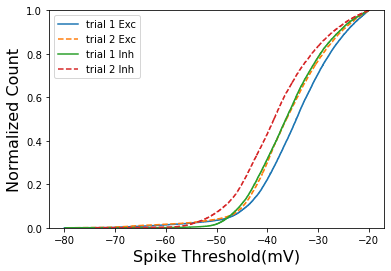

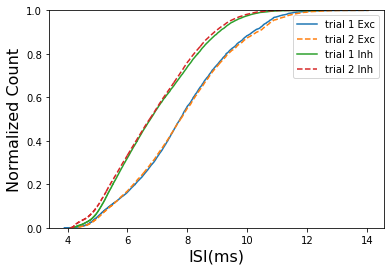

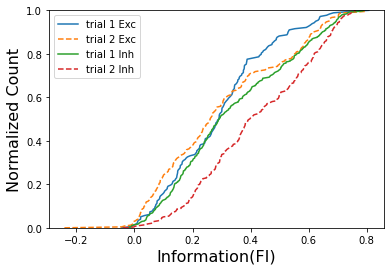

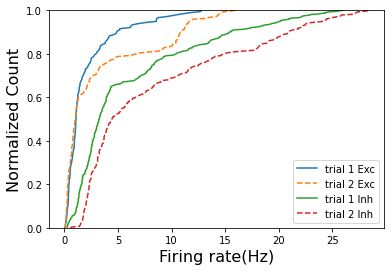

In [ ]:
#@title

concat_plot(thresholds_exc1)
concat_plot(thresholds_exc2,ltype='dashed')
concat_plot(thresholds_inh1)
concat_plot(thresholds_inh2,ltype='dashed') 
plt.xlabel('Spike Threshold(mV)',fontsize=16)
plt.ylabel('Normalized Count',fontsize=16)
plt.legend(['trial 1 Exc','trial 2 Exc','trial 1 Inh','trial 2 Inh'])
plt.ylim(0,1)
plt.show()
concat_plot(isi_exc1,isi=True)
concat_plot(isi_exc2,ltype='dashed',isi=True)
concat_plot(isi_inh1,isi=True)
concat_plot(isi_inh2,ltype='dashed',isi=True) 
plt.legend(['trial 1 Exc','trial 2 Exc','trial 1 Inh','trial 2 Inh'])
plt.xlabel('ISI(ms)',fontsize=16)
plt.ylim(0,1)
plt.ylabel('Normalized Count',fontsize=16)
plt.show()
plot_cdf(FI1_exc)
plot_cdf(FI2_exc,ltype='dashed')
plot_cdf(FI1_inh)
plot_cdf(FI2_inh,ltype='dashed')
plt.xlabel('Information(FI)',fontsize=16)
plt.ylabel('Normalized Count',fontsize=16)
plt.ylim(0,1)
plt.legend(['trial 1 Exc','trial 2 Exc','trial 1 Inh','trial 2 Inh'])
plt.show()
plot_cdf(firing_rate1_exc)
plot_cdf(firing_rate2_exc,ltype='dashed')
plot_cdf(firing_rate1_inh)
plot_cdf(firing_rate2_inh,ltype='dashed')
plt.xlabel('Firing rate(Hz)',fontsize=16)
plt.ylabel('Normalized Count',fontsize=16)
plt.ylim(0,1)
plt.legend(['trial 1 Exc','trial 2 Exc','trial 1 Inh','trial 2 Inh'])
plt.show()


In [ ]:
#@title
def join_cond(path, savename, lis_cond = None):
  # joins condition information together  
  path = 'C:/Users/Nishant Joshi/Downloads/all_files.csv'
  # f=filesep
  # savefile = [path f savesame]
  table = pd.read_csv(path)
  cond= np.sort(np.unique(table['condition']))
  temp = []
  if len(lis_cond)>1:
    for i in lis_cond:
      temp.append(table.groupby('condition').get_group(i))
    new_df = temp[0]
    for j in range(1,len(temp)):
      new_df = pd.concat([new_df,temp[j]])
  else:
    new_df = table.groupby('condition').get_group(lis_cond[0])
  return new_df
def plot_cdf(data,c=None,ltype = 'line',ax=None):
  try:
    ind = ~np.isnan(data)
    data = data[ind]
    x = np.sort(data)
    y = 1. * np.arange(len(data)) / (len(data) - 1)
  except:
    x = np.sort(data)
    y = 1. * np.arange(len(data)) / (len(data) - 1)
  if ax!=None:
    if ltype == 'solid':
      ax.plot(x,y,c=c)
    elif ltype == 'dashed':
      ax.plot(x,y,c=c,linestyle = 'dashed')
  else:
    if ltype == 'solid':
      plt.plot(x,y,c=c)
    elif ltype == 'dashed':
      plt.plot(x,y,c=c,linestyle = 'dashed')

def accumulate_vals(cond_arr ):
  # This fucntion accumulates all the inhibitory and excitatory values from cell recordings. Depending on the condition. 
  # It needs 
  try: 
      assert type(cond_arr)==list
      cond = cond_arr
      df = join_cond(cond)
      isi_acsf_exc = []
      isi_sag_exc = []
      isi_acsf_inh = []
      isi_sag_inh = []

      FI_acsf_exc = []
      FI_sag_exc = []
      FI_acsf_inh = []
      FI_sag_inh = []

      Vth_acsf_exc = []
      Vth_sag_exc = []
      Vth_acsf_inh = []
      Vth_sag_inh = []

      fr_acsf_exc = []
      fr_sag_exc = []
      fr_acsf_inh = []
      fr_sag_inh = []
      path = 'C:/Users/Nishant Joshi/Google Drive/Analyzed/'

      for i in range(len(list(df['experimentname']))):
        data = loadmat_(path+list(df['filename'])[i])
        tau_ = list(df['tau'])
        for j in data:
          if tau_[i] == 250 and j['input_generation_settings']['condition'].lower()=='acsf':
            try:
              for r in range(len(j['firing_rate'])):                
                fr_acsf_exc.append(j['firing_rate'][r])
            except:
              fr_acsf_exc.append(j['firing_rate'])
            try:
              for r in range(len(j['Analysis'])):                
                FI_acsf_exc.append(j['Analysis'][r]['FI'])
            except:
              FI_acsf_exc.append(j['Analysis']['FI'])

            Vth_acsf_exc.append(j['thresholds'])
            isi = np.diff(j['spikeindices'])
            isi_acsf_exc.append(isi)
          elif tau_[i] == 250 and j['input_generation_settings']['condition'] in cond:
            try:
              for r in range(len(j['firing_rate'])):                
                fr_sag_exc.append(j['firing_rate'][r])
            except:
              fr_sag_exc.append(j['firing_rate'])
            try:
              for r in range(len(j['Analysis'])):                
                FI_sag_exc.append(j['Analysis'][r]['FI'])
            except:
              FI_sag_exc.append(j['Analysis']['FI'])

            Vth_sag_exc.append(j['thresholds'])
            isi = np.diff(j['spikeindices'])
            isi_sag_exc.append(isi)
          elif tau_[i] == 50 and j['input_generation_settings']['condition'].lower()=='acsf':
            try:
              for r in range(len(j['firing_rate'])):                
                fr_acsf_inh.append(j['firing_rate'][r])
            except:
              fr_acsf_inh.append(j['firing_rate'])
            try:
              for r in range(len(j['Analysis'])):                
                FI_acsf_inh.append(j['Analysis'][r]['FI'])
            except:
              FI_acsf_inh.append(j['Analysis']['FI'])

            Vth_acsf_inh.append(j['thresholds'])
            isi = np.diff(j['spikeindices'])
            isi_acsf_inh.append(isi)
          elif tau_[i] == 50 and j['input_generation_settings']['condition'] in cond:
            try:
              for r in range(len(j['firing_rate'])):                
                fr_sag_inh.append(j['firing_rate'][r])
            except:
              fr_sag_inh.append(j['firing_rate'])
            try:
              for r in range(len(j['Analysis'])):                
                FI_sag_inh.append(j['Analysis'][r]['FI'])
            except:
              FI_sag_inh.append(j['Analysis']['FI'])

            Vth_sag_inh.append(j['thresholds'])
            isi = np.diff(j['spikeindices'])
            isi_sag_inh.append(isi)
      return {'isi':  [isi_acsf_exc,isi_sag_exc,isi_acsf_inh ,isi_sag_inh]  ,'FI':[FI_acsf_exc, FI_sag_exc, FI_acsf_inh, FI_sag_inh ], 'Vth': [Vth_acsf_exc, Vth_sag_exc, Vth_acsf_inh, Vth_sag_inh ], 'fr':[fr_acsf_exc ,fr_sag_exc,fr_acsf_inh,fr_sag_inh ]}
  except:
    raise Exception('Need a list')     

In [ ]:
arr_sag = accumulate_vals(['sag'])


here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]


In [ ]:
arr1= accumulate_vals(['D1ago'])
ISI = arr1['isi']
FI  = arr1['FI']
Vth = arr1['Vth']
FR  = arr1['Vth']


here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
here 1 %d %d ['acsf', 250]
h

In [ ]:
arr_dop = arr1

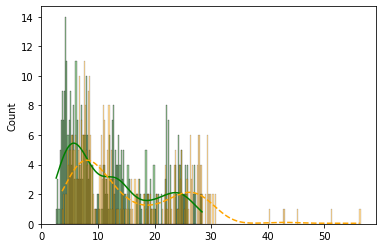

In [ ]:

ax1 = plt.subplot()
# sns.histplot(arr1['fr'][0],stat='count',kde=True,ax=ax1 ,color='red',alpha=0.4,binwidth=0.2)
# sns.histplot(arr1['fr'][1],stat='count',kde=True,line_kws={'linestyle':'dashed'},ax=ax1,color='blue',alpha=0.4,binwidth=0.2)
sns.histplot(arr1['fr'][2],stat='count',kde=True,ax=ax1,color='green',alpha=0.4,binwidth=0.2)
sns.histplot(arr1['fr'][3],stat='count',kde=True,line_kws={'linestyle':'dashed'},ax=ax1,color='orange',alpha=0.4,binwidth=0.2) 
plt.show()


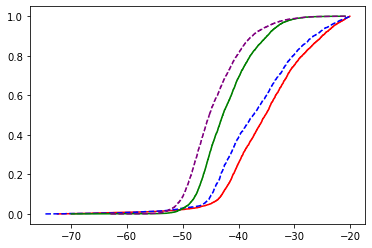

In [ ]:
ax_ = plt.subplot()

plot_cdf(unfold(arr1['Vth'][0]),c='red'  ,ax=ax_)
plot_cdf(unfold(arr1['Vth'][1]),c='blue' ,ltype='dashed',ax=ax_)
plot_cdf(unfold(arr1['Vth'][2]),c='green',ax=ax_)
plot_cdf(unfold(arr1['Vth'][3]),c='purple',ltype='dashed',ax=ax_) 
plt.show()



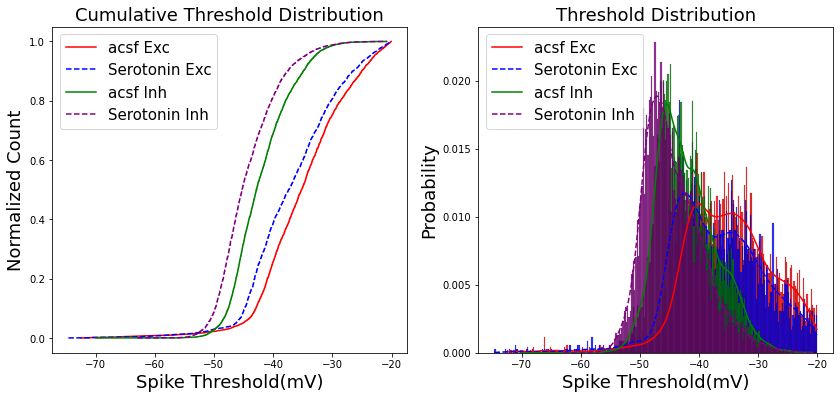

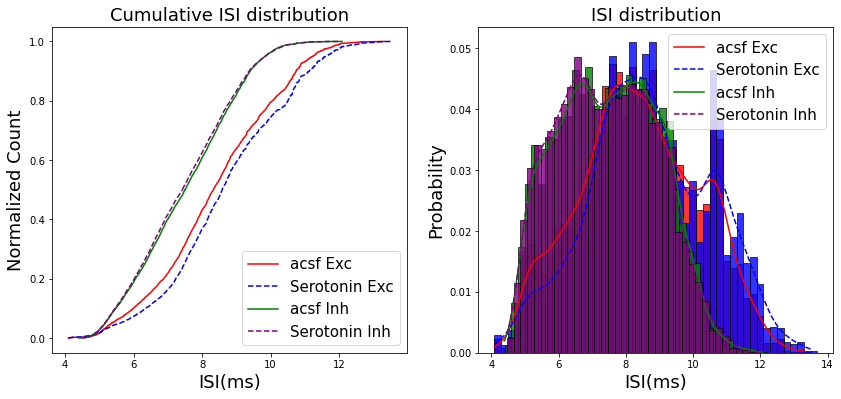

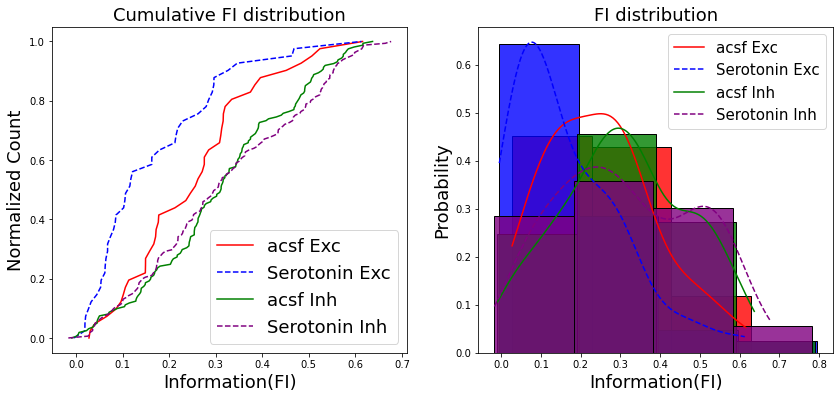

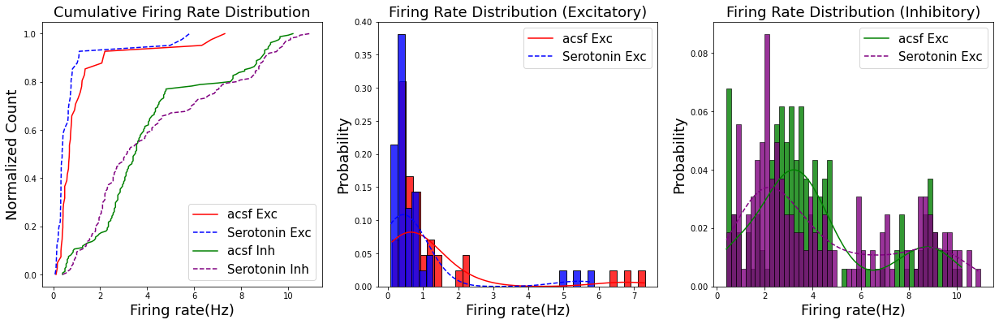

In [ ]:
#@title
fig1,ax_th = plt.subplots(1,2,figsize=[14,6])


def unfold(a):

  a_ = []
  for i in a:
    a_ = np.concatenate((a_,i))

  ind = ~np.isnan(a_)
  a_ = a_[ind] 
  return a_
arr1 = arr_sag
plot_cdf(unfold(arr1['Vth'][0]),c='red'  ,ax=ax_th[0])
plot_cdf(unfold(arr1['Vth'][1]),c='blue' ,ltype='dashed',ax=ax_th[0])
plot_cdf(unfold(arr1['Vth'][2]),c='green',ax=ax_th[0])
plot_cdf(unfold(arr1['Vth'][3]),c='purple',ltype='dashed',ax=ax_th[0]) 
ax_th[0].set_xlabel('Spike Threshold(mV)',fontsize = 18)
ax_th[0].set_ylabel('Normalized Count',fontsize = 18)
# ax_th[0].legend(['acsf Exc','D1ago Exc','acsf Inh','D1ago Inh'],fontsize = 15)
ax_th[0].legend(['acsf Exc','Serotonin Exc','acsf Inh','Serotonin Inh'],fontsize = 15)

ax_th[0].set_title('Cumulative Threshold Distribution',fontsize = 18)
# plt.ylim(0,1)
sns.histplot(unfold(arr1['Vth'][0]),stat='probability',kde=True,ax=ax_th[1] ,color='red',alpha=0.8,binwidth=0.2)
sns.histplot(unfold(arr1['Vth'][1]),stat='probability',kde=True,line_kws={'linestyle':'dashed'},ax=ax_th[1],color='blue',alpha=0.8,binwidth=0.2)

sns.histplot(unfold(arr1['Vth'][2]),stat='probability',kde=True,ax=ax_th[1],color='green',alpha=0.8,binwidth=0.2)
sns.histplot(unfold(arr1['Vth'][3]),stat='probability',kde=True,line_kws={'linestyle':'dashed'},ax=ax_th[1],color='purple',alpha=0.8,binwidth=0.2) 
ax_th[1].set_xlabel('Spike Threshold(mV)',fontsize = 18)
ax_th[1].set_ylabel('Probability',fontsize = 18)
# ax_th[1].legend(['acsf Exc','D1ago Exc','acsf Inh','D1ago Inh'],fontsize = 15)
ax_th[1].legend(['acsf Exc','Serotonin Exc','acsf Inh','Serotonin Inh'],fontsize = 15)

ax_th[1].set_title('Threshold Distribution',fontsize = 18)
plt.show()

fig2,ax_isi = plt.subplots(1,2,figsize=[14,6])

plot_cdf(np.log(unfold(arr1['isi'][0])),c='red'  ,ax=ax_isi[0] )
plot_cdf(np.log(unfold(arr1['isi'][1])),c='blue' ,ltype='dashed',ax=ax_isi[0] )
plot_cdf(np.log(unfold(arr1['isi'][2])),c='green',ax=ax_isi[0] )
plot_cdf(np.log(unfold(arr1['isi'][3])),c='purple',ltype='dashed',ax=ax_isi[0] ) 
ax_isi[0].set_xlabel('ISI(ms)',fontsize = 18)
ax_isi[0].set_ylabel('Normalized Count',fontsize = 18)
# ax_isi[0].legend(['acsf Exc','D1ago Exc','acsf Inh','D1ago Inh'],fontsize = 15)
ax_isi[0].legend(['acsf Exc','Serotonin Exc','acsf Inh','Serotonin Inh'],fontsize = 15)

ax_isi[0].set_title('Cumulative ISI distribution',fontsize = 18)

sns.histplot(np.log(unfold(arr1['isi'][0])),stat='probability',kde=True,ax=ax_isi[1] ,color='red',alpha=0.8,binwidth=0.2)
sns.histplot(np.log(unfold(arr1['isi'][1])),stat='probability',kde=True,line_kws={'linestyle':'dashed'},ax=ax_isi[1],color='blue',alpha=0.8,binwidth=0.2)
sns.histplot(np.log(unfold(arr1['isi'][2])),stat='probability',kde=True,ax=ax_isi[1],color='green',alpha=0.8,binwidth=0.2)
sns.histplot(np.log(unfold(arr1['isi'][3])),stat='probability',kde=True,line_kws={'linestyle':'dashed'},ax=ax_isi[1],color='purple',alpha=0.8,binwidth=0.2) 
plt.legend(['acsf Exc','D1ago Exc','acsf Inh','D1ago Inh'])
ax_isi[1].set_xlabel('ISI(ms)',fontsize = 18)
ax_isi[1].set_ylabel('Probability',fontsize = 18)
# ax_isi[1].legend(['acsf Exc','D1ago Exc','acsf Inh','D1ago Inh'],fontsize = 15)
ax_isi[1].legend(['acsf Exc','Serotonin Exc','acsf Inh','Serotonin Inh'],fontsize = 15)

ax_isi[1].set_title('ISI distribution',fontsize = 18)
plt.show()

fig3,ax_FI = plt.subplots(1,2,figsize=[14,6])
plot_cdf(arr1['FI'][0],c='red'  ,ax=ax_FI[0])
plot_cdf(arr1['FI'][1],c='blue' ,ax=ax_FI[0],ltype='dashed')
plot_cdf(arr1['FI'][2],c='green',ax=ax_FI[0])
plot_cdf(arr1['FI'][3],c='purple',ax=ax_FI[0],ltype='dashed')
ax_FI[0].set_xlabel('Information(FI)',fontsize = 18)
ax_FI[0].set_ylabel('Normalized Count',fontsize = 18)
# ax_FI[0].legend(['acsf Exc','D1ago Exc','acsf Inh','D1ago Inh'],fontsize = 18)
ax_FI[0].legend(['acsf Exc','Serotonin Exc','acsf Inh','Serotonin Inh'],fontsize = 18)

ax_FI[0].set_title('Cumulative FI distribution',fontsize = 18)
# plt.ylim(0,1)
sns.histplot(arr1['FI'][0],stat='probability',kde=True,ax=ax_FI[1] ,color='red',alpha=0.8,binwidth=0.2)
sns.histplot(arr1['FI'][1],stat='probability',kde=True,line_kws={'linestyle':'dashed'},ax=ax_FI[1],color='blue',alpha=0.8,binwidth=0.2)

sns.histplot(arr1['FI'][2],stat='probability',kde=True,ax=ax_FI[1],color='green',alpha=0.8,binwidth=0.2)
sns.histplot(arr1['FI'][3],stat='probability',kde=True,line_kws={'linestyle':'dashed'},ax=ax_FI[1],color='purple',alpha=0.8,binwidth=0.2) 
ax_FI[1].set_xlabel('Information(FI)',fontsize = 18)
ax_FI[1].set_ylabel('Probability',fontsize = 18)
# ax_FI[1].legend(['acsf Exc','D1ago Exc','acsf Inh','D1ago Inh'],fontsize = 15)
ax_FI[1].legend(['acsf Exc','Serotonin Exc','acsf Inh','Serotonin Inh'],fontsize = 15)

ax_FI[1].set_title('FI distribution',fontsize = 18)
plt.show()
fig4,ax_FR = plt.subplots(1,3,figsize=[21,6])


plot_cdf(arr1['fr'][0],c='red'  ,ax=ax_FR[0])
plot_cdf(arr1['fr'][1],c='blue' ,ltype='dashed',ax=ax_FR[0])
plot_cdf(arr1['fr'][2],c='green',ax=ax_FR[0])
plot_cdf(arr1['fr'][3],c='purple',ltype='dashed',ax=ax_FR[0])
ax_FR[0].set_xlabel('Firing rate(Hz)',fontsize = 18)
ax_FR[0].set_ylabel('Normalized Count',fontsize = 18)
# ax_FR[0].legend(['acsf Exc','D1ago Exc','acsf Inh','D1ago Inh'],fontsize = 15)
ax_FR[0].legend(['acsf Exc','Serotonin Exc','acsf Inh','Serotonin Inh'],fontsize = 15)

ax_FR[0].set_title('Cumulative Firing Rate Distribution',fontsize = 18)
# plt.ylim(0,1)
sns.histplot(arr1['fr'][0],stat='probability',kde=True,ax=ax_FR[1] ,color='red',alpha=0.8,binwidth=0.2)
sns.histplot(arr1['fr'][1],stat='probability',kde=True,line_kws={'linestyle':'dashed'},ax=ax_FR[1],color='blue',alpha=0.8,binwidth=0.2)
ax_FR[1].set_xlabel('Firing rate(Hz)',fontsize = 18)
ax_FR[1].set_ylabel('Probability',fontsize = 18)
# ax_FR[1].legend(['acsf Exc','D1ago Exc'],fontsize = 15)
ax_FR[1].legend(['acsf Exc','Serotonin Exc'],fontsize = 15)

ax_FR[1].set_title('Firing Rate Distribution (Excitatory)',fontsize = 18)
sns.histplot(arr1['fr'][2],stat='probability',kde=True,ax=ax_FR[2],color='green',alpha=0.8,binwidth=0.2)
sns.histplot(arr1['fr'][3],stat='probability',kde=True,line_kws={'linestyle':'dashed'},ax=ax_FR[2],color='purple',alpha=0.8,binwidth=0.2) 
ax_FR[2].set_xlabel('Firing rate(Hz)',fontsize = 18)
ax_FR[2].set_ylabel('Probability',fontsize = 18)
# ax_FR[2].legend(['acsf Inh','D1ago Inh'],fontsize=15)
ax_FR[2].legend(['acsf Exc','Serotonin Exc'],fontsize = 15)
ax_FR[2].set_title('Firing Rate Distribution (Inhibitory)',fontsize = 18)
plt.show()


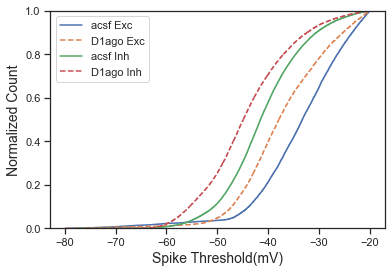

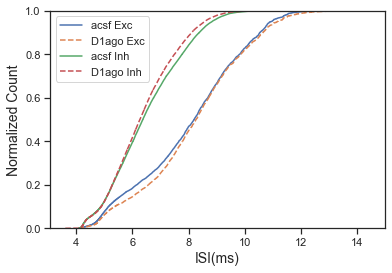

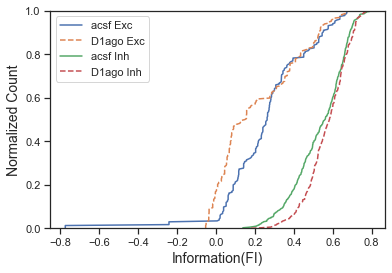

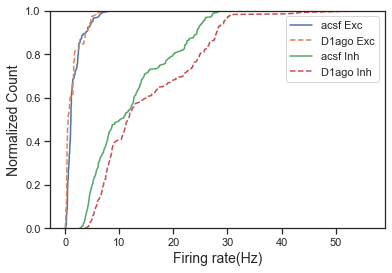

In [ ]:
#@title
# fig,ax = plt.subplots(1,2)
concat_plot(arr1['Vth'][0] )
concat_plot(arr1['Vth'][1],ltype='dashed')
concat_plot(arr1['Vth'][2])
concat_plot(arr1['Vth'][3],ltype='dashed') 
plt.xlabel('Spike Threshold(mV)',fontsize = 14)
plt.ylabel('Normalized Count',fontsize = 14)
plt.legend(['acsf Exc','D1ago Exc','acsf Inh','D1ago Inh'])
plt.ylim(0,1)
plt.show()


concat_plot(arr1['isi'][0],isi=True)
concat_plot(arr1['isi'][1],ltype='dashed',isi=True)
concat_plot(arr1['isi'][2],isi=True)
concat_plot(arr1['isi'][3],ltype='dashed',isi=True) 

plt.legend(['acsf Exc','D1ago Exc','acsf Inh','D1ago Inh'])
plt.xlabel('ISI(ms)',fontsize = 14)
plt.ylim(0,1)
plt.ylabel('Normalized Count',fontsize = 14)
plt.show()

plot_cdf(arr1['FI'][0])
plot_cdf(arr1['FI'][1],ltype='dashed')
plot_cdf(arr1['FI'][2])
plot_cdf(arr1['FI'][3],ltype='dashed')
plt.xlabel('Information(FI)',fontsize = 14)
plt.ylabel('Normalized Count',fontsize = 14)
plt.ylim(0,1)
plt.legend(['acsf Exc','D1ago Exc','acsf Inh','D1ago Inh'])
plt.show()


plot_cdf(arr1['fr'][0])
plot_cdf(arr1['fr'][1],ltype='dashed')
plot_cdf(arr1['fr'][2])

plot_cdf(arr1['fr'][3],ltype='dashed')

plt.xlabel('Firing rate(Hz)',fontsize = 14)
plt.ylabel('Normalized Count',fontsize = 14)
plt.ylim(0,1)
plt.legend(['acsf Exc','D1ago Exc','acsf Inh','D1ago Inh'])
plt.show()

In [ ]:
from numpy.random import seed
from numpy.random import randn
from numpy.random import lognormal


from scipy.stats import ks_2samp
Vth_acsf_exc, Vth_sag_exc, Vth_acsf_inh, Vth_sag_inh = arr1['Vth']
isi_acsf_exc, isi_sag_exc, isi_acsf_inh, isi_sag_inh = arr1['isi']

#perform Kolmogorov-Smirnov test
print(ks_2samp(unfold(isi_acsf_exc),unfold(isi_sag_exc) ))
print(ks_2samp(unfold(Vth_acsf_exc),unfold(Vth_sag_exc) ))


KstestResult(statistic=0.04268002821453781, pvalue=5.463799495307349e-38)
KstestResult(statistic=0.20802261535259686, pvalue=0.0)


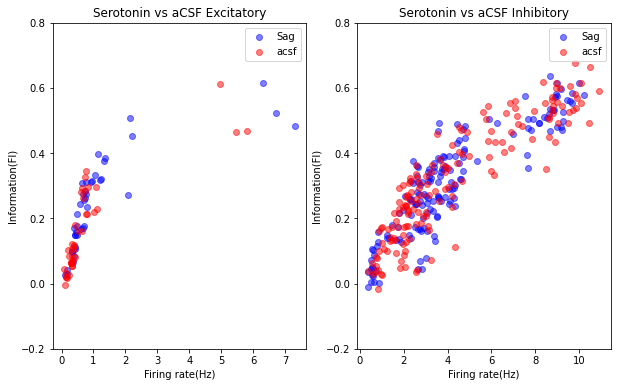

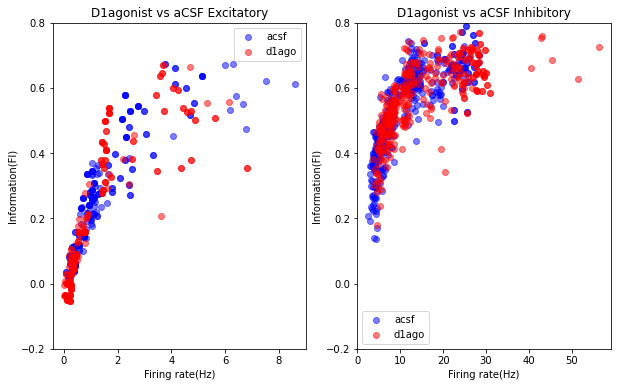

In [ ]:
fig,ax = plt.subplots(1,2,figsize=[10,6])
ax[0].scatter(arr_sag['fr'][0], arr_sag['FI'][0],c='blue',alpha=0.5)
ax[0].scatter(arr_sag['fr'][1], arr_sag['FI'][1],c='red',alpha=0.5,)
ax[1].scatter(arr_sag['fr'][2], arr_sag['FI'][2],c='blue',alpha=0.5)
ax[1].scatter(arr_sag['fr'][3], arr_sag['FI'][3],c='red',alpha=0.5)
ax[0].set_ylim(-0.2,0.8)
ax[0].set_xlabel('Firing rate(Hz)')
ax[0].set_ylabel('Information(FI)')
ax[0].set_title('Serotonin vs aCSF Excitatory')
ax[0].legend([ 'Sag','acsf',])
ax[1].set_xlabel('Firing rate(Hz)')
ax[1].set_ylabel('Information(FI)')
ax[1].set_ylim(-0.2,0.8)
plt.title('Serotonin vs aCSF Inhibitory')
ax[1].legend([ 'Sag','acsf',])

fig,ax = plt.subplots(1,2,figsize=[10,6])
ax[0].scatter(arr_dop['fr'][0], arr_dop['FI'][0],c='blue',alpha=0.5)
ax[0].scatter(arr_dop['fr'][1], arr_dop['FI'][1],c='red',alpha=0.5,)
ax[1].scatter(arr_dop['fr'][2], arr_dop['FI'][2],c='blue',alpha=0.5)
ax[1].scatter(arr_dop['fr'][3], arr_dop['FI'][3],c='red',alpha=0.5)
ax[0].set_xlabel('Firing rate(Hz)')
ax[0].set_ylabel('Information(FI)')
ax[0].set_ylim(-0.2,0.8)

ax[0].set_title('D1agonist vs aCSF Excitatory')
ax[0].legend(['acsf', 'd1ago',])
ax[1].set_xlabel('Firing rate(Hz)')
ax[1].set_ylabel('Information(FI)')
ax[1].set_ylim(-0.2,0.8)

plt.title('D1agonist vs aCSF Inhibitory')
ax[1].legend([ 'acsf','d1ago',])

Text(0, 0.5, 'States')

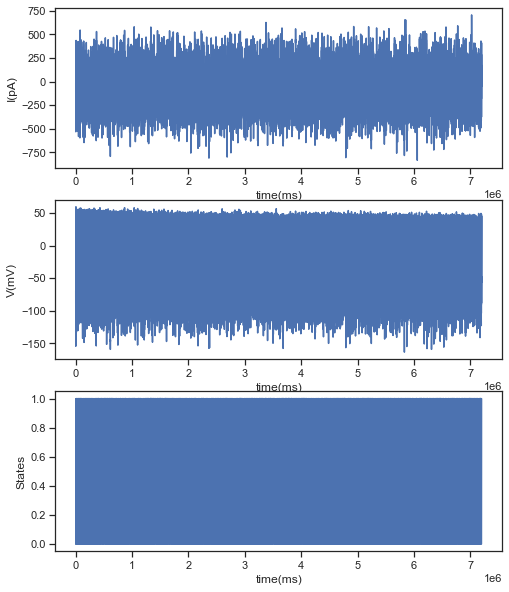

In [ ]:
df = join_cond(['ACSF'])



data = loadmat_(path+list(df['filename'])[1])
fig,ax = plt.subplots(3,1,figsize=[8,10])

ax[1].plot(data[1]['membrane_potential'])
ax[1].set_xlabel('time(ms)')
ax[1].set_ylabel('V(mV)')
ax[0].plot(data[1]['input_current'])
ax[0].set_xlabel('time(ms)')
ax[0].set_ylabel('I(pA)')
ax[2].plot(data[1]['hidden_state'])
ax[2].set_xlabel('time(ms)')
ax[2].set_ylabel('States')


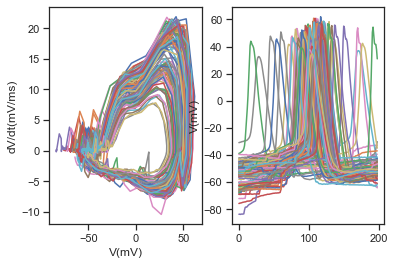

In [ ]:
def plot_state_space(v,vth):
  def remove_nan(a):
    a_temp = ~np.isnan(np.array(a))
    a = np.array(a)[a_temp]
    return a

  vth = remove_nan(vth)
  ax1= plt.subplot(1,2,1)
  ax2 =plt.subplot(1,2,2)
  for i in vth[:100]:
    try:
      ax1.plot(v[int(i)-99:int(i)+100],np.diff(v[int(i)-100:int(i)+100]))
      ax2.plot(v[int(i)-99:int(i)+100])
      ax1.set_xlabel('V(mV)')
      ax1.set_ylabel('dV/dt(mV/ms)')
      ax2.set_ylabel('V(mV)')      
    except:
      print(i)
plot_state_space(data[0]['membrane_potential'],data[1]['thresholdindices'])

# Figure H in the Dopamine paper

In [ ]:
#@title
acsf = ['asli_28-6-19_E2_analyzed.mat',
 'Copy of NC_170630_aCSF_D1ago_E4_analyzed.mat',
 'Copy of NC_170703_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_170711_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_170816_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_170821_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_170821_aCSF_D1ago_E2_analyzed.mat',
 'Copy of NC_170821_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_170830_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_170830_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_170830_aCSF_D1ago_E4_analyzed.mat',
 'Copy of NC_170913_aCSF_D1ago_E2_analyzed.mat',
 'Copy of NC_170914_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_171006_aCSF_D1ago_E7_analyzed.mat',
 'Copy of NC_171010_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_171010_aCSF_D1ago_E2_analyzed.mat',
 'Copy of NC_171010_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_171010_aCSF_D1ago_E4_analyzed.mat',
 'Copy of NC_171010_aCSF_D1ago_E5_analyzed.mat',
 'Copy of NC_171010_aCSF_D1ago_E6_analyzed.mat',
 'Copy of NC_171011_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_171011_aCSF_D1ago_E2_analyzed.mat',
 'Copy of NC_171011_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_171011_aCSF_D1ago_E4_analyzed.mat',
 'Copy of NC_171011_aCSF_D1ago_E5_analyzed.mat',
 'Copy of NC_171012_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_171012_aCSF_D1ago_E5_analyzed.mat',
 'Copy of NC_171012_aCSF_D1ago_E6_analyzed.mat',
 'Copy of NC_171012_aCSF_D1ago_E7_analyzed.mat',
 'Copy of NC_171012_aCSF_D1ago_E8_analyzed.mat',
 'Copy of NC_171012_aCSF_D1ago_E9_analyzed.mat',
 'Copy of NC_171017_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_171017_aCSF_D1ago_E2_analyzed.mat',
 'Copy of NC_171017_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_171017_aCSF_D1ago_E4_analyzed.mat',
 'Copy of NC_171017_aCSF_D1ago_E5_analyzed.mat',
 'Copy of NC_171110_aCSF_D1ago_E1_analyzed.mat',
 'Copy of NC_171110_aCSF_D1ago_E2_analyzed.mat',
 'Copy of NC_171110_aCSF_D1ago_E3_analyzed.mat',
 'Copy of NC_171207_aCSF_E1_analyzed.mat',
 'Copy of NC_171207_aCSF_E3_analyzed.mat',
 'Copy of NC_171207_aCSF_E4_analyzed.mat',
 'Copy of NC_171207_aCSF_E5_analyzed.mat',
 'Copy of NC_171207_aCSF_E6_analyzed.mat',
 'Copy of NC_171211_aCSF_E2_analyzed.mat',
 'Copy of NC_171222_aCSF_D1ago_E2_analyzed.mat',
 'Copy of NC_171222_aCSF_D1ago_E3_analyzed.mat',
 'Copy of xuan_10-10-18_E2_analyzed.mat',
 'Copy of xuan_14-1-19_E1_analyzed.mat',
 'Copy of xuan_14-1-19_E3_analyzed.mat',
 'Copy of xuan_14-3-19_E2_analyzed.mat',
 'Copy of xuan_14-3-19_E3_analyzed.mat',
 'Copy of xuan_3-4-19_E2_analyzed.mat',
 'Copy of xuan_6-3-19_E1_analyzed.mat',
 'Copy of xuan_6-3-19_E2_analyzed.mat',
 'Copy of xuan_7-3-19_E2_analyzed.mat',
 'Copy of xuan_7-3-19_E3_analyzed.mat',
 'Copy of xuan_8-1-19_E1_analyzed.mat',
 'Copy of xuan_8-1-19_E2_analyzed.mat',
 'Copy of xuan_8-1-19_E3_analyzed.mat',
 'Copy of xuan_9-1-19_E3_analyzed.mat',
 'Copy of xuan_9-1-19_E4_analyzed.mat',
 'NC_170615_aCSF_E1_analyzed.mat',
 'NC_170704_aCSF_D1ago_E2_analyzed.mat',
 'xuan_14-12-18_E1_analyzed.mat',
 'xuan_15-3-19_E1_analyzed.mat',
 'xuan_17-1-19_E2_analyzed.mat',
 'xuan_17-1-19_E3_analyzed.mat',
 'xuan_19-3-19_E1_analyzed.mat',
 'xuan_19-3-19_E4_analyzed.mat',
 'xuan_19-3-19_E5_analyzed.mat',
 'xuan_20-3-19_E3_analyzed.mat',
 'xuan_21-1-19_E1_analyzed.mat',
 'xuan_21-1-19_E2_analyzed.mat',
 'xuan_21-1-19_E5_analyzed.mat',
 'xuan_21-3-19_E1_analyzed.mat',
 'xuan_21-3-19_E3_analyzed.mat',
 'xuan_21-3-19_E4_analyzed.mat',
 'xuan_22-1-19_E1_analyzed.mat',
 'xuan_22-1-19_E2_analyzed.mat',
 'xuan_22-3-19_E1_analyzed.mat',
 'xuan_22-3-19_E2_analyzed.mat',
 'xuan_22-3-19_E3_analyzed.mat',
 'xuan_22-3-19_E4_analyzed.mat',
 'xuan_23-1-19_E1_analyzed.mat',
 'xuan_23-1-19_E2_analyzed.mat',
 'xuan_24-1-19_E2_analyzed.mat',
 'xuan_26-3-19_E2_analyzed.mat',
 'xuan_26-3-19_E4_analyzed.mat',
 'xuan_27-3-19_E2_analyzed.mat',
 'xuan_27-3-19_E4_analyzed.mat',
 'xuan_28-3-19_E2_analyzed.mat',
 'xuan_28-3-19_E3_analyzed.mat',
 'xuan_28-3-19_E4_analyzed.mat',
 'xuan_29-3-19_E1_analyzed.mat',
 'xuan_29-3-19_E2_analyzed.mat']
path = 'C:/Users/Nishant Joshi/Google Drive/Analyzed/'
trial1_FI_inh = []
trial2_FI_inh = []
trial1_FI_exc = []
trial2_FI_exc = []
trial1_fr_inh = []
trial2_fr_inh = []
trial1_fr_exc = []
trial2_fr_exc = []
for i in acsf:
  data = loadmat_(path+i)
  print(data[0]['input_generation_settings']['experimentname'])
  
  if (np.array(data[0]['Analysis']).size ==np.array(data[1]['Analysis']).size):
    if data[0]['input_generation_settings']['tau'] == 50:
      for j in data:
        if j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==1:
          if len(j['Analysis'])>1 and type(j['Analysis'])!=dict:  
            print(len(j['Analysis']))
            for m in j['Analysis']:
              # print(m)
              trial1_FI_inh.append(m['FI'])
          else:
            trial1_FI_inh.append(j['Analysis']['FI'])
          try:
            if len(j['firing_rate'])>1 and type(j['firing_rate'])!=dict:  
              for m in j['firing_rate']:
                trial1_fr_inh.append(m)
          except:
            trial1_fr_inh.append(j['firing_rate'])

          # except:
        if j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==2:
          if len(j['Analysis'])>1 and type(j['Analysis'])!=dict:  
            for m in j['Analysis'] :
              trial2_FI_inh.append(m['FI'])
          else:
            trial2_FI_inh.append(j['Analysis']['FI'])
          try:
            if len(j['firing_rate'])>1 and type(j['firing_rate'])!=dict:  

              for m in j['firing_rate']:
                trial2_fr_inh.append(m)
          except:
            trial2_fr_inh.append(j['firing_rate'])

    if data[0]['input_generation_settings']['tau'] == 250:
      for j in data:
        if j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==1:
          if len(j['Analysis'])>1 and type(j['Analysis'])!=dict:  
            print(len(j['Analysis']))
            for m in j['Analysis']:
              # print(m)
              trial1_FI_exc.append(m['FI'])
          else:
            trial1_FI_exc.append(j['Analysis']['FI'])
          try:
            if len(j['firing_rate'])>1 and type(j['firing_rate'])!=dict:  
              for m in j['firing_rate']:
                trial1_fr_exc.append(m)
          except:
            trial1_fr_exc.append(j['firing_rate'])

          # except:
        if j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==2:
          if len(j['Analysis'])>1 and type(j['Analysis'])!=dict:  
            for m in j['Analysis'] :
              trial2_FI_exc.append(m['FI'])
          else:
            trial2_FI_exc.append(j['Analysis']['FI'])
          try:
            if len(j['firing_rate'])>1 and type(j['firing_rate'])!=dict:  

              for m in j['firing_rate']:
                trial2_fr_exc.append(m)
          except:
            trial2_fr_exc.append(j['firing_rate'])

asli_28-6-19_E2
NC_170630_aCSF_D1ago_E4
18
NC_170703_aCSF_D1ago_E1
NC_170711_aCSF_D1ago_E1
NC_170816_aCSF_D1ago_E3
3
NC_170821_aCSF_D1ago_E1
3
NC_170821_aCSF_D1ago_E2
3
NC_170821_aCSF_D1ago_E3
3
NC_170830_aCSF_D1ago_E1
3
NC_170830_aCSF_D1ago_E3
3
NC_170830_aCSF_D1ago_E4
3
NC_170913_aCSF_D1ago_E2
3
NC_170914_aCSF_D1ago_E1
18
NC_171006_aCSF_D1ago_E7
3
NC_171010_aCSF_D1ago_E1
NC_171010_aCSF_D1ago_E2
3
NC_171010_aCSF_D1ago_E3
NC_171010_aCSF_D1ago_E4
3
NC_171010_aCSF_D1ago_E5
3
NC_171010_aCSF_D1ago_E6
3
NC_171011_aCSF_D1ago_E1
NC_171011_aCSF_D1ago_E2
NC_171011_aCSF_D1ago_E3
NC_171011_aCSF_D1ago_E4
NC_171011_aCSF_D1ago_E5
NC_171012_aCSF_D1ago_E3
NC_171012_aCSF_D1ago_E5
NC_171012_aCSF_D1ago_E6
NC_171012_aCSF_D1ago_E7
NC_171012_aCSF_D1ago_E8
NC_171012_aCSF_D1ago_E9
NC_171017_aCSF_D1ago_E1
NC_171017_aCSF_D1ago_E2
NC_171017_aCSF_D1ago_E3
NC_171017_aCSF_D1ago_E4
NC_171017_aCSF_D1ago_E5
NC_171110_aCSF_D1ago_E1
NC_171110_aCSF_D1ago_E2
NC_171110_aCSF_D1ago_E3
NC_171207_aCSF_E1
NC_171207_aCSF_E3
NC_1

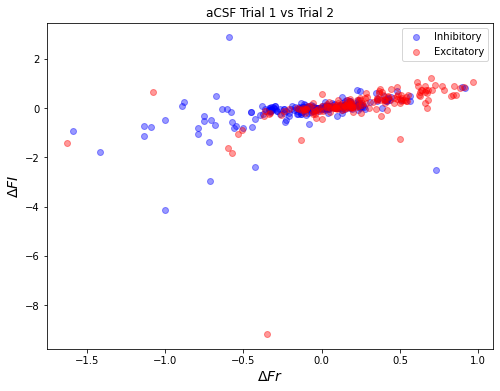

In [ ]:
#@title
# from bokeh.io import output_notebook, show
# from bokeh.plotting import figure
# %matplotlib notebook
%matplotlib inline
# output_notebook()

# p = plt_b.figure(x_range=(-2,3), y_range=(-1.5,4.5) )
fig,ax = plt.subplots(figsize=[8,6])
ax.scatter((np.array(trial1_fr_inh)-np.array(trial2_fr_inh))/np.array(trial1_fr_inh),(np.array(trial1_FI_inh)-np.array(trial2_FI_inh))/np.array(trial1_FI_inh),alpha=0.4,color='blue')
ax.scatter((np.array(trial1_fr_exc)-np.array(trial2_fr_exc))/np.array(trial1_fr_exc),(np.array(trial1_FI_exc)-np.array(trial2_FI_exc))/np.array(trial1_FI_exc),alpha=0.4,color='red')
# ax.xaxis.axis_label = 'Δf/f'#,fontsize=14)
# ax.yaxis.axis_label = 'ΔFI/FI'#,fontsize=14)
# ax.set_ylim(-2,3)
# ax.set_xlim(-1.5,4.5)
ax.legend(['Inhibitory','Excitatory'])
ax.set_title('aCSF Trial 1 vs Trial 2')
ax.set_xlabel('$ΔFr$',fontsize=14)
ax.set_ylabel('$ΔFI$',fontsize=14)
# plt.show(p)
plt.show()

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\axisgrid.py:1668: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\axisgrid.py:1668: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations


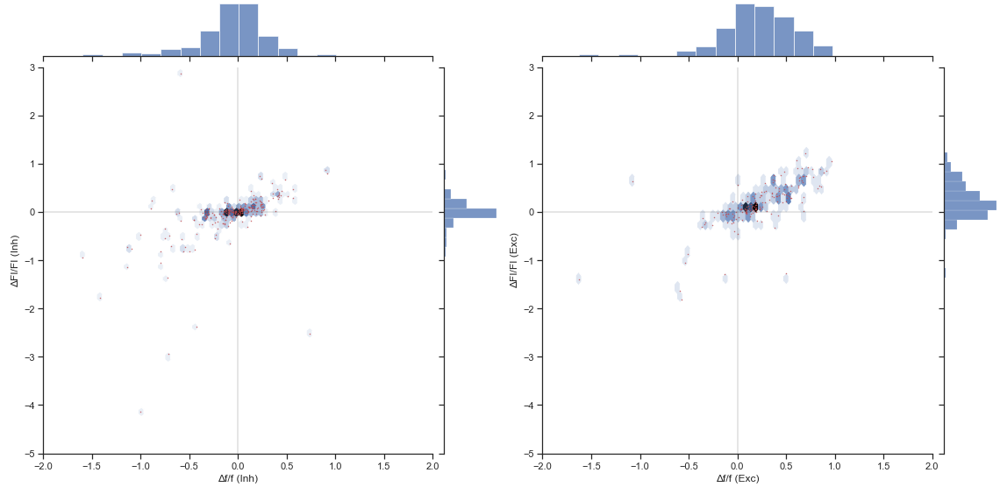

In [ ]:
# import numpy as np
import seaborn as sns
import matplotlib.gridspec as gridspec
class SeabornFig2Grid():

 def __init__(self, seaborngrid, fig,  subplot_spec):
     self.fig = fig
     self.sg = seaborngrid
     self.subplot = subplot_spec
     if isinstance(self.sg, sns.axisgrid.FacetGrid) or \
         isinstance(self.sg, sns.axisgrid.PairGrid):
         self._movegrid()
     elif isinstance(self.sg, sns.axisgrid.JointGrid):
         self._movejointgrid()
     self._finalize()

 def _movegrid(self):
     """ Move PairGrid or Facetgrid """
     self._resize()
     n = self.sg.axes.shape[0]
     m = self.sg.axes.shape[1]
     self.subgrid = gridspec.GridSpecFromSubplotSpec(n,m, subplot_spec=self.subplot)
     for i in range(n):
         for j in range(m):
             self._moveaxes(self.sg.axes[i,j], self.subgrid[i,j])

 def _movejointgrid(self):
     """ Move Jointgrid """
     h= self.sg.ax_joint.get_position().height
     h2= self.sg.ax_marg_x.get_position().height
     r = int(np.round(h/h2))
     self._resize()
     self.subgrid = gridspec.GridSpecFromSubplotSpec(r+1,r+1, subplot_spec=self.subplot)

     self._moveaxes(self.sg.ax_joint, self.subgrid[1:, :-1])
     self._moveaxes(self.sg.ax_marg_x, self.subgrid[0, :-1])
     self._moveaxes(self.sg.ax_marg_y, self.subgrid[1:, -1])

 def _moveaxes(self, ax, gs):
     #https://stackoverflow.com/a/46906599/4124317
     ax.remove()
     ax.figure=self.fig
     self.fig.axes.append(ax)
     self.fig.add_axes(ax)
     ax._subplotspec = gs
     ax.set_position(gs.get_position(self.fig))
     ax.set_subplotspec(gs)

 def _finalize(self):
     plt.close(self.sg.fig)
     self.fig.canvas.mpl_connect("resize_event", self._resize)
     self.fig.canvas.draw()

 def _resize(self, evt=None):
     self.sg.fig.set_size_inches(self.fig.get_size_inches())


x1_acsf = (np.array(trial1_fr_inh)-np.array(trial2_fr_inh))/np.array(trial1_fr_inh)
y1_acsf = (np.array(trial1_FI_inh)-np.array(trial2_FI_inh))/np.array(trial1_FI_inh)

x2_acsf = (np.array(trial1_fr_exc)-np.array(trial2_fr_exc))/np.array(trial1_fr_exc)
y2_acsf = (np.array(trial1_FI_exc)-np.array(trial2_FI_exc))/np.array(trial1_FI_exc)
%matplotlib inline
plt.style.use('ggplot')

sns.set_theme(style="ticks")
# fig, axes = plt.subplots(1, 2, figsize=(15, 5), sharey=True)
# fig.suptitle('Initial Pokemon - 1st Generation')

# Bulbasaur
g1 = sns.jointplot( x=x1_acsf, y=y1_acsf,kind = 'hex',height=2,ratio=5,marginal_kws={'binwidth':0.2},**{'gridsize':50})
plt.scatter(x1_acsf,y1_acsf,s=0.2,c='r')
plt.ylabel('ΔFI/FI (Inh)')
plt.xlabel('Δf/f (Inh)')
plt.xlim(-2,2)
plt.ylim(-5,3)
plt.axhline(0, color='black',**{'linewidth':0.2})
plt.axvline(0, color='black',**{'linewidth':0.2})
# plt.grid(color = 'green', linestyle = '--', linewidth = 0.5)

# axes[0].set_title(bulbasaur.name)
# plt.title('Excitatory')
# Charmander
g2 = sns.jointplot(x=x2_acsf, y=y2_acsf,kind = 'hex',height=2,ratio=5,marginal_kws={'binwidth':0.2},**{'gridsize':50})

plt.scatter(x2_acsf,y2_acsf,s=0.2,c='r')

plt.ylabel('ΔFI/FI (Exc)')
plt.xlabel('Δf/f (Exc)')
plt.xlim(-2,2)
plt.ylim(-5,3)
plt.axhline(0, color='black',**{'linewidth':0.2})
plt.axvline(0, color='black',**{'linewidth':0.2})
# plt.grid(color = 'green', linestyle = '--', linewidth = 0.5)

# axes[1].set_title(charmander.name)

# Squirtle
# sns.barplot(ax=axes[2], x=squirtle.index, y=squirtle.values)
# axes[2].set_title(squirtle.name)
fig = plt.figure(figsize=(16,8))

gs = gridspec.GridSpec(1,2)

SeabornFig2Grid(g1, fig, gs[0])
SeabornFig2Grid(g2, fig, gs[1])
gs.tight_layout(fig)

plt.show()

In [ ]:
from bokeh.models import HoverTool
output_notebook()

p1 = figure(title="Hexbin for 500 points", match_aspect=True,
           tools="wheel_zoom,reset", background_fill_color='#FFFFFF')
p1.grid.visible = False

r, bins = p1.hexbin(x1, y1, size=0.8, hover_color="pink", hover_alpha=0.7)

p1.circle(x1, y1, color="white", size=1)

p1.add_tools(HoverTool(
    tooltips=[("count", "@c"), ("(q,r)", "(@q, @r)")],
    mode="mouse", point_policy="follow_mouse", renderers=[r]
))
# SeabornFig2Grid(p1, fig, gs[0])
# SeabornFig2Grid(g2, fig, gs[1])
p1.xaxis.axis_label = 'Δf/f'
p1.yaxis.axis_label = 'ΔFI/FI'
p1.title = 'Inhibitory'


show(p1)

p2 = figure(title="Hexbin for 500 points", match_aspect=True,
           tools="wheel_zoom,reset", background_fill_color='#FFFFFF')
p2.grid.visible = False

r, bins = p2.hexbin(x2, y2, size=0.8, hover_color="pink", hover_alpha=0.7,)

p2.circle(x2, y2, color="white", size=1)

p2.add_tools(HoverTool(
    tooltips=[("count", "@c"), ("(q,r)", "(@q, @r)")],
    mode="mouse", point_policy="follow_mouse", renderers=[r]
))
p2.xaxis.axis_label = 'Δf/f' 
p2.yaxis.axis_label = 'ΔFI/FI'
p2.title = 'excitatory'
show(p2)

Loading BokehJS ...

NameError: ignored

In [ ]:
path = 'C:/Users/Nishant Joshi/Downloads/all_files.csv'
a = pd.read_csv(path)
cond= np.sort(np.unique(a['condition']))
def join_cond(lis_cond = None):
  path = 'C:/Users/Nishant Joshi/Downloads/all_files.csv'
  a = pd.read_csv(path)
  cond= np.sort(np.unique(a['condition']))
  temp = []
  if len(lis_cond)>1:
    for i in lis_cond:
      
      temp.append(a.groupby('condition').get_group(i))
    new_df = temp[0]
    for j in range(1,len(temp)):
      new_df = pd.concat([new_df,temp[j]])
  else:
    new_df = a.groupby('condition').get_group(lis_cond[0])
  return new_df

new  = join_cond(['M1-ago+ant', 'M1-ant', 'M1-ant+ago', 'M1-ag', 'M1-ago', 'ACSF'])
new['experimentname'].unique().shape

(187,)

In [ ]:
cond
dop = join_cond(['D1ago'])
exp = np.unique(np.array(dop['experimentname'])).size


In [ ]:
def join_cond(lis_cond = None):
  path = 'C:/Users/Nishant Joshi/Downloads/all_files.csv'
  a = pd.read_csv(path)
  cond= np.sort(np.unique(a['condition']))
  temp = []
  if len(lis_cond)>1:
    for i in lis_cond:
      
      temp.append(a.groupby('condition').get_group(i))
    new_df = temp[0]
    for j in range(1,len(temp)):
      new_df = pd.concat([new_df,temp[j]])
  else:
    new_df = a.groupby('condition').get_group(lis_cond[0])
  return new_df

In [ ]:
#@title For Collecting FI Fr Values from cells 
cond_ = ['sag']
dop = join_cond(['sag'])#,'DOPA','DOPAMINE','Dop'
exps = list( dop['experimentname'])
trials = list(dop['trialnr'])

path = 'C:/Users/Nishant Joshi/Google Drive/Analyzed/'

trial_FI_inh_D1 = []
trial_fr_inh_D1 = []
trial_FI_exc_D1 = []
trial_fr_exc_D1 = []

trial_FI_inh_acsf = []
trial_FI_exc_acsf = []
trial_fr_inh_acsf = []
trial_fr_exc_acsf = []

count_inh = 0 
count_exc = 0  
for i in range(len(exps)):
  exp_ = exps[i]
  trial_ = trials[i]
  try:
    data = loadmat_(path+exp_+'_analyzed.mat')
  except: 
    data = loadmat_(path+'Copy of '+exp_+'_analyzed.mat')

  try:
    if data[trial_-1]['input_generation_settings']['tau'] == 50 and len(data)>1:
      count_inh +=1
      for j in data:
        if j['input_generation_settings']['condition'] in cond_ and j['input_generation_settings']['trialnr'] ==trial_:
          if len(j['Analysis'])>1 and type(j['Analysis'])!=dict:  
            for m in j['Analysis']:
              trial_FI_inh_D1.append(m['FI'])
              
          else:
            trial_FI_inh_D1.append(j['Analysis']['FI'])
          try:
            if len(j['firing_rate'])>1 and type(j['firing_rate'])!=dict:  
              for m in j['firing_rate']:
                trial_fr_inh_D1.append(m)
          except:
            trial_fr_inh_D1.append(j['firing_rate'])

          if len(data[0]['Analysis'])>1 and type(data[0]['Analysis'])!=dict:  
            for m in data[0]['Analysis'] :
              trial_FI_inh_acsf.append(m['FI'])
          else:
            trial_FI_inh_acsf.append(data[0]['Analysis']['FI'])
          try:
            if len(data[0]['firing_rate'])>1 and type(data[0]['firing_rate'])!=dict:  

              for m in data[0]['firing_rate']:
                trial_fr_inh_acsf.append(m)
          except:
            trial_fr_inh_acsf.append(j['firing_rate'])
         

    if  data[trial_-1]['input_generation_settings']['tau'] == 250 and len(data)>1:
      count_exc+=1
      for j in data:
        if j['input_generation_settings']['condition']  in cond_ and j['input_generation_settings']['trialnr'] ==trial_:
          if len(j['Analysis'])>1 and type(j['Analysis'])!=dict:  
            for m in j['Analysis']:
              trial_FI_exc_D1.append(m['FI'])
          else:
            trial_FI_exc_D1.append(j['Analysis']['FI'])
          try:
            if len(j['firing_rate'])>1 and type(j['firing_rate'])!=dict:  
              for m in j['firing_rate']:

                trial_fr_exc_D1.append(m)
          except:
            trial_fr_exc_D1.append(j['firing_rate'])

          if len(data[0]['Analysis'])>1 and type(data[0]['Analysis'])!=dict:  
            for m in data[0]['Analysis'] :

              trial_FI_exc_acsf.append(m['FI'])
          else:
            trial_FI_exc_acsf.append(data[0]['Analysis']['FI'])
          try:
            if len(data[0]['firing_rate'])>1 and type(data[0]['firing_rate'])!=dict:  

              for m in data[0]['firing_rate']:
                trial_fr_exc_acsf.append(m)
          except:
            trial_fr_exc_acsf.append(j['firing_rate'])    
  except:
    pass

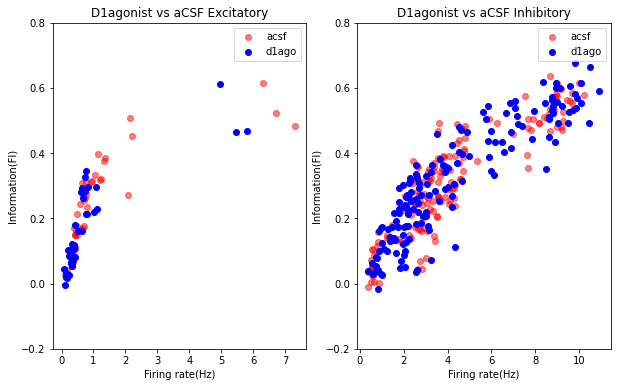

In [ ]:

fig,ax = plt.subplots(1,2,figsize=[10,6])
ax[0].scatter(trial_fr_exc_acsf, trial_FI_exc_acsf,c='red',alpha=0.5,)
ax[0].scatter(trial_fr_exc_D1, trial_FI_exc_D1,c='blue')
ax[1].scatter(trial_fr_inh_acsf, trial_FI_inh_acsf,c='red',alpha=0.5)
ax[1].scatter(trial_fr_inh_D1, trial_FI_inh_D1,c='blue')
ax[0].set_xlabel('Firing rate(Hz)')
ax[0].set_ylabel('Information(FI)')
ax[0].set_ylim(-0.2,0.8)

ax[0].set_title('D1agonist vs aCSF Excitatory')
ax[0].legend(['acsf', 'd1ago',])
ax[1].set_xlabel('Firing rate(Hz)')
ax[1].set_ylabel('Information(FI)')
ax[1].set_ylim(-0.2,0.8)

plt.title('D1agonist vs aCSF Inhibitory')
ax[1].legend([ 'acsf','d1ago',])

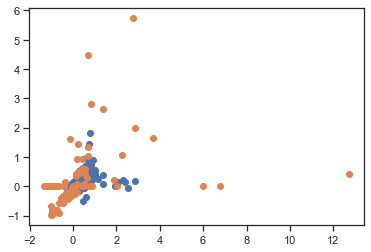

In [ ]:
x1 = (np.array(trial_fr_inh_D1)-np.array(trial_fr_inh_acsf))/np.array(trial_fr_inh_acsf)
y1 = (np.array(trial_FI_inh_D1)-np.array(trial_FI_inh_acsf))/np.array(trial_FI_inh_acsf)
x2 = (np.array(trial_FI_exc_D1)-np.array(trial_FI_exc_acsf))/np.array(trial_FI_exc_acsf)
y2 = (np.array(trial_fr_exc_D1)-np.array(trial_fr_exc_acsf))/np.array(trial_fr_exc_acsf)

plt.scatter(x1,y1)
plt.scatter(x2,y2)
plt.show()

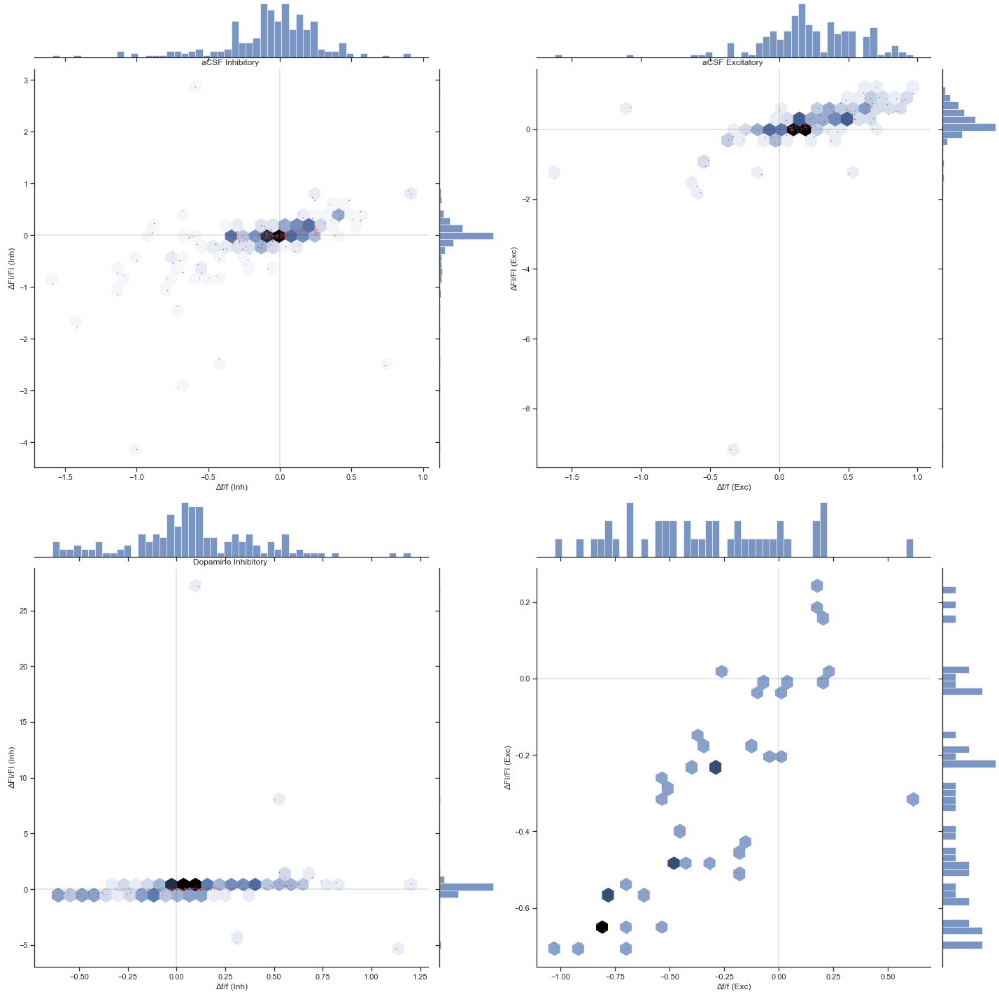

In [ ]:
x1 = (np.array(trial_fr_inh_D1)-np.array(trial_fr_inh_acsf))/np.array(trial_fr_inh_acsf)
y1 = (np.array(trial_FI_inh_D1)-np.array(trial_FI_inh_acsf))/np.array(trial_FI_inh_acsf)
x2 = (np.array(trial_FI_exc_D1)-np.array(trial_FI_exc_acsf))/np.array(trial_FI_exc_acsf)
y2 = (np.array(trial_fr_exc_D1)-np.array(trial_fr_exc_acsf))/np.array(trial_fr_exc_acsf)

# import numpy as np
import seaborn as sns
import matplotlib.gridspec as gridspec

# mpl.rcParams['agg.path.chunksize'] = 10000
# %matplotlib inline
# !pip install mpld3
# import mpld3
# mpld3.enable_notebook()
class SeabornFig2Grid():

 def __init__(self, seaborngrid, fig,  subplot_spec,title=None):
     self.fig = fig
     self.sg = seaborngrid
     self.subplot = subplot_spec
     if isinstance(self.sg, sns.axisgrid.FacetGrid) or \
         isinstance(self.sg, sns.axisgrid.PairGrid):
         self._movegrid()
     elif isinstance(self.sg, sns.axisgrid.JointGrid):
         self._movejointgrid()
     self.title = title 
     self._finalize()

 def _movegrid(self):
     """ Move PairGrid or Facetgrid """
     self._resize()
     n = self.sg.axes.shape[0]
     m = self.sg.axes.shape[1]
     self.subgrid = gridspec.GridSpecFromSubplotSpec(n+2,m+2, subplot_spec=self.subplot)
     for i in range(n):
         for j in range(m):
             self._moveaxes(self.sg.axes[i,j], self.subgrid[i,j])

 def _movejointgrid(self):
     """ Move Jointgrid """
     h= self.sg.ax_joint.get_position().height
     h2= self.sg.ax_marg_x.get_position().height
     r = int(np.round(h/h2))
     self._resize()
     self.subgrid = gridspec.GridSpecFromSubplotSpec(r+1,r+1, subplot_spec=self.subplot)

     self._moveaxes(self.sg.ax_joint, self.subgrid[1:, :-1])
     self._moveaxes(self.sg.ax_marg_x, self.subgrid[0, :-1])
     self._moveaxes(self.sg.ax_marg_y, self.subgrid[1:, -1])

 def _moveaxes(self, ax, gs):
     #https://stackoverflow.com/a/46906599/4124317
     ax.remove()
     ax.figure=self.fig
     self.fig.axes.append(ax)
     self.fig.add_axes(ax)
     ax._subplotspec = gs
     ax.set_position(gs.get_position(self.fig))
     ax.set_subplotspec(gs)
     


 def _finalize(self):
    #  self.sg.tight_layout(self.fig)
     plt.close(self.sg.fig)

     self.fig.canvas.mpl_connect("resize_event", self._resize)
     self.fig.canvas.draw()

 def _resize(self, evt=None):
     self.sg.fig.set_size_inches(self.fig.get_size_inches())


sns.set_theme(style="ticks")
# x1_ = x1[np.where(x1<10)]
# y1_ = y1[np.where(y1<20)]
g3_inh = sns.jointplot( x=x1, y=y1,kind = 'hex', marginal_kws={'bins':50},**{'gridsize':30} )
# g3.fig.suptitle(t='Title of Plot')
# g3.ax_joint.collections[0].set_alpha(0)
# g3.fig.tight_layout()
# g3.fig.subplots_adjust(top=0.95) # Reduce plot to make room
plt.scatter(x1,y1,s=0.3,c='r')
plt.ylabel('ΔFI/FI (Inh)')
plt.xlabel('Δf/f (Inh)')
plt.title('Dopamine Inhibitory ')

# plt.xlim(-2,8)
# plt.ylim(-2,8)
plt.axhline(0, color='black',**{'linewidth':0.2})
plt.axvline(0, color='black',**{'linewidth':0.2})

g4 = sns.jointplot(x=x2, y=y2,kind = 'hex', marginal_kws={'bins':50},**{'gridsize':30})
plt.scatter(x2,y2,s=0.3,c='r')

plt.ylabel('ΔFI/FI (Exc)')
plt.xlabel('Δf/f (Exc)')
# plt.xlim(-4,2)
# plt.ylim(-9,6)
plt.suptitle('Dopamine Excitatory ')

plt.axhline(0, color='black',**{'linewidth':0.2})
plt.axvline(0, color='black',**{'linewidth':0.2})

g1_inh = sns.jointplot( x=x1_acsf, y=y1_acsf,kind = 'hex', marginal_kws={'bins':50},**{'gridsize':30})
plt.scatter(x1_acsf,y1_acsf,s=0.3,c='r')
plt.ylabel('ΔFI/FI (Inh)')
plt.xlabel('Δf/f (Inh)')
plt.title('aCSF Inhibitory ')

plt.axhline(0, color='black',**{'linewidth':0.2})
plt.axvline(0, color='black',**{'linewidth':0.2})
g2 = sns.jointplot(x=x2_acsf, y=y2_acsf,kind = 'hex', marginal_kws={'bins':50},**{'gridsize':30})
plt.scatter(x2_acsf,y2_acsf,s=0.3,c='r')
# plt.xlim(-4,2)
# plt.ylim(-9,6)
plt.ylabel('ΔFI/FI (Exc)')
plt.xlabel('Δf/f (Exc)')

# plt.xlim(-2,8)
# plt.ylim(-2,8)
plt.axhline(0, color='black',**{'linewidth':0.2})
plt.axvline(0, color='black',**{'linewidth':0.2})
plt.title('aCSF Excitatory ')

fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(2,2)
SeabornFig2Grid(g1_inh, fig, gs[0,0],'Dopamine Inhibitory')
SeabornFig2Grid(g2, fig, gs[0,1])
SeabornFig2Grid(g3_inh, fig, gs[1,0])
SeabornFig2Grid(g4, fig, gs[1,1])
gs.tight_layout(fig)
# plt.savefig(open('C:/Users/Nishant Joshi/Downloads/dFI_vs_dFR.png',mode='wb'),format='png',dpi=100,bbox_inches='tight')

In [ ]:
#@title
dat = {'x1_acsf':x1_acsf,'x2_acsf':x2_acsf,'x1_dop':x1,'x2_dop':x2,'y1_acsf':y1_acsf,'y2_acsf':y2_acsf,'y1_dop':y1,'y2_dop':y2}

# df = pd.DataFrame(data=dat,columns=['x1_acsf','x2_acsf','x1_dop','x2_dop','y1_acsf','y2_acsf','y1_dop','y2_dop'])
def remove_nan(dat):
  ind = ~np.isnan(dat)
  data = dat[ind]
  return data
arr = [x1_acsf,y1_acsf,x2_acsf,y2_acsf,x1,y1,x2,y2]
size = 0
for i in arr:
  # print(np.array(i).size)
  if int(np.array(i).size)>size:
    size =  np.array(i).size
# len(arr)

m = np.zeros((len(arr),size))
m[:,:] = np.nan  
for i in range(len(arr)) : 
  arr_ = arr[i][np.where(((arr[i]<5 )& (arr[i]>-5)))]
  m[i,:len(arr_)] = arr_



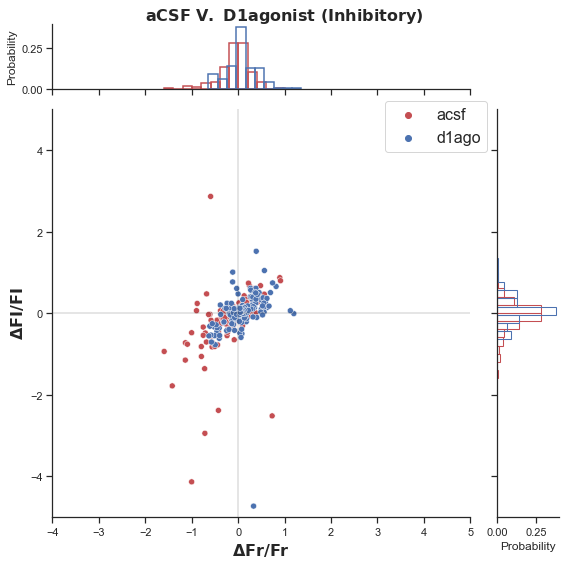

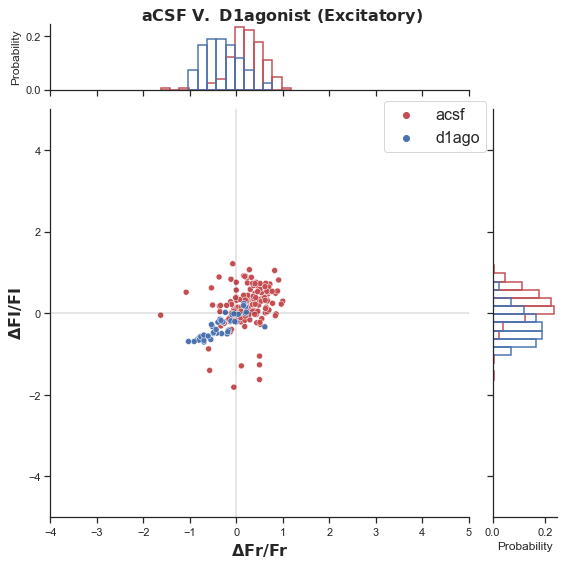

In [ ]:
#@title
cond = np.empty(4*len(m[0]),dtype = object)
cond[:len(m[0])] = 'acsf'
cond[len(m[0]):2*len(m[0])] = 'acsf' 
cond[2*len(m[0]):3*len(m[0])] = 'd1ago'
cond[3*len(m[0]):] = 'd1ago'

ctype = np.empty(4*len(m[0]),dtype = object)
ctype[:len(m[0])] = 'inh'
ctype[len(m[0]):2*len(m[0])] = 'exc'
ctype[2*len(m[0]):3*len(m[0])] = 'inh'
ctype[3*len(m[0]):] = 'exc'


dat = {'fr':np.concatenate((np.concatenate((m[0],m[2])),np.concatenate((m[4],m[6])))),'FI':np.concatenate((np.concatenate((m[1],m[3])),np.concatenate((m[5],m[7])))),'condition':cond,'ctype':ctype}
df_ = pd.DataFrame(data=dat)
inh = df_.groupby('ctype').get_group('inh')
exc = df_.groupby('ctype').get_group('exc')

g6 = sns.JointGrid(height=8,marginal_ticks=True,)
sns.scatterplot(data=inh, x="fr", y="FI",hue='condition',ax = g6.ax_joint,palette=['r','b'])
sns.histplot( x=remove_nan(inh.groupby('condition').get_group('acsf')['fr']) , ax=g6.ax_marg_x ,color='r', stat='probability', fill=False, binwidth=.20)
sns.histplot( x=remove_nan(inh.groupby('condition').get_group('d1ago')['fr']), ax=g6.ax_marg_x ,color='b', stat='probability', fill=False, binwidth=.20)
sns.histplot( y=remove_nan(inh.groupby('condition').get_group('acsf')['fr']) , ax=g6.ax_marg_y ,color='r', stat='probability', fill=False, binwidth=.20)
sns.histplot( y=remove_nan(inh.groupby('condition').get_group('d1ago')['fr']), ax=g6.ax_marg_y ,color='b', stat='probability', fill=False, binwidth=.20)
g6.fig.suptitle("$\\bf{aCSF ~ V. ~D1agonist ~(Inhibitory) }$",fontsize=16)
g6.fig.legend(fontsize = 16,loc =(0.68,0.73))
g6.ax_joint.set_xlabel('$\\bf{ ΔFr/Fr}$',fontsize=16)
g6.ax_joint.set_ylabel('$\\bf{ ΔFI/FI}$',fontsize=16)
g6.ax_joint.set_xlim(-4,5)
g6.ax_joint.set_ylim(-5,5)
g6.ax_joint.axhline(0, color='black',**{'linewidth':0.2})
g6.ax_joint.axvline(0, color='black',**{'linewidth':0.2})
g6.ax_joint.legend_._visible =False
g6.fig.tight_layout()
g6.fig.subplots_adjust(top=0.95)

g5 = sns.JointGrid(height=8,marginal_ticks=True)
sns.scatterplot(data=exc, x="fr", y="FI",hue='condition',ax = g5.ax_joint,palette=['r','b'])
sns.histplot( x= remove_nan(exc.groupby('condition').get_group('acsf')['fr']) ,stat='probability',ax=g5.ax_marg_x,color='r', fill=False, binwidth=.20)
sns.histplot( x= remove_nan(exc.groupby('condition').get_group('d1ago')['fr']),stat='probability',ax=g5.ax_marg_x,color='b', fill=False, binwidth=.20)
sns.histplot( y= remove_nan(exc.groupby('condition').get_group('acsf')['fr']) ,stat='probability',ax=g5.ax_marg_y,color='r', fill=False, binwidth=.20)
sns.histplot( y= remove_nan(exc.groupby('condition').get_group('d1ago')['fr']),stat='probability',ax=g5.ax_marg_y,color='b', fill=False, binwidth=.20)
g5.fig.suptitle("$\\bf{aCSF ~V.~D1agonist~(Excitatory)}$",fontsize=16)
g5.fig.legend(fontsize = 16,loc =(0.68,0.73))
g5.ax_joint.set_xlabel('$\\bf{ ΔFr/Fr}$',fontsize=16)
g5.ax_joint.set_ylabel('$\\bf{ ΔFI/FI}$',fontsize=16)
g5.ax_joint.set_xlim(-4,5)
g5.ax_joint.set_ylim(-5,5)
g5.ax_joint.axhline(0, color='black',**{'linewidth':0.2})
g5.ax_joint.axvline(0, color='black',**{'linewidth':0.2})
g5.ax_joint.legend_._visible =False
g5.fig.tight_layout()
g5.fig.subplots_adjust(top=0.95)


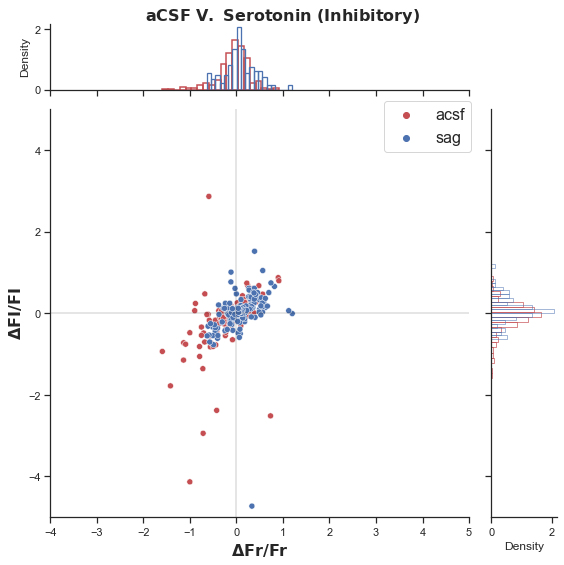

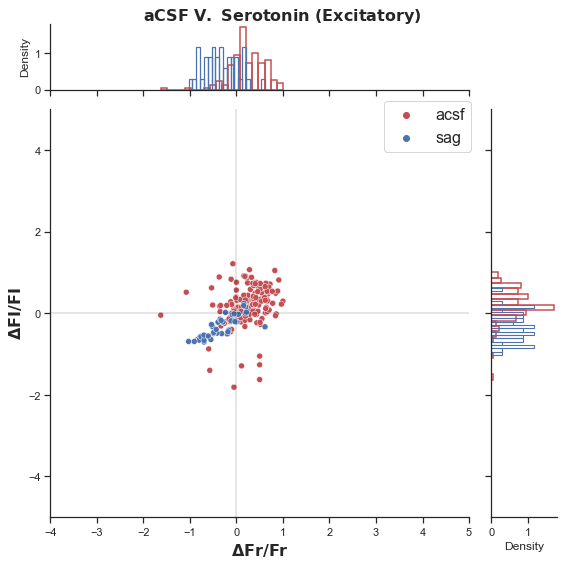

In [ ]:
#@title
cond = np.empty(4*len(m[0]),dtype = object)
cond[:len(m[0])] = 'acsf'
cond[len(m[0]):2*len(m[0])] = 'acsf' 
cond[2*len(m[0]):3*len(m[0])] = 'sag'
cond[3*len(m[0]):] = 'sag'

ctype = np.empty(4*len(m[0]),dtype = object)
ctype[:len(m[0])] = 'inh'
ctype[len(m[0]):2*len(m[0])] = 'exc'
ctype[2*len(m[0]):3*len(m[0])] = 'inh'
ctype[3*len(m[0]):] = 'exc'


dat = {'fr':np.concatenate((np.concatenate((m[0],m[2])),np.concatenate((m[4],m[6])))),'FI':np.concatenate((np.concatenate((m[1],m[3])),np.concatenate((m[5],m[7])))),'condition':cond,'ctype':ctype}
df_ = pd.DataFrame(data=dat)
inh = df_.groupby('ctype').get_group('inh')
exc = df_.groupby('ctype').get_group('exc')

g6 = sns.JointGrid(height=8,marginal_ticks=True)
sns.scatterplot(data=inh, x="fr", y="FI",hue='condition',ax = g6.ax_joint,palette=['r','b'],)
sns.histplot( x=remove_nan(inh.groupby('condition').get_group('acsf')['fr']) , ax=g6.ax_marg_x ,color='r', stat='density', fill=False, bins=20)
sns.histplot( x=remove_nan(inh.groupby('condition').get_group('sag')['fr']), ax=g6.ax_marg_x ,color='b', stat='density', fill=False, bins=20)
sns.histplot( y=remove_nan(inh.groupby('condition').get_group('acsf')['fr']) , ax=g6.ax_marg_y ,color='r', stat='density', fill=False, bins=20)
sns.histplot( y=remove_nan(inh.groupby('condition').get_group('sag')['fr']), ax=g6.ax_marg_y ,color='b', stat='density', fill=False, bins=20)
g6.fig.suptitle("$\\bf{aCSF ~ V. ~Serotonin ~(Inhibitory) }$",fontsize=16)
g6.fig.legend(fontsize = 16,loc =(0.68,0.73))
g6.ax_joint.set_xlabel('$\\bf{ ΔFr/Fr}$',fontsize=16)
g6.ax_joint.set_ylabel('$\\bf{ ΔFI/FI}$',fontsize=16)
g6.ax_joint.set_xlim(-4,5)
g6.ax_joint.set_ylim(-5,5)
g6.ax_joint.axhline(0, color='black',**{'linewidth':0.2})
g6.ax_joint.axvline(0, color='black',**{'linewidth':0.2})
g6.ax_joint.legend_._visible =False
g6.fig.tight_layout()
g6.fig.subplots_adjust(top=0.95)

g5 = sns.JointGrid(height=8,marginal_ticks=True)
sns.scatterplot(data=exc, x="fr", y="FI",hue='condition',ax = g5.ax_joint,palette=['r','b'])
sns.histplot( x= remove_nan(exc.groupby('condition').get_group('acsf')['fr']) ,stat='density',ax=g5.ax_marg_x,color='r', fill=False, bins=20)
sns.histplot( x= remove_nan(exc.groupby('condition').get_group('sag')['fr']),stat='density',ax=g5.ax_marg_x,color='b', fill=False, bins=20)
sns.histplot( y= remove_nan(exc.groupby('condition').get_group('acsf')['fr']) ,stat='density',ax=g5.ax_marg_y,color='r', fill=False, bins=20)
sns.histplot( y= remove_nan(exc.groupby('condition').get_group('sag')['fr']),stat='density',ax=g5.ax_marg_y,color='b', fill=False, bins=20)
g5.fig.suptitle("$\\bf{aCSF ~V.~Serotonin~(Excitatory)}$",fontsize=16)
g5.fig.legend(fontsize = 16,loc =(0.68,0.73))
g5.ax_joint.set_xlabel('$\\bf{ ΔFr/Fr}$',fontsize=16)
g5.ax_joint.set_ylabel('$\\bf{ ΔFI/FI}$',fontsize=16)
g5.ax_joint.set_xlim(-4,5)
g5.ax_joint.set_ylim(-5,5)
g5.ax_joint.axhline(0, color='black',**{'linewidth':0.2})
g5.ax_joint.axvline(0, color='black',**{'linewidth':0.2})
g5.ax_joint.legend_._visible =False
g5.fig.tight_layout()
g5.fig.subplots_adjust(top=0.95)


In [ ]:
g6.savefig('C:/Users/Nishant Joshi/Downloads/sag_inh.png',dpi=300)
g5.savefig('C:/Users/Nishant Joshi/Downloads/sag_exc.png',dpi=300)

Inh FR  LeveneResult(statistic=0.000456653734003055, pvalue=0.9829586035593941)
Exc FR  LeveneResult(statistic=52.13071296566466, pvalue=5.6296372262730954e-12)
Inh FI  LeveneResult(statistic=8.778709709357953, pvalue=0.003178074285745917)
Exc FI  LeveneResult(statistic=4.523031164045069, pvalue=0.03437262019863979)
Var EXC FR  0.13132354138556948 0.8646019769696816
Var INH FI  0.2736483331462497 0.05769521797394501
Var INH FR  0.12133499395575044 0.16337821039742723
Var EXC FI  0.20481624467925202 0.6643447425437732
T-test EXC FR  Ttest_indResult(statistic=3.5157220957725763, pvalue=0.0005166302853758669)
T-test INH FI  Ttest_indResult(statistic=-4.87271145095145, pvalue=1.4377400517476867e-06)
T-test INH FR  Ttest_indResult(statistic=-11.407104418875289, pvalue=3.149059369288591e-27)
T-test EXC FI  Ttest_indResult(statistic=0.8548114790599294, pvalue=0.3934335228512795)


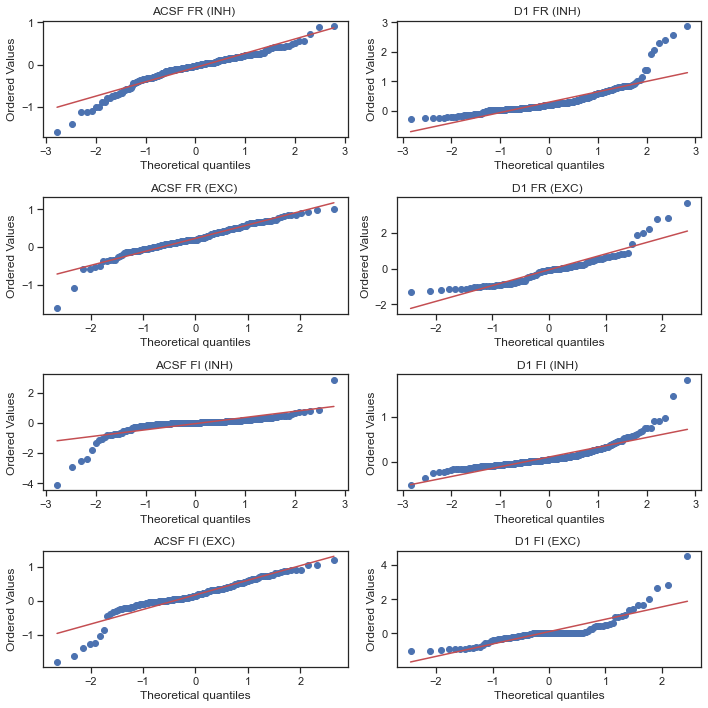

In [ ]:
from scipy import stats 


exc = df_.groupby('ctype').get_group('exc')
inh = df_.groupby('ctype').get_group('inh')
def remove_nan(dat):
  ind = ~np.isnan(dat)
  data = dat[ind]
  return data

a = stats.levene(remove_nan(inh.groupby('condition').get_group('acsf')['fr']),remove_nan(inh.groupby('condition').get_group('d1ago')['fr']))
b = stats.levene(remove_nan(exc.groupby('condition').get_group('acsf')['fr']),remove_nan(exc.groupby('condition').get_group('d1ago')['fr']))
c = stats.levene(remove_nan(inh.groupby('condition').get_group('acsf')['FI']),remove_nan(inh.groupby('condition').get_group('d1ago')['FI']))
d = stats.levene(remove_nan(exc.groupby('condition').get_group('acsf')['FI']),remove_nan(exc.groupby('condition').get_group('d1ago')['FI']))
print('Inh FR ',a)
print('Exc FR ',b)
print('Inh FI ',c)
print('Exc FI ',d)

fig,ax = plt.subplots(4,2,figsize=[10,10])
stats.probplot(np.sort(remove_nan(inh.groupby('condition').get_group('acsf')['fr']) ), dist="norm", plot= ax[0,0])
ax[0,0].set_title("ACSF FR (INH) ")
stats.probplot(np.sort(remove_nan(inh.groupby('condition').get_group('d1ago')['fr'])), dist="norm", plot= ax[0,1])
ax[0,1].set_title("D1 FR (INH) ")
stats.probplot(np.sort(remove_nan(exc.groupby('condition').get_group('acsf')['fr']) ), dist="norm", plot= ax[1,0])
ax[1,0].set_title("ACSF FR (EXC) ")
stats.probplot(np.sort(remove_nan(exc.groupby('condition').get_group('d1ago')['fr'])), dist="norm", plot= ax[1,1])
ax[1,1].set_title("D1 FR (EXC) ")
stats.probplot(np.sort(remove_nan(inh.groupby('condition').get_group('acsf')['FI']) ), dist="norm", plot= ax[2,0])
ax[2,0].set_title("ACSF FI (INH) ")
stats.probplot(np.sort(remove_nan(inh.groupby('condition').get_group('d1ago')['FI'])), dist="norm", plot= ax[2,1])
ax[2,1].set_title("D1 FI (INH) ")
stats.probplot(np.sort(remove_nan(exc.groupby('condition').get_group('acsf')['FI']) ), dist="norm", plot= ax[3,0])
ax[3,0].set_title("ACSF FI (EXC) ")
stats.probplot(np.sort(remove_nan(exc.groupby('condition').get_group('d1ago')['FI'])), dist="norm", plot= ax[3,1])
ax[3,1].set_title("D1 FI (EXC) ")
plt.tight_layout()

print('Var EXC FR ',np.var(remove_nan(exc.groupby('condition').get_group('acsf')['fr'])),np.var(remove_nan(exc.groupby('condition').get_group('d1ago')['fr'])))
print('Var INH FI ',np.var(remove_nan(inh.groupby('condition').get_group('acsf')['FI'])),np.var(remove_nan(inh.groupby('condition').get_group('d1ago')['FI'])))
print('Var INH FR ',np.var(remove_nan(inh.groupby('condition').get_group('acsf')['fr'])),np.var(remove_nan(inh.groupby('condition').get_group('d1ago')['fr'])))
print('Var EXC FI ',np.var(remove_nan(exc.groupby('condition').get_group('acsf')['FI'])),np.var(remove_nan(exc.groupby('condition').get_group('d1ago')['FI'])))


print('T-test EXC FR ',stats.ttest_ind(remove_nan(exc.groupby('condition').get_group('acsf')['fr']),remove_nan(exc.groupby('condition').get_group('d1ago')['fr'])))
print('T-test INH FI ',stats.ttest_ind(remove_nan(inh.groupby('condition').get_group('acsf')['FI']),remove_nan(inh.groupby('condition').get_group('d1ago')['FI'])))
print('T-test INH FR ',stats.ttest_ind(remove_nan(inh.groupby('condition').get_group('acsf')['fr']),remove_nan(inh.groupby('condition').get_group('d1ago')['fr'])))
print('T-test EXC FI ',stats.ttest_ind(remove_nan(exc.groupby('condition').get_group('acsf')['FI']),remove_nan(exc.groupby('condition').get_group('d1ago')['FI'])))

In [ ]:
ser = accumulate_vals(['sag'])
d1ago = accumulate_vals(['D1ago'])

In [ ]:
x1 = (np.array(trial_fr_inh_D1)-np.array(trial_fr_inh_acsf))/np.array(trial_fr_inh_acsf)
y1 = (np.array(trial_FI_inh_D1)-np.array(trial_FI_inh_acsf))/np.array(trial_FI_inh_acsf)
x2 = (np.array(trial_FI_exc_D1)-np.array(trial_FI_exc_acsf))/np.array(trial_FI_exc_acsf)
y2 = (np.array(trial_fr_exc_D1)-np.array(trial_fr_exc_acsf))/np.array(trial_fr_exc_acsf)
 
exc = df_.groupby('ctype').get_group('exc')
inh = df_.groupby('ctype').get_group('inh')
def remove_nan(dat):
  ind = ~np.isnan(dat)
  data = dat[ind]
  return data
a = stats.levene(remove_nan(inh.groupby('condition').get_group('acsf')['fr']),remove_nan(inh.groupby('condition').get_group('d1ago')['fr']))
b = stats.levene(remove_nan(exc.groupby('condition').get_group('acsf')['fr']),remove_nan(exc.groupby('condition').get_group('d1ago')['fr']))
c = stats.levene(remove_nan(inh.groupby('condition').get_group('acsf')['FI']),remove_nan(inh.groupby('condition').get_group('d1ago')['FI']))
d = stats.levene(remove_nan(exc.groupby('condition').get_group('acsf')['FI']),remove_nan(exc.groupby('condition').get_group('d1ago')['FI']))
print(a)
print(b)
print(c)
print(d)
fig,ax = plt.subplots(4,2,figsize=[10,10])
stats.probplot(remove_nan(inh.groupby('condition').get_group('acsf')['fr']), dist="norm", plot= ax[0,0])
ax[0,0].set_title("ACSF FR (INH) ")
stats.probplot(remove_nan(inh.groupby('condition').get_group('d1ago')['fr']), dist="norm", plot= ax[0,1])
ax[0,1].set_title("D1 FR (INH) ")
stats.probplot(remove_nan(exc.groupby('condition').get_group('acsf')['fr']), dist="norm", plot= ax[1,0])
ax[1,0].set_title("ACSF FR (EXC) ")
stats.probplot(remove_nan(exc.groupby('condition').get_group('d1ago')['fr']), dist="norm", plot= ax[1,1])
ax[1,1].set_title("D1 FR (EXC) ")
stats.probplot(remove_nan(inh.groupby('condition').get_group('acsf')['FI']), dist="norm", plot= ax[2,0])
ax[2,0].set_title("ACSF FI (INH) ")
stats.probplot(remove_nan(inh.groupby('condition').get_group('d1ago')['FI']), dist="norm", plot= ax[2,1])
ax[2,1].set_title("D1 FI (INH) ")
stats.probplot(remove_nan(exc.groupby('condition').get_group('acsf')['FI']), dist="norm", plot= ax[3,0])
ax[3,0].set_title("ACSF FI (EXC) ")
stats.probplot(remove_nan(exc.groupby('condition').get_group('d1ago')['FI']), dist="norm", plot= ax[3,1])
ax[3,1].set_title("D1 FI (EXC) ")
# fig.title('Q-Q Plot')
plt.tight_layout()

print(np.var(remove_nan(inh.groupby('condition').get_group('acsf')['FI'])),np.var(remove_nan(inh.groupby('condition').get_group('d1ago')['FI'])))
print(np.var(remove_nan(inh.groupby('condition').get_group('acsf')['fr'])),np.var(remove_nan(inh.groupby('condition').get_group('d1ago')['fr'])))
print(np.var(remove_nan(exc.groupby('condition').get_group('acsf')['fr'])),np.var(remove_nan(exc.groupby('condition').get_group('d1ago')['fr'])))
print(np.var(remove_nan(exc.groupby('condition').get_group('acsf')['FI'])),np.var(remove_nan(exc.groupby('condition').get_group('d1ago')['FI'])))


print(stats.ttest_ind(remove_nan(exc.groupby('condition').get_group('acsf')['fr']),remove_nan(exc.groupby('condition').get_group('d1ago')['fr'])))
print(stats.ttest_ind(remove_nan(exc.groupby('condition').get_group('acsf')['FI']),remove_nan(exc.groupby('condition').get_group('d1ago')['FI'])))
print(stats.ttest_ind(remove_nan(inh.groupby('condition').get_group('acsf')['fr']),remove_nan(inh.groupby('condition').get_group('d1ago')['fr'])))
print(stats.ttest_ind(remove_nan(inh.groupby('condition').get_group('acsf')['FI']),remove_nan(inh.groupby('condition').get_group('d1ago')['FI'])))

In [ ]:

x1_ = x1[np.where(x1<10)]
y1_ = y1[np.where(y1<20)]

print(len(x1),len(y1))

x2_= x2[np.where(x2<10)]
y2_= y2[np.where(y2<10)]
x3= x1_acsf[np.where(x1_acsf<10)]
y3= y1_acsf[np.where(y1_acsf<10)]
x4= x2_acsf[np.where(x2_acsf<10)]
y4= y2_acsf[np.where(y2_acsf<10)]


g1 = sns.jointplot(x1_acsf,y1_acsf,kind='hex',height=10, marginal_kws={'bins':50}, **{'gridsize':20})
plt.scatter(x1_acsf,y1_acsf,s=0.5,c='r')
g1.fig.suptitle("Your title here")

g2 = sns.jointplot(x2_acsf,y2_acsf,kind='hex',height=10, marginal_kws={'bins':50},**{'gridsize':20})
plt.scatter(x2_acsf,y2_acsf,s=0.5,c='r')

g3 = sns.jointplot(x1_,y1_,kind='hex',height=10,marginal_kws={'bins':50},**{'gridsize':20})
plt.scatter(x1_,y1_,s=0.5,c='r')


g4 = sns.jointplot(x2,y2,kind='hex',height=10, marginal_kws={'bins':50},**{'gridsize':20})
plt.scatter(x2,y2,s=0.5,c='r')

fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(2,2)

SeabornFig2Grid(g1, fig, gs[0,0])
SeabornFig2Grid(g2, fig, gs[0,1])
SeabornFig2Grid(g3, fig, gs[1,0])
SeabornFig2Grid(g4, fig, gs[1,1])

gs.tight_layout(fig)
plt.show()


540 540


C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.


<IPython.core.display.Javascript object>

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.


<IPython.core.display.Javascript object>

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.


<IPython.core.display.Javascript object>

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.


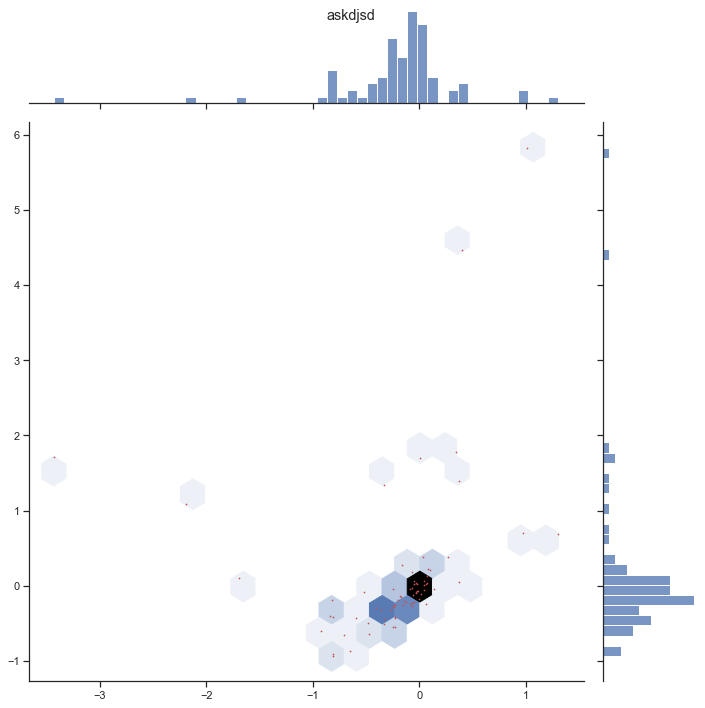

In [ ]:
sns.jointplot(x2,y2,kind='hex',height=10, marginal_kws={'bins':50},**{'gridsize':20}).fig.suptitle('askdjsd')
plt.scatter(x2,y2,s=0.5,c='r')
# plt.suptitle('askjdhsa')

In [ ]:
dop = join_cond(['D1','DOPA','DOPAMINE','Dop'])
exps =list( dop['experimentname'])
trials = list(dop['trialnr'])
cond = list(dop['condition'])
path = 'C:/Users/Nishant Joshi/Google Drive/Analyzed/'

# for i in range(len(exps)):
#   exp_ = exps[i]
#   print(exp_)
#   print(cond[i])
#   trial_ = trials[i]
#   try:
#     data = loadmat_(path+exp_+'_analyzed.mat')
#   except: 
#     data = loadmat_(path+'Copy of '+exp_+'_analyzed.mat')
#   print(len(data))
#   print(data[0]['input_generation_settings']['condition'])

loadmat(path+exp_[0]+'_analyzed.mat')

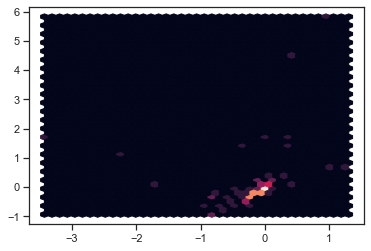

In [ ]:
# plot:
fig, ax = plt.subplots()

ax.hexbin(x2, y2, gridsize=40)

# ax.set(xlim=(-2, 2), ylim=(-3, 3))

plt.show()

In [ ]:
# import numpy as np
import seaborn as sns
import matplotlib.gridspec as gridspec
x1dop = (np.array(trial1_fr_inh)-np.array(trial2_fr_inh))/np.array(trial1_fr_inh)
y1dop = (np.array(trial1_FI_inh)-np.array(trial2_FI_inh))/np.array(trial1_FI_inh)
y1_nandop = ~np.isnan(y1dop)
y1dop = y1dop[y1_nandop]
x1dop = x1dop[y1_nandop]

x2dop =(np.array(trial1_fr_exc)-np.array(trial2_fr_exc))/np.array(trial1_fr_exc)
y2dop =(np.array(trial1_FI_exc)-np.array(trial2_FI_exc))/np.array(trial1_FI_exc)
y2_nandop = ~np.isnan(y2dop)
y2dop = y2dop[y2_nandop]
x2dop = x2dop[y2_nandop]
print(x2dop)
# class SeabornFig2Grid():

#  def __init__(self, seaborngrid, fig,  subplot_spec):
#      self.fig = fig
#      self.sg = seaborngrid
#      self.subplot = subplot_spec
#      if isinstance(self.sg, sns.axisgrid.FacetGrid) or \
#          isinstance(self.sg, sns.axisgrid.PairGrid):
#          self._movegrid()
#      elif isinstance(self.sg, sns.axisgrid.JointGrid):
#          self._movejointgrid()
#      self._finalize()

#  def _movegrid(self):
#      """ Move PairGrid or Facetgrid """
#      self._resize()
#      n = self.sg.axes.shape[0]
#      m = self.sg.axes.shape[1]
#      self.subgrid = gridspec.GridSpecFromSubplotSpec(n,m, subplot_spec=self.subplot)
#      for i in range(n):
#          for j in range(m):
#              self._moveaxes(self.sg.axes[i,j], self.subgrid[i,j])

#  def _movejointgrid(self):
#      """ Move Jointgrid """
#      h= self.sg.ax_joint.get_position().height
#      h2= self.sg.ax_marg_x.get_position().height
#      r = int(np.round(h/h2))
#      self._resize()
#      self.subgrid = gridspec.GridSpecFromSubplotSpec(r+1,r+1, subplot_spec=self.subplot)

#      self._moveaxes(self.sg.ax_joint, self.subgrid[1:, :-1])
#      self._moveaxes(self.sg.ax_marg_x, self.subgrid[0, :-1])
#      self._moveaxes(self.sg.ax_marg_y, self.subgrid[1:, -1])

#  def _moveaxes(self, ax, gs):
#      #https://stackoverflow.com/a/46906599/4124317
#      ax.remove()
#      ax.figure=self.fig
#      self.fig.axes.append(ax)
#      self.fig.add_axes(ax)
#      ax._subplotspec = gs
#      ax.set_position(gs.get_position(self.fig))
#      ax.set_subplotspec(gs)

#  def _finalize(self):
#      plt.close(self.sg.fig)
#      self.fig.canvas.mpl_connect("resize_event", self._resize)
#      self.fig.canvas.draw()

#  def _resize(self, evt=None):
#      self.sg.fig.set_size_inches(self.fig.get_size_inches())


# sns.set_theme(style="ticks")
# # fig, axes = plt.subplots(1, 2, figsize=(15, 5), sharey=True)
# # fig.suptitle('Initial Pokemon - 1st Generation')

# # Bulbasaur
# g1_dop = sns.jointplot( x=x1dop, y=y1dop,kind = 'hex',height=2,ratio=5,marginal_kws={'binwidth':0.1},)
# plt.scatter(x1dop,y1dop,s=0.2,c='r')
# plt.ylabel('ΔFI/FI (Inh)')
# plt.xlabel('Δf/f (Inh)')
# plt.xlim(-2,2)
# plt.ylim(-5,3)
# # axes[0].set_title(bulbasaur.name)
# # plt.title('Excitatory')
# # Charmander
# g2_dop = sns.jointplot(x=x2dop, y=y2dop,kind = 'hex',height=2,ratio=5,marginal_kws={'binwidth':0.1},)
# plt.scatter(x2dop,y2dop,s=0.2,c='r')

# plt.ylabel('ΔFI/FI (Exc)')
# plt.xlabel('Δf/f (Exc)')
# plt.xlim(-2,2)
# plt.ylim(-5,3)
# # axes[1].set_title(charmander.name)

# # Squirtle
# # sns.barplot(ax=axes[2], x=squirtle.index, y=squirtle.values)
# # axes[2].set_title(squirtle.name)
# figdop = plt.figure(figsize=(15,8))
# gs = gridspec.GridSpec(1,2)
# SeabornFig2Grid(g1_dop, figdop, gs[0])
# SeabornFig2Grid(g2_dop, figdop, gs[1])
# gs.tight_layout(figdop)


[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0.]


<ipython-input-308-3fe3a741a7ef>:10: RuntimeWarning: invalid value encountered in true_divide


In [ ]:
x2dop

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0.

In [ ]:
path = 'C:/Users/Nishant Joshi/Google Drive/Analyzed/'
all = os.listdir(path)
all_db = []
for i in all:

  dat = loadmat_(path+i)

  for m in dat:
    print(m['input_generation_settings'])
    all_db.append(m['input_generation_settings']['experimentname'])    
    all_db.append(m['input_generation_settings']['condition'])
    all_db.append(m['input_generation_settings']['trialnr'])
    all_db.append(m['input_generation_settings']['tau'])
    all_db.append(i)


In [ ]:
all_db
ind = 0
all_db1 = []
temp = []
for i in range(len(all_db)):
  # print(all_db[i])
  temp.append(all_db[i])
  if type(all_db[i]) == str:
    if '.mat' in all_db[i] :
      all_db1.append(temp)
      temp = []
# all_db[:10]
all_db1
db = pd.DataFrame(data=all_db1)
db.columns = ['experimentname','condition','trialnr','tau','filename']
db.to_csv(r'C:/Users/Nishant Joshi/Downloads/all_files.csv')

In [ ]:

db.to_csv()

TypeError: ignored

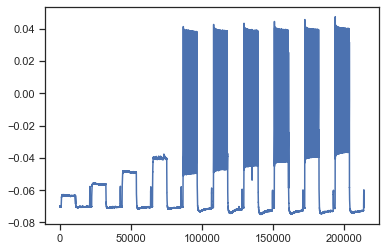

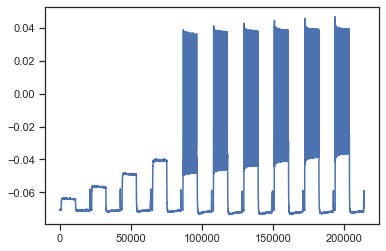

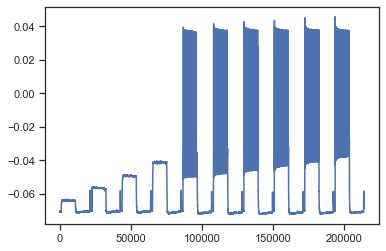

In [ ]:
#@title
lists =  ['171010_NC_126',
     '171010_NC_128',
     '171010_NC_129',
     '171110_NC_143',
     '171110_NC_144',
     '171110_NC_145',
     '171207_NC_146',
     '171207_NC_148',
     '171207_NC_149',
     '171207_NC_150',
     'NIL'
     '171211_NC_154',
     '171222_NC_161',
     '171222_NC_162']

path = 'C:/Users/Nishant Joshi/Downloads/Current clamp/CC - Inhibitory/Raw CC/'
path2 = 'C:/Users/Nishant Joshi/Downloads/Current clamp/CC - Inhibitory/Analyzed/'
# loadmat_(path2+'analyzed_CC_170811_KK_1_CC.mat')['gdata']['columnar']['current']
data = loadmat(path+'171010_NC_126_CC.mat')
# plt.plot(np.concatenate((data['Trace_1_1_1_1'][:,1],data['Trace_1_1_2_1'][:,1],data['Trace_1_1_3_1'][:,1],
#                          data['Trace_1_1_4_1'][:,1],data['Trace_1_1_5_1'][:,1],data['Trace_1_1_6_1'][:,1],
#                          data['Trace_1_1_7_1'][:,1],data['Trace_1_1_8_1'][:,1],data['Trace_1_1_9_1'][:,1],
#                          data['Trace_1_1_10_1'][:,1]))[:])
# # plt.plot(data['Trace_1_1_1_1'][:,0])
# plt.show()
plt.plot(np.concatenate((data['Trace_1_1_1_2'][:,1],
                         data['Trace_1_1_2_2'][:,1],
                         data['Trace_1_1_3_2'][:,1],
                         data['Trace_1_1_4_2'][:,1],
                         data['Trace_1_1_5_2'][:,1],
                         data['Trace_1_1_6_2'][:,1],
                         data['Trace_1_1_7_2'][:,1],
                         data['Trace_1_1_8_2'][:,1],
                         data['Trace_1_1_9_2'][:,1],
                         data['Trace_1_1_10_2'][:,1])))
plt.show()

plt.plot(np.concatenate((data['Trace_1_2_1_2'][:,1],
                         data['Trace_1_2_2_2'][:,1],
                         data['Trace_1_2_3_2'][:,1],
                         data['Trace_1_2_4_2'][:,1],
                         data['Trace_1_2_5_2'][:,1],
                         data['Trace_1_2_6_2'][:,1],
                         data['Trace_1_2_7_2'][:,1],
                         data['Trace_1_2_8_2'][:,1],
                         data['Trace_1_2_9_2'][:,1],
                         data['Trace_1_2_10_2'][:,1])))
plt.show()

plt.plot(np.concatenate((data['Trace_1_3_1_2'][:,1],
                         data['Trace_1_3_2_2'][:,1],
                         data['Trace_1_3_3_2'][:,1],
                         data['Trace_1_3_4_2'][:,1],
                         data['Trace_1_3_5_2'][:,1],
                         data['Trace_1_3_6_2'][:,1],
                         data['Trace_1_3_7_2'][:,1],
                         data['Trace_1_3_8_2'][:,1],
                         data['Trace_1_3_9_2'][:,1],
                         data['Trace_1_3_10_2'][:,1])))
plt.show()

# len(list(data.keys())[3:])
# data

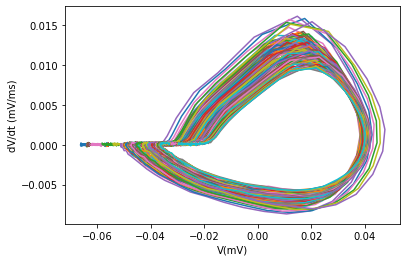

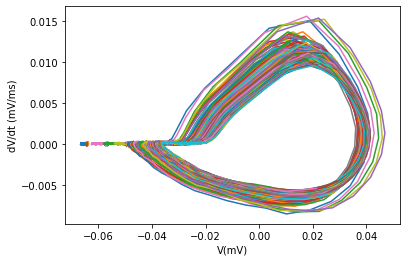

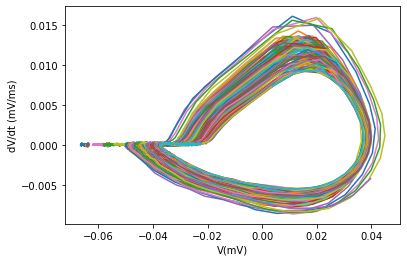

In [ ]:
#@title
data = loadmat(path+'171010_NC_126_CC.mat')

data1 = loadmat_('C:/Users/Nishant Joshi/'+'analyzed_CC_171010_NC_126_CC.mat')
for j in range(10):
  onset = data1['out']['exp']['current']['onset']['ind'][0]
  offset = data1['out']['exp']['current']['offset']['ind'][0]
  index = data1['out']['exp']['AP']['latency']['all'][13]
  v = data['Trace_1_1_'+str(j+1)+'_2'][onset:offset,1]#[index]

  for i in range(len(index)):
    plt.plot(v[index[i]-99:index[i]+100],np.diff(v[index[i]-100:index[i]+100]))
plt.xlabel('V(mV)')
plt.ylabel('dV/dt (mV/ms)')
plt.show()
for j in range(10):
  onset = data1['out']['exp']['current']['onset']['ind'][0]
  offset = data1['out']['exp']['current']['offset']['ind'][0]
  index = data1['out']['exp']['AP']['latency']['all'][13]
  v = data['Trace_1_2_'+str(j+1)+'_2'][onset:offset,1]#[index]

  for i in range(len(index)):
    plt.plot(v[index[i]-99:index[i]+100],np.diff(v[index[i]-100:index[i]+100]))
plt.xlabel('V(mV)')
plt.ylabel('dV/dt (mV/ms)')
plt.show()
for j in range(10):
  onset = data1['out']['exp']['current']['onset']['ind'][0]
  offset = data1['out']['exp']['current']['offset']['ind'][0]
  index = data1['out']['exp']['AP']['latency']['all'][13]
  v = data['Trace_1_3_'+str(j+1)+'_2'][onset:offset,1]#[index]

  for i in range(len(index)):
    plt.plot(v[index[i]-99:index[i]+100],np.diff(v[index[i]-100:index[i]+100]))
plt.xlabel('V(mV)')
plt.ylabel('dV/dt (mV/ms)')
plt.show()

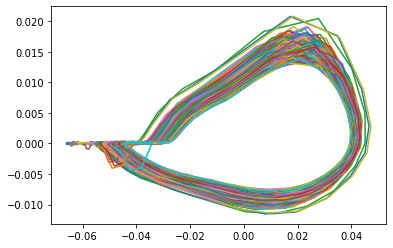

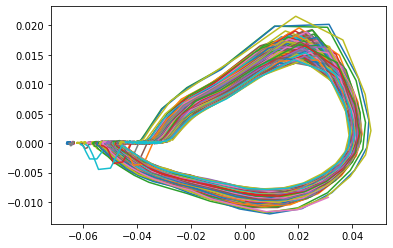

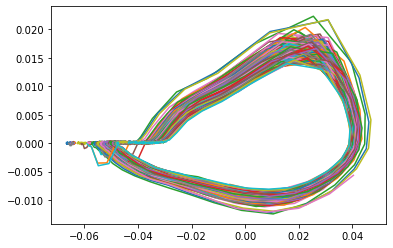

In [ ]:
#@title
data = loadmat(path+'171010_NC_128_CC.mat')

data1 = loadmat_(path2+'analyzed_CC_171010_NC_128_CC.mat')
for j in range(10):
  onset = data1['out']['exp']['current']['onset']['ind'][0]
  offset = data1['out']['exp']['current']['offset']['ind'][0]
  index = data1['out']['exp']['AP']['latency']['all'][13]
  v = data['Trace_2_6_'+str(j+1)+'_2'][onset:offset,1]#[index]

  for i in range(len(index)):
    plt.plot(v[index[i]-99:index[i]+100],np.diff(v[index[i]-100:index[i]+100]))
plt.show()
for j in range(10):
  onset = data1['out']['exp']['current']['onset']['ind'][0]
  offset = data1['out']['exp']['current']['offset']['ind'][0]
  index = data1['out']['exp']['AP']['latency']['all'][13]
  v = data['Trace_2_7_'+str(j+1)+'_2'][onset:offset,1]#[index]

  for i in range(len(index)):
    plt.plot(v[index[i]-99:index[i]+100],np.diff(v[index[i]-100:index[i]+100]))
plt.show()
for j in range(10):
  onset = data1['out']['exp']['current']['onset']['ind'][0]
  offset = data1['out']['exp']['current']['offset']['ind'][0]
  index = data1['out']['exp']['AP']['latency']['all'][13]
  v = data['Trace_2_8_'+str(j+1)+'_2'][onset:offset,1]#[index]

  for i in range(len(index)):
    plt.plot(v[index[i]-99:index[i]+100],np.diff(v[index[i]-100:index[i]+100]))
plt.show()

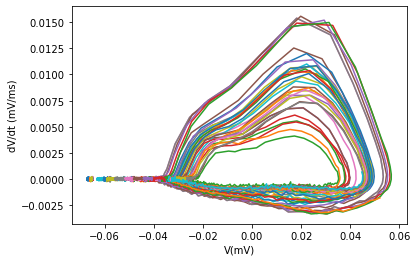

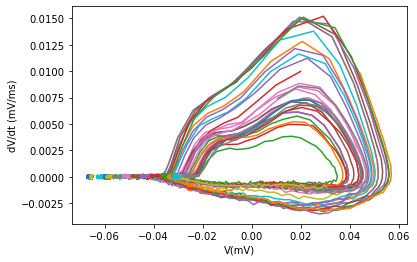

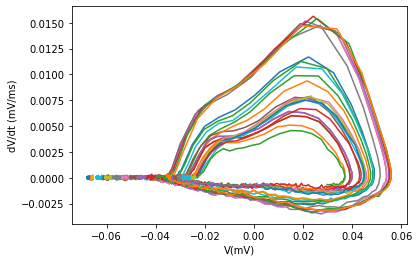

In [ ]:
#@title
path = 'C:/Users/Nishant Joshi/Downloads/Current clamp/CC - Excitatory/Raw CC/'
path2 = 'C:/Users/Nishant Joshi/'
data = loadmat(path+'171010_NC_129_CC.mat')

data1 = loadmat_(path2+'analyzed_CC_171010_NC_129_CC.mat')
for j in range(10):
  onset = data1['out']['exp']['current']['onset']['ind'][0]
  offset = data1['out']['exp']['current']['offset']['ind'][0]
  index = data1['out']['exp']['AP']['latency']['all'][13]
  v = data['Trace_3_1_'+str(j+1)+'_2'][onset:offset,1]#[index]

  for i in range(len(index)):
    plt.plot(v[index[i]-199:index[i]+200],np.diff(v[index[i]-200:index[i]+200]))
plt.xlabel('V(mV)')
plt.ylabel('dV/dt (mV/ms)')
plt.show()
for j in range(10):
  onset = data1['out']['exp']['current']['onset']['ind'][0]
  offset = data1['out']['exp']['current']['offset']['ind'][0]
  index = data1['out']['exp']['AP']['latency']['all'][13]
  v = data['Trace_3_2_'+str(j+1)+'_2'][onset:offset,1]#[index]

  for i in range(len(index)):
    plt.plot(v[index[i]-199:index[i]+200],np.diff(v[index[i]-200:index[i]+200]))
plt.xlabel('V(mV)')
plt.ylabel('dV/dt (mV/ms)')
plt.show()
for j in range(10):
  onset = data1['out']['exp']['current']['onset']['ind'][0]
  offset = data1['out']['exp']['current']['offset']['ind'][0]
  index = data1['out']['exp']['AP']['latency']['all'][13]
  v = data['Trace_3_3_'+str(j+1)+'_2'][onset:offset,1]#[index]

  for i in range(len(index)):
    plt.plot(v[index[i]-199:index[i]+200],np.diff(v[index[i]-200:index[i]+200]))
plt.xlabel('V(mV)')
plt.ylabel('dV/dt (mV/ms)')
plt.show()
# data

In [ ]:


path = 'C:/Users/Nishant Joshi/Google Drive/Analyzed/'
listdir = acsf# os.listdir(path)
for i in range(1):

  data = loadmat_('C:/Users/Nishant Joshi/Google Drive/Analyzed/'+listdir[i])
  print(data[0]['input_generation_settings']['experimentname'])

asli_28-6-19_E2


In [ ]:
data[0]['thresholds']

In [ ]:
!pip install imagesc

In [ ]:
#@title

thresholds_exc1 = []
isi_exc1 = []
FI_exc1 = []
FR_exc1 = []


thresholds_exc2 = []  
isi_exc2 = []
FI_exc2 = []
FR_exc2 = []



thresholds_inh1 = []
isi_inh1 = []
FI_inh1 = []
FR_inh1 = []


thresholds_inh2 = []
isi_inh2 = []
FI_inh2 = []
FR_inh2 = []


path = 'C:/Users/Nishant Joshi/Google Drive/Analyzed/'
listdir = acsf# os.listdir(path)
for i in range(len(listdir)):

  data = loadmat_('C:/Users/Nishant Joshi/Google Drive/Analyzed/'+listdir[i])
  print(data[0]['input_generation_settings']['experimentname'])
  if data[0]['input_generation_settings']['tau'] ==250:
    for j in data:
        


        if j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==1:
            


            thresholds_exc1.append(j['thresholds'][1:])
            isi = np.diff(j['spikeindices'])
            isi_exc1.append(isi)
            for m in j['Analysis']:
              FI_exc1.append(m['FI'])
            for n in j['firing_rate']:
              FR_exc1.append(n)

        elif j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==2:

            thresholds_exc2.append(j['thresholds'][1:])
            isi = np.diff(j['spikeindices'])
            isi_exc2.append(isi)
            for m in j['Analysis']:
              FI_exc2.append(m['FI'])
            for n in j['firing_rate']:
              FR_exc2.append(n)


  if data[0]['input_generation_settings']['tau'] == 50:
    for j in data:
        if j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==1:
           
          thresholds_inh1.append(j['thresholds'][1:])
          isi = np.diff(j['spikeindices'])
          isi_inh1.append(isi)
          for m in j['Analysis']:
            FI_inh1.append(m['FI'])
          for n in j['firing_rate']:
            FR_inh1.append(n)
        elif j['input_generation_settings']['condition'].lower() == 'acsf' and j['input_generation_settings']['trialnr'] ==2:

          thresholds_inh2.append(j['thresholds'][1:])
          isi = np.diff(j['spikeindices'])
          isi_inh2.append(isi)
          for m in j['Analysis']:
            FI_inh2.append(m['FI'])
          for n in j['firing_rate']:
            FR_inh2.append(n)



asli_28-6-19_E2
NC_170630_aCSF_D1ago_E4
NC_170703_aCSF_D1ago_E1
NC_170711_aCSF_D1ago_E1
NC_170816_aCSF_D1ago_E3
NC_170821_aCSF_D1ago_E1
NC_170821_aCSF_D1ago_E2
NC_170821_aCSF_D1ago_E3
NC_170830_aCSF_D1ago_E1
NC_170830_aCSF_D1ago_E3
NC_170830_aCSF_D1ago_E4
NC_170913_aCSF_D1ago_E2
NC_170914_aCSF_D1ago_E1
NC_171006_aCSF_D1ago_E7
NC_171010_aCSF_D1ago_E1
NC_171010_aCSF_D1ago_E2
NC_171010_aCSF_D1ago_E3
NC_171010_aCSF_D1ago_E4
NC_171010_aCSF_D1ago_E5
NC_171010_aCSF_D1ago_E6
NC_171011_aCSF_D1ago_E1


TypeError: ignored

In [ ]:
acsf_dict = {'trial'1:{'exc':{'threshold':,'ISI':,'FI'},'inh':{}}}

In [ ]:
#@title
def plot_heat(isi_exc1,thresholds_exc1,ax):
  a = [] 
  for i in isi_exc1:
    a = np.concatenate((a,i))
  b = [] 
  for i in thresholds_exc1:
    b = np.concatenate((b,i[1:]))
  # inda = ~np.isnan(a)
  indb = ~np.isnan(b)
  b_ = b[indb]
  a_ = a[indb]
  temp = np.zeros((np.size(a_),2))
  temp[:,0] = a_
  temp[:,1] = b_

  h= ax.hist2d(a_.T,b_.T,bins=[np.arange(1000),np.arange(-80,-20)],cmap='coolwarm')#,bins=[np.arange(0,50000),np.arange(-80,-20)])
  ax.imshow(h[0]/sum(h[0]),extent=[h[1][0],h[1][-1],h[2][0],h[2][-1]],aspect='auto')


In [ ]:
for i,j in zip(np.array(isi_exc1),np.array(thresholds_exc1)):
  print(i.shape,j.shape)

(26,) (27,)
(671,) (672,)
(301,) (302,)
(130,) (131,)
(2719,) (2720,)
(583,) (584,)
(1302,) (1303,)
(1613,) (1614,)
(828,) (829,)
(1176,) (1177,)
(313,) (314,)
(44,) (45,)
(402,) (403,)
(350,) (351,)
(930,) (931,)
(202,) (203,)
(461,) (462,)
(264,) (265,)
(486,) (487,)
(83,) (84,)
(87,) (88,)
(89,) (90,)
(197,) (198,)
(201,) (202,)
(99,) (100,)
(19,) (20,)
(174,) (175,)
(255,) (256,)
(179,) (180,)
(125,) (126,)
(4139,) (4140,)
(3440,) (3441,)
(2406,) (2407,)
(360,) (361,)
(2058,) (2059,)
(83,) (84,)
(270,) (271,)
(1413,) (1414,)
(360,) (361,)
(389,) (390,)
(415,) (416,)
(110,) (111,)
(94,) (95,)
(830,) (831,)
(495,) (496,)
(357,) (358,)
(1096,) (1097,)
(280,) (281,)
(1975,) (1976,)
(444,) (445,)
(459,) (460,)
(104,) (105,)
(138,) (139,)
(334,) (335,)
(160,) (161,)
(398,) (399,)
(141,) (142,)
(74,) (75,)
(355,) (356,)
(281,) (282,)
(174,) (175,)
(667,) (668,)
(510,) (511,)
(153,) (154,)
(169,) (170,)
(1225,) (1226,)
(2558,) (2559,)
(565,) (566,)
(111,) (112,)
(201,) (202,)
(315,) (316,)

<ipython-input-49-8ac09bd67c64>:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


<ipython-input-48-115f96c089c3>:18: RuntimeWarning: invalid value encountered in true_divide


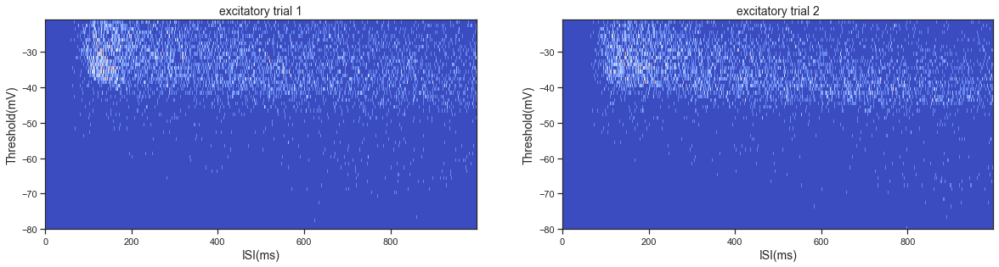

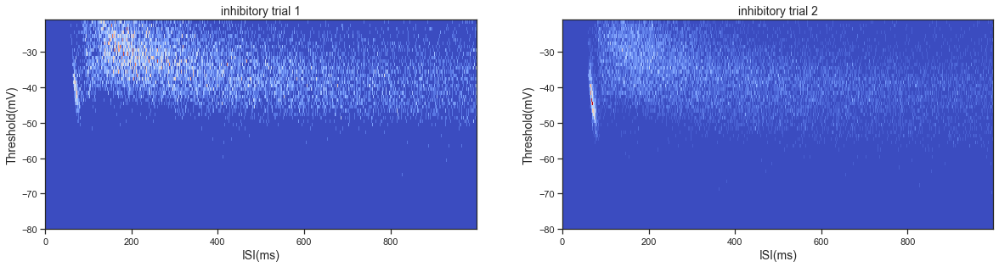

In [ ]:
#@title
plt.figure(figsize=[20,10])
ax1 = plt.subplot(2,2,1)
plot_heat(isi_exc1,thresholds_exc1,ax1)
ax1.set_xlabel('ISI(ms)',fontsize = 14)
ax1.set_ylabel('Threshold(mV)',fontsize = 14)
plt.title('excitatory trial 1',fontsize = 14)
ax2 = plt.subplot(2,2,2)
plot_heat(isi_exc2,thresholds_exc2,ax2)
ax2.set_xlabel('ISI(ms)',fontsize = 14)
ax2.set_ylabel('Threshold(mV)',fontsize = 14)
plt.title('excitatory trial 2',fontsize = 14)
plt.show()
plt.figure(figsize=[20,10])
ax3 = plt.subplot(2,2,3)
plot_heat(isi_inh1,thresholds_inh1,ax3)
ax3.set_xlabel('ISI(ms)',fontsize = 14)
ax3.set_ylabel('Threshold(mV)',fontsize = 14)
plt.title('inhibitory trial 1',fontsize = 14)
ax4 = plt.subplot(2,2,4)
plot_heat(isi_inh2,thresholds_inh2,ax4)
ax4.set_xlabel('ISI(ms)',fontsize = 14)
ax4.set_ylabel('Threshold(mV)',fontsize = 14)
plt.title('inhibitory trial 2',fontsize = 14)
plt.show()

In [ ]:
#@title
#dist plot 
# files = os.listdir(path)
def join_cond(lis_cond = None):
  path = 'C:/Users/Nishant Joshi/Downloads/all_files.csv'
  a = pd.read_csv(path)
  cond= np.sort(np.unique(a['condition']))
  temp = []
  if len(lis_cond)>1:
    for i in lis_cond:
      
      temp.append(a.groupby('condition').get_group(i))
    new_df = temp[0]
    for j in range(1,len(temp)):
      new_df = pd.concat([new_df,temp[j]])
  else:
    new_df = a.groupby('condition').get_group(lis_cond[0])
  return new_df

In [ ]:
path = 'C:/Users/Nishant Joshi/Downloads/all_files.csv'
a = pd.read_csv(path)
cond= np.sort(np.unique(a['condition']))
for i in cond:
  print(i)
  # if i.lower() ==cond_i.lower():

ACSF
AgoAnta
Cirazoline
D1
D1ago
D2
DOPA
DOPAMINE
Dop
M1-ag
M1-ago
M1-ago+ant
M1-ant
M1-ant+ago
aCSF
aCSF_BIC
sag


In [ ]:
join_cond(['D1','D1ago','D2','DOPA','DOPAMINE','Dop'])['experiment name'].unique()

In [ ]:
#@title
def plot_condition(thresholds_exc1,thresholds_exc2,thresholds_inh1,thresholds_inh2,isi_exc1,isi_exc2 ,isi_inh1,isi_inh2,cond_i):
  threshold_exc = []
  threshold_inh = [] 
  isi_exc = []
  isi_inh = []
  path = 'C:/Users/Nishant Joshi/Downloads/all_files.csv'
  a = pd.read_csv(path)
  cond= np.sort(np.unique(a['condition']))
  new_a = join_cond(lis_cond =cond_i)
  temp = []
  for u in cond_i:
    temp.append(u.lower())
  cond_i = temp
  def unfold(a):
    a_ = []
    for i in a:
      for j in i:
        a_.append(j)
    return a_
  def remove_nan(a):
    a_temp = ~np.isnan(np.array(a))
    a = np.array(a)[a_temp]
    return a

  path_i = 'C:/Users/Nishant Joshi/Google Drive/Analyzed/'
  for i in new_a['experimentname']:
    try:
      data = loadmat_(path_i+i+'_analyzed.mat')
    except:
      data = loadmat_(path_i+'Copy of '+i+'_analyzed.mat')
    for j in data:
      if j['input_generation_settings']['condition'].lower() in cond_i and j['input_generation_settings']['tau']==250:
        threshold_exc.append(j['thresholds'])
        isi_exc.append(np.diff(j['spikeindices']))
      if j['input_generation_settings']['condition'].lower() in cond_i and j['input_generation_settings']['tau']==50:
        threshold_inh.append(j['thresholds'])
        isi_inh.append(np.diff(j['spikeindices']))

  fig1,ax1 = plt.subplots(1,2,figsize=[16,8])
  # ax2 = plt.subplots(1,2,figsize=[16,8])

  plot_cdf(remove_nan(unfold(threshold_exc)),ax=ax1[0])
  plot_cdf(remove_nan(unfold(thresholds_exc1)),ax=ax1[0])
  plot_cdf(remove_nan(unfold(thresholds_exc2)),ax=ax1[0])
  ax1[0].set_ylabel('normalized count',fontsize=18)
  ax1[0].set_xlabel('Vth exc',fontsize=18)
  plt.legend([cond_i[0],'acsf T1','acsf T2'],fontsize=16)

  sns.distplot(remove_nan(unfold(threshold_exc)),ax=ax1[1])
  sns.distplot(remove_nan(unfold(thresholds_exc1)),ax=ax1[1])
  sns.distplot(remove_nan(unfold(thresholds_exc2)),ax=ax1[1])
  ax1[1].set_ylabel('normalized count',fontsize=18)
  ax1[1].set_xlabel('Vth exc',fontsize=18)
  plt.legend([cond_i[0],'acsf T1','acsf T2'],fontsize=16)

  plt.show()
  fig2,ax3 = plt.subplots(1,2,figsize=[16,8])
  # ax4 = plt.subplots(1,2,figsize=[16,8])

  plot_cdf(remove_nan(unfold(threshold_inh)),ax=ax3[0])
  plot_cdf(remove_nan(unfold(thresholds_inh1)),ax=ax3[0])
  plot_cdf(remove_nan(unfold(thresholds_inh2)),ax=ax3[0])
  ax3[0].set_ylabel('normalized count',fontsize=18)
  ax3[0].set_xlabel('Vth inh',fontsize=18)
  plt.legend([cond_i[0],'acsf T1','acsf T2'],fontsize=16)

  sns.distplot(remove_nan(unfold(threshold_inh)),ax=ax3[1])
  sns.distplot(remove_nan(unfold(thresholds_inh1)),ax=ax3[1])
  sns.distplot(remove_nan(unfold(thresholds_inh2)),ax=ax3[1])
  ax3[1].set_ylabel('normalized count',fontsize=18)
  ax3[1].set_xlabel('Vth inh',fontsize=18)
  plt.legend([cond_i[0],'acsf T1','acsf T2'],fontsize=16)

  plt.show()

  fig3,ax5 = plt.subplots(1,2,figsize=[16,8])
  # ax6 = plt.subplots(1,2,figsize=[16,8])
  plot_cdf(np.log(remove_nan(unfold(isi_exc))),ax=ax5[0])
  plot_cdf(np.log(remove_nan(unfold(isi_exc2))),ax=ax5[0])
  plot_cdf(np.log(remove_nan(unfold(isi_exc1))),ax=ax5[0])


  ax5[0].set_ylabel('normalized count',fontsize=18)
  ax5[0].set_xlabel('ISI exc',fontsize=18)
  plt.legend([cond_i,'acsf T1','acsf T2'],fontsize=16)
  sns.distplot(np.log(remove_nan(unfold(isi_exc))),ax=ax5[1])
  sns.distplot(np.log(remove_nan(unfold(isi_exc1))),ax=ax5[1])
  sns.distplot(np.log(remove_nan(unfold(isi_exc2))),ax=ax5[1])
  ax5[1].set_ylabel('normalized count',fontsize=18)
  ax5[1].set_xlabel('ISI exc',fontsize=18)

  plt.legend([cond_i[0],'acsf T1','acsf T2'],fontsize=16)
  plt.show()


  fig4, ax7 = plt.subplots(1,2,figsize=[16,8])
  # ax8 = plt.subplots(1,2,figsize=[16,8])
  plot_cdf(np.log(remove_nan(unfold(isi_inh))),ax=ax7[0])
  plot_cdf(np.log(remove_nan(unfold(isi_inh1))),ax=ax7[0])
  plot_cdf(np.log(remove_nan(unfold(isi_inh2))),ax=ax7[0])
  ax7[0].set_ylabel('normalized count',fontsize=18)
  ax7[0].set_xlabel('ISI inh',fontsize=18)
  plt.legend([cond_i[0],'acsf T1','acsf T2'],fontsize=16)


  sns.distplot(np.log(remove_nan(unfold(isi_inh))),ax=ax7[1])
  sns.distplot(np.log(remove_nan(unfold(isi_inh1))),ax=ax7[1])
  sns.distplot(np.log(remove_nan(unfold(isi_inh2))),ax=ax7[1])
  ax7[1].set_xlabel('ISI inh',fontsize=18)
  ax7[1].set_ylabel('normalized count',fontsize=18)
  plt.legend([cond_i[0],'acsf T1','acsf T2'],fontsize=16)
  plt.show()


#Distribution Plot Dopamine

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


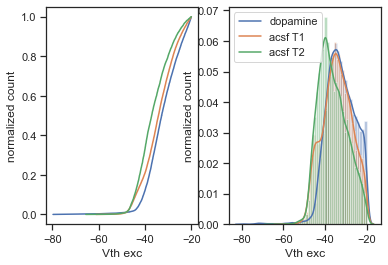

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


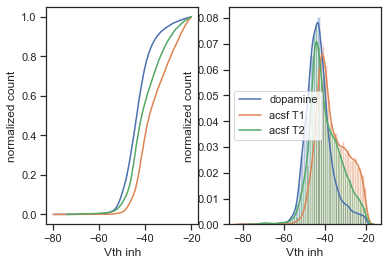

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


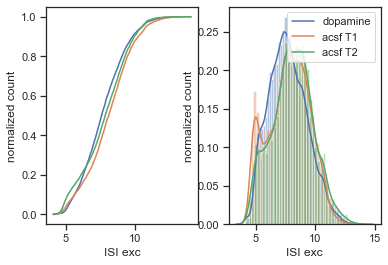

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


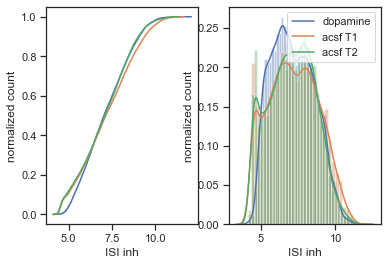

In [ ]:
plot_condition(thresholds_exc1,thresholds_exc2,thresholds_inh1,thresholds_inh2,isi_exc1,isi_exc2,isi_inh1,isi_inh2, cond_i=['DOPAMINE','Dop','DOPA'])

#Distribution Plot D1

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


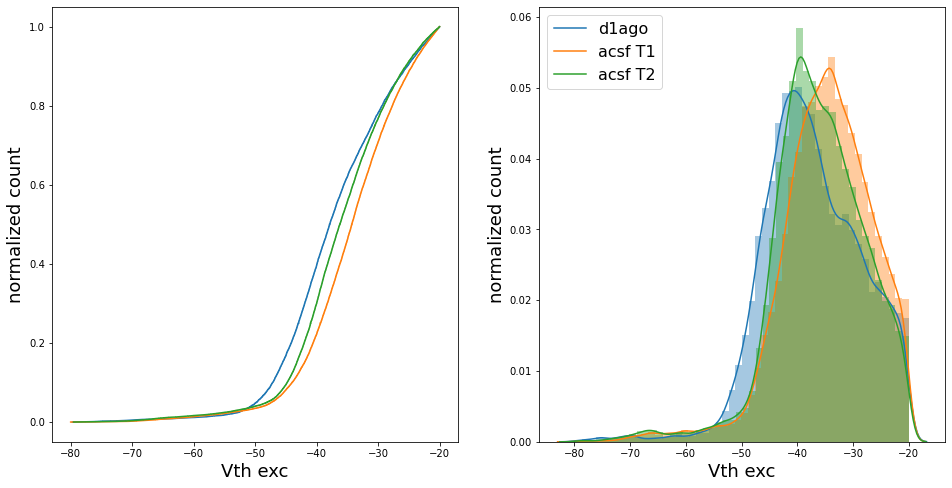

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


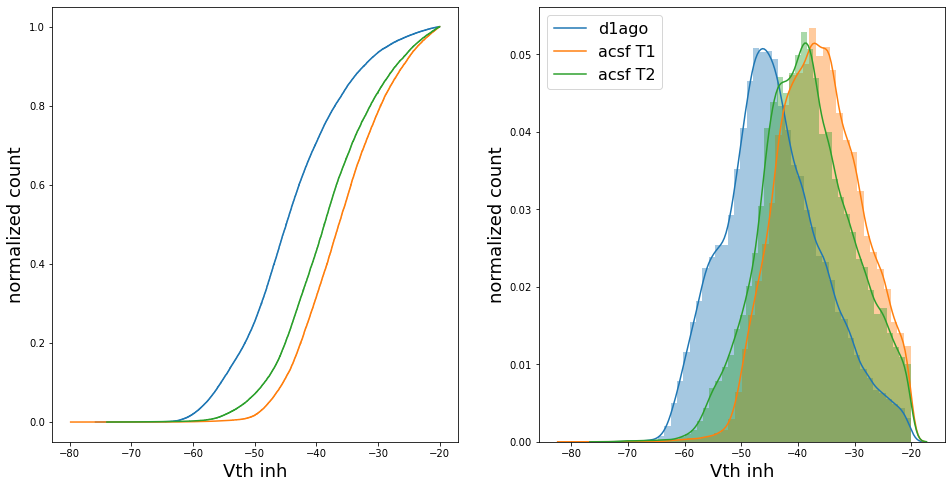

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


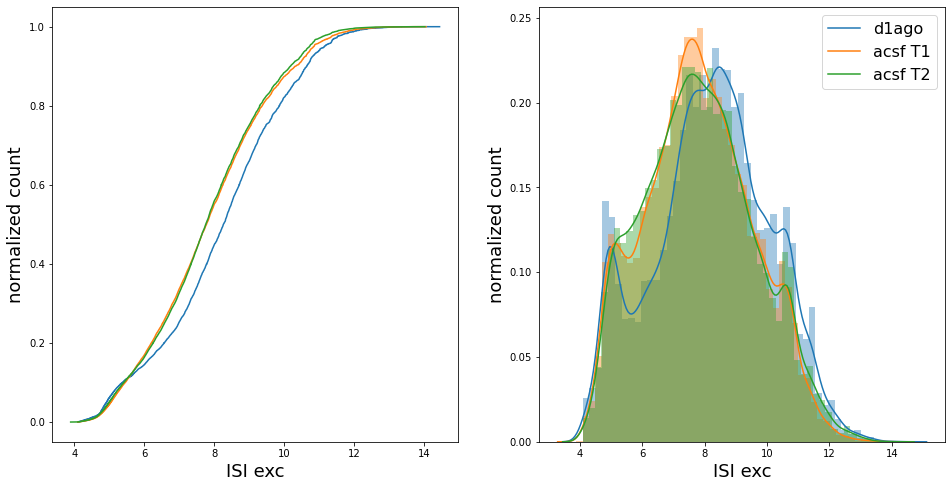

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


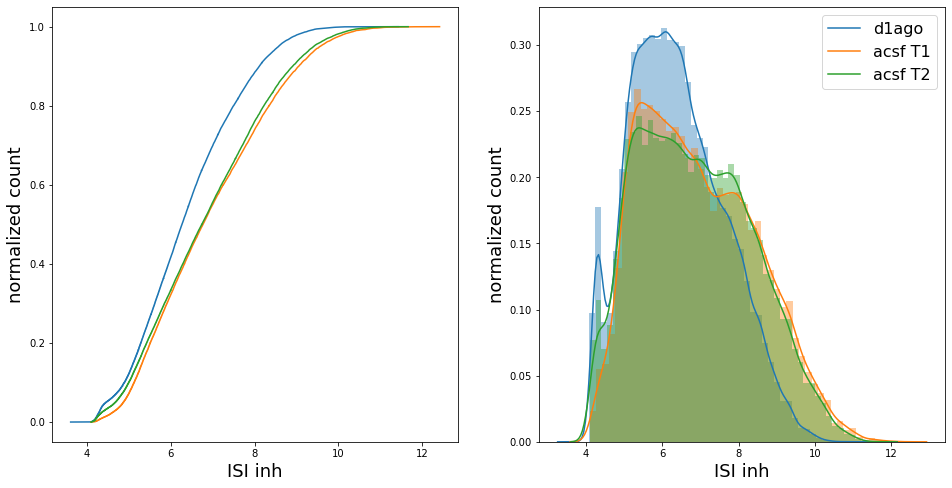

In [ ]:
plot_condition(thresholds_exc1,thresholds_exc2,thresholds_inh1,thresholds_inh2,isi_exc1,isi_exc2,isi_inh1,isi_inh2,cond_i=['D1ago'])

#Distribution plot D2

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


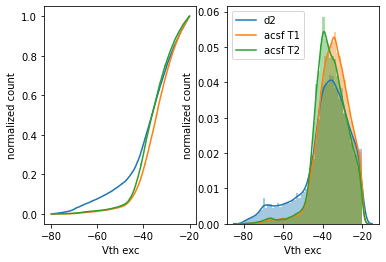

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


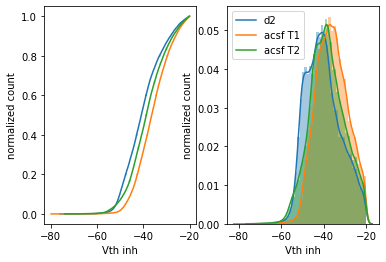

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


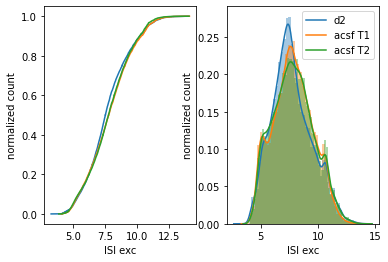

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


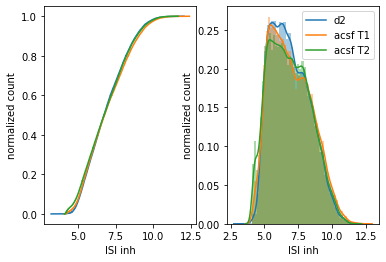

In [ ]:
#@title
plot_condition(thresholds_exc1,thresholds_exc2,thresholds_inh1,thresholds_inh2,isi_exc1,isi_exc2,isi_inh1,isi_inh2,cond_i=["D2"])

# Distribution plot Serotonin

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


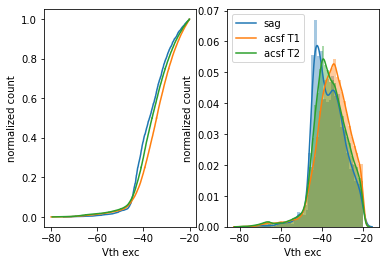

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


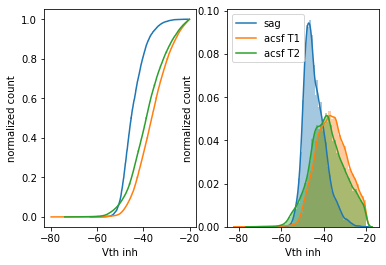

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


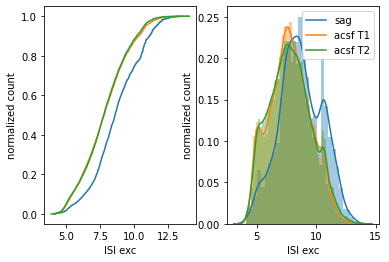

C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
C:\Users\Nishant Joshi\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).


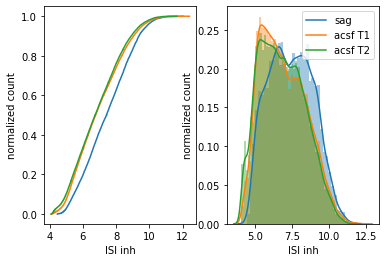

In [ ]:
plot_condition(thresholds_exc1,thresholds_exc2,thresholds_inh1,thresholds_inh2,isi_exc1,isi_exc2,isi_inh1,isi_inh2,cond_i=["sag"])

In [ ]:
import matlab.engine 
cond_ = ['D1ago']
dop = join_cond(['D1ago'])#,'DOPA','DOPAMINE','Dop'
exps = list( dop['filename'])
trials = list(dop['trialnr'])

path = 'C:/Users/Nishant Joshi/Google Drive/Analyzed/'

data = loadmat_(path+exps[0])


In [ ]:
eng = matlab.engine.start_matlab()


In [ ]:
I_mat = []
for i in I:
  I_mat.append(float(i))


In [ ]:
I = eng.double(I_mat)
# tf = eng.spectrogram(I,1000)
